In [34]:
from common_code.common import *
from common_code.plotting import *
from Trainers.DatasetQA import *
import numpy as np
import os
import sys
import matplotlib.pyplot as plt
from random import shuffle

In [35]:
dataset = 'babi_1'
base = './experiments/GLUE/'
if dataset not in os.listdir(base):
    os.mkdir(base+dataset)

base_dir1 = base+'new_'+dataset+'_diversity_lstm_tanh/'+dataset+'/diversity_lstm+tanh__diversity_weight_0.0'
base_dir2 = base+'new_'+dataset+'_ortho_lstm_tanh/'+dataset+'/ortho_lstm+tanh'
base_dir3 = base+'new_'+dataset+'_diversity_lstm_tanh/'+dataset+'/diversity_lstm+tanh__diversity_weight_0.5'
       
path_to_png = base + dataset +'/attn_pngs_{}/'.format(dataset)
path_to_csv = base + dataset +'/form_data_{}.tsv'.format(dataset)

if 'attn_pngs_{}'.format(dataset) not in os.listdir(base+dataset):
    os.mkdir(path_to_png)


In [36]:
dataset = datasets[dataset]()

def process_grads(grads, X) :
    for k in grads :
        if (k != "conicity") and (k != "X"):
            xxe = grads[k]
            for i in range(len(xxe)) :
                L = len(X[i])
                xxe[i] = np.abs(xxe[i])
                xxe[i] = xxe[i] / np.sum(xxe[i][1:L-1])

def get_outputs_old(base_dir):    
    dirname = get_latest_model(base_dir)
    outputs = pload1(dirname,'test_output')
    
#     outputs['cd_attn'] = pload1(dirname,'cd')
#     outputs['cd_matrix'] = pload1(dirname,'cd_matrix')
    pred = np.argmax(outputs['yt_hat'],axis=1).squeeze()
    yt_pred= np.zeros_like(prob)
    yt_pred[prob>0.5] = 1
    outputs['yt_pred'] = pred
    return outputs

def get_outputs(base_dir):    
    dirname = get_latest_model(base_dir)
    outputs = pload1(dirname,'test_output')
    grads = pload1(dirname,'gradients')
    process_grads(grads,outputs['P'])
    ydiff = pload1(dirname, 'remove_and_run')
    
    for i in range(len(ydiff)):
        L = len(outputs['P'][i])
        ydiff[i] = ydiff[i]/ np.sum(ydiff[i][1:L-1])
    
    outputs['grads'] = grads['XxE[X]']
    outputs['loo'] = ydiff
    return outputs

In [37]:
def print_attention(output1, output2, output3, plot=True, jsd_thresh=0.3, max=10, crop=True):

    fi = open(path_to_csv, 'w')
    count = 0
    
    for idx in range(len(output1['attn_hat'])):

        attn1 = output1['attn_hat'][idx]
        attn2 = output2['attn_hat'][idx]
        attn3 = output3['attn_hat'][idx]
        
        L = len(output1['P'][idx])
        js_divergence = jsd(attn1[1:L-1],attn3[1:L-1])

        if (js_divergence >= jsd_thresh):
            
            y_pred1 = output1['yt_hat'][idx]
            y_pred2 = output2['yt_hat'][idx]
            y_pred3 = output3['yt_hat'][idx]
            
            y = output2['y'][idx]

            sentence = dataset.vec.map2words(output1['P'][idx])  
            question = dataset.vec.map2words(output1['Q'][idx]) 
            answer = dataset.vec.idx2entity[output1['y'][idx]]
            
            l_q = len(question)
            question = " ".join(question[1:l_q-1])
            # answer = " ".join(question[1:len(answer)-1])

            L = len(sentence)
            
            if (y == y_pred1 and y== y_pred3):
            
                if( max != -1 and count == max):
                    break
                    
                count += 1
            
                if(plot):
                    # write to file

                    fi.write(str(answer)+'\t')
                    fi.write(question+'\n')

                    #plot figures
                    png_path = path_to_png + "example{}.png".format(count)
                    print(output1['P'][idx])
                    
                    print(question)
                    print(answer)

                    print_attn(sentence[1:L-1], attn1[1:L-1])
                    print_attn(sentence[1:L-1], attn3[1:L-1])

                    if(len(sentence[1:L-1]) <= 12):
                        kws = {"rotation": 0, "size": 10}
                    else:
                        kws = {"rotation": 45, "size": 15}

                    fig, ax = init_gridspec(10, 1, 2)
                    attn_matirx = np.array(attn1[1:L-1]).reshape(1,-1)
                    annotate = np.array(sentence[1:L-1]).reshape(1,-1)
                    ax[0].set_ylabel('')    
                    ax[0].set_xlabel('')

                    ax[0] = plot_attention(ax[0], attn_matirx, annotate, kws)

                    attn_matirx = np.array(attn3[1:L-1]).reshape(1,-1)
                    annotate = np.array(sentence[1:L-1]).reshape(1,-1)
                    ax[1] = plot_attention(ax[1], attn_matirx, annotate, kws)

                    show_gridspec()
                    fig.savefig(png_path)
                    
                    print ("-"*30)
                    sys.stdout.flush()
                    
                    
    if(plot and crop):
        #crop pngs to remove whitespace
        print("Cropping saved pngs")

        for l in os.listdir(path_to_png):
            if(l == '.DS_Store'):
                continue
            crop_img(path_to_png+l)

        print("Done cropping")
            
    return count

In [38]:
output1 = get_outputs(base_dir1)
output2 = get_outputs(base_dir1)
output3 = get_outputs(base_dir3)

[2, 6, 22, 21, 20, 14, 4, 7, 16, 21, 20, 11, 3]
Where is John
hallway


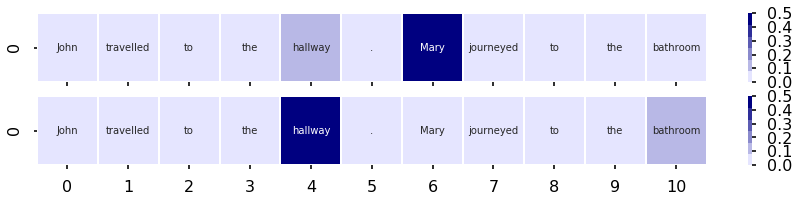

------------------------------
[2, 5, 16, 21, 20, 14, 4, 8, 23, 21, 20, 17, 3]
Where is Sandra
kitchen


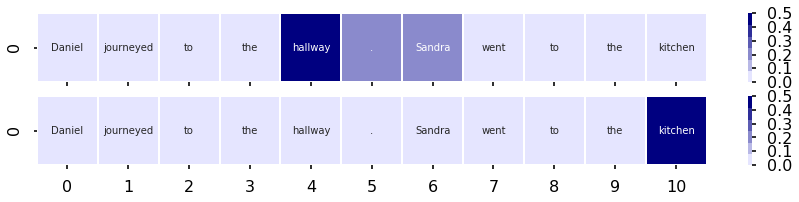

------------------------------
[2, 6, 16, 21, 20, 19, 4, 8, 22, 21, 20, 13, 3]
Where is John
office


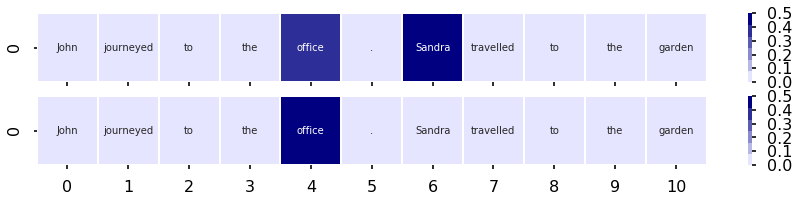

------------------------------
[2, 8, 22, 21, 20, 12, 4, 6, 22, 21, 20, 13, 3]
Where is Sandra
bedroom


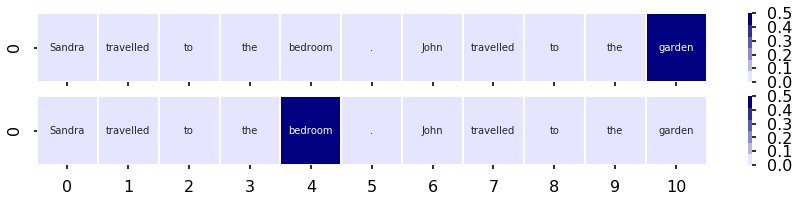

------------------------------
[2, 8, 23, 21, 20, 13, 4, 5, 23, 21, 20, 13, 3]
Where is Sandra
garden


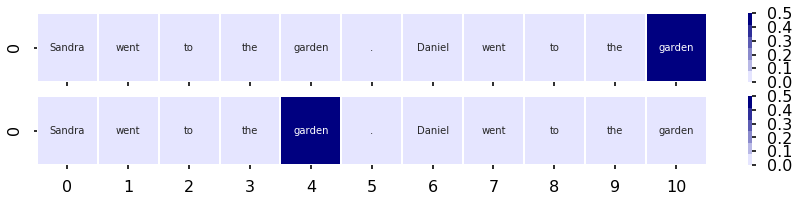

------------------------------
[2, 8, 22, 21, 20, 11, 4, 7, 16, 21, 20, 19, 3]
Where is Sandra
bathroom


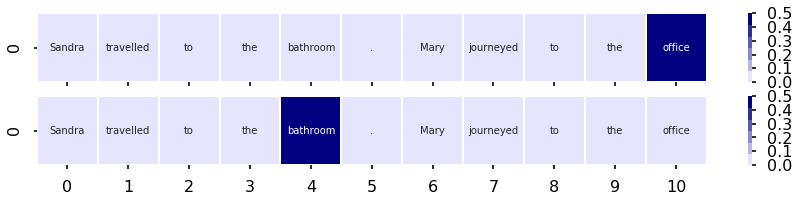

------------------------------
[2, 8, 16, 21, 20, 17, 4, 5, 16, 21, 20, 11, 3]
Where is Sandra
kitchen


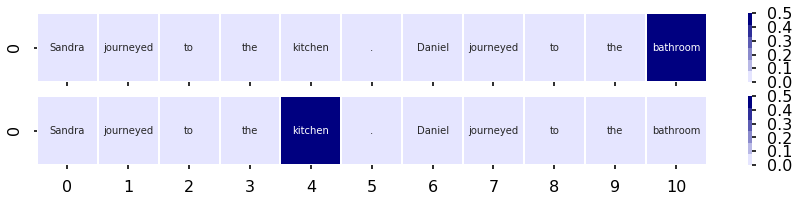

------------------------------
[2, 6, 22, 21, 20, 17, 4, 8, 18, 21, 20, 11, 3]
Where is John
kitchen


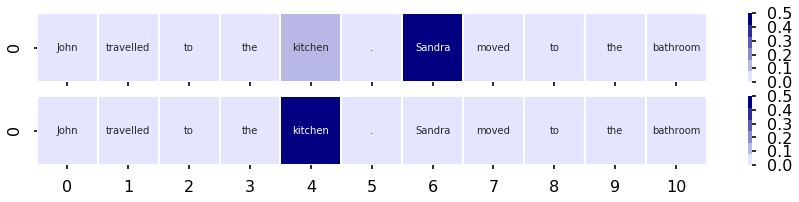

------------------------------
[2, 8, 18, 21, 20, 19, 4, 5, 18, 21, 20, 17, 3]
Where is Sandra
office


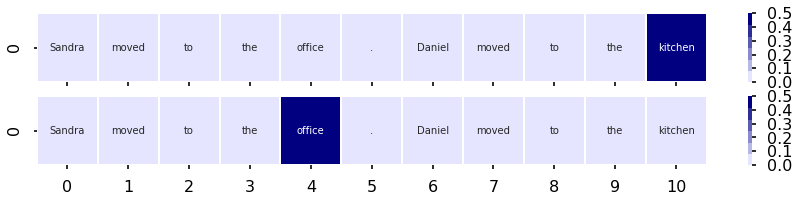

------------------------------
[2, 5, 23, 21, 20, 12, 4, 8, 23, 21, 20, 17, 3]
Where is Sandra
kitchen


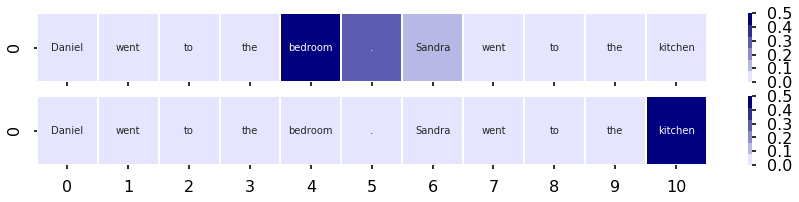

------------------------------
[2, 6, 18, 21, 20, 11, 4, 8, 18, 21, 20, 13, 3]
Where is John
bathroom


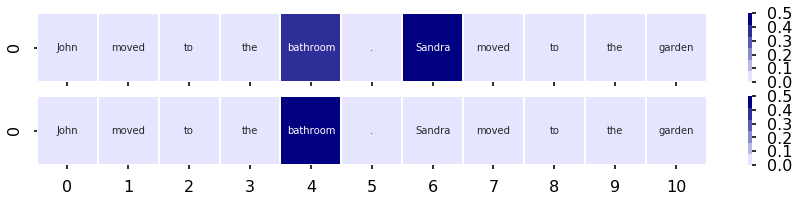

------------------------------
[2, 8, 16, 21, 20, 11, 4, 6, 18, 21, 20, 13, 3]
Where is Sandra
bathroom


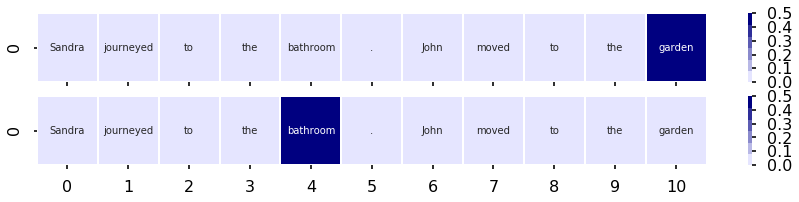

------------------------------
[2, 6, 16, 21, 20, 13, 4, 7, 22, 21, 20, 19, 3]
Where is John
garden


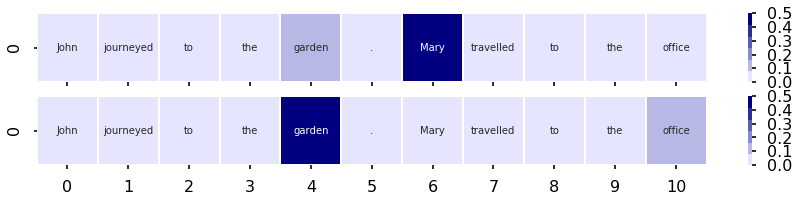

------------------------------
[2, 8, 23, 21, 20, 13, 4, 6, 22, 21, 20, 19, 3]
Where is Sandra
garden


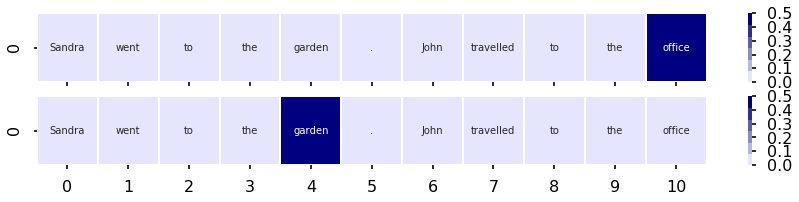

------------------------------
[2, 8, 23, 21, 20, 12, 4, 6, 22, 21, 20, 19, 3]
Where is Sandra
bedroom


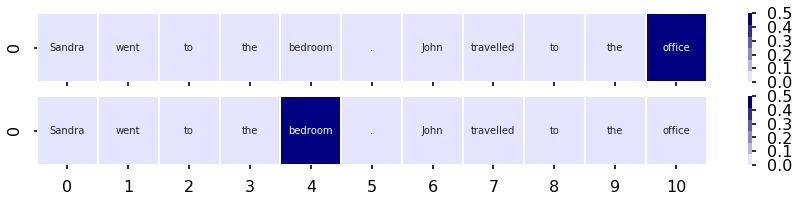

------------------------------
[2, 7, 23, 21, 20, 13, 4, 8, 16, 21, 20, 13, 3]
Where is Sandra
garden


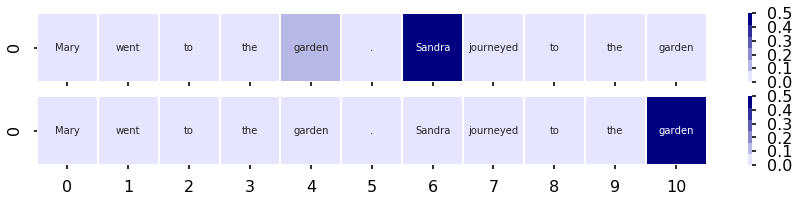

------------------------------
[2, 8, 22, 21, 20, 17, 4, 5, 22, 21, 20, 11, 3]
Where is Sandra
kitchen


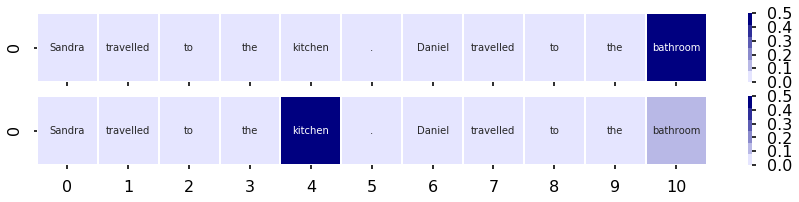

------------------------------
[2, 6, 22, 21, 20, 19, 4, 7, 23, 21, 20, 11, 3]
Where is John
office


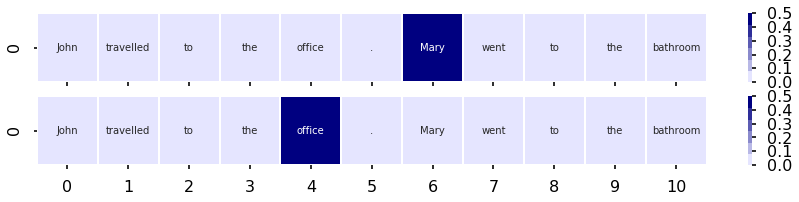

------------------------------
[2, 8, 23, 21, 20, 14, 4, 5, 18, 21, 20, 13, 3]
Where is Sandra
hallway


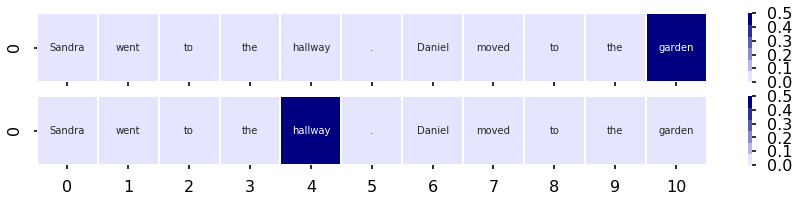

------------------------------
[2, 5, 16, 21, 20, 19, 4, 8, 23, 21, 20, 17, 3]
Where is Sandra
kitchen


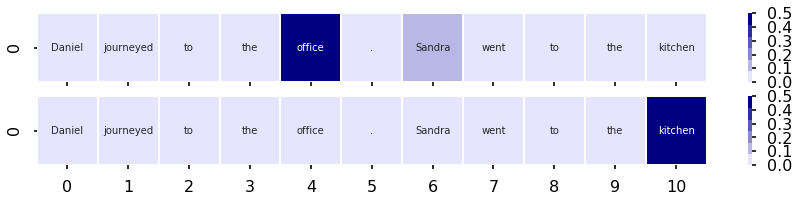

------------------------------
[2, 8, 16, 21, 20, 17, 4, 6, 18, 21, 20, 14, 3]
Where is Sandra
kitchen


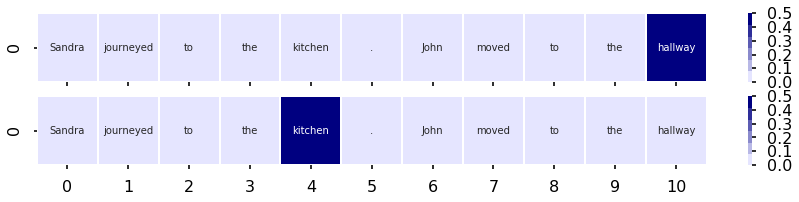

------------------------------
[2, 7, 18, 21, 20, 17, 4, 8, 22, 21, 20, 12, 3]
Where is Mary
kitchen


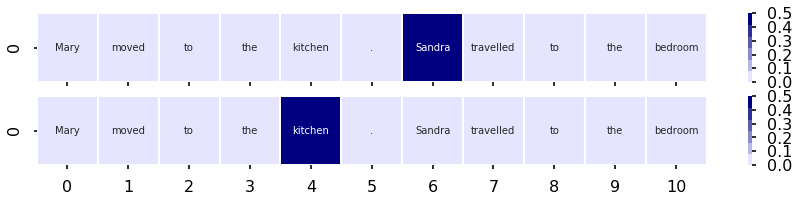

------------------------------
[2, 6, 22, 21, 20, 13, 4, 7, 16, 21, 20, 19, 3]
Where is John
garden


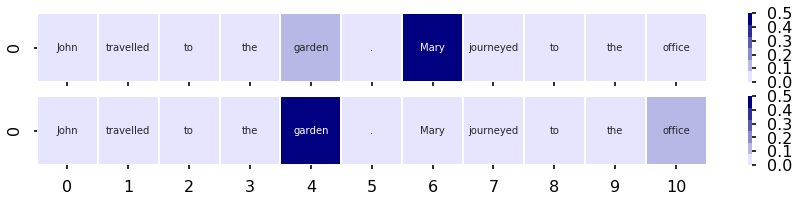

------------------------------
[2, 6, 22, 21, 20, 12, 4, 7, 22, 21, 20, 12, 3]
Where is John
bedroom


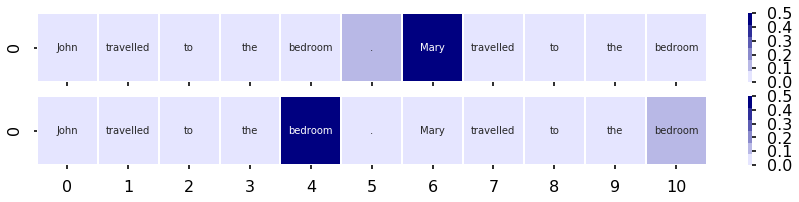

------------------------------
[2, 8, 22, 21, 20, 12, 4, 5, 23, 21, 20, 12, 3]
Where is Sandra
bedroom


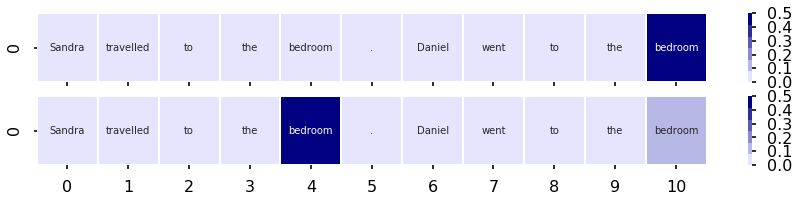

------------------------------
[2, 6, 23, 21, 20, 13, 4, 8, 22, 21, 20, 13, 3]
Where is John
garden


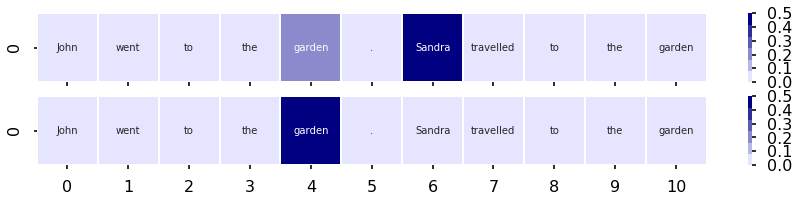

------------------------------
[2, 6, 22, 21, 20, 13, 4, 8, 22, 21, 20, 13, 3]
Where is Sandra
garden


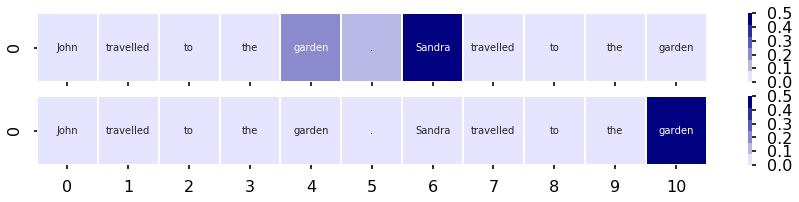

------------------------------
[2, 8, 22, 21, 20, 13, 4, 6, 22, 21, 20, 17, 3]
Where is Sandra
garden


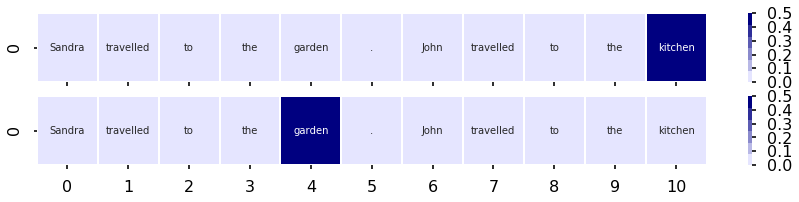

------------------------------
[2, 6, 22, 21, 20, 17, 4, 8, 18, 21, 20, 17, 3]
Where is John
kitchen


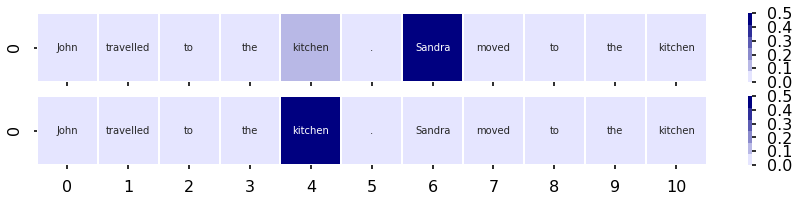

------------------------------
[2, 8, 18, 21, 20, 14, 4, 5, 23, 21, 20, 19, 3]
Where is Sandra
hallway


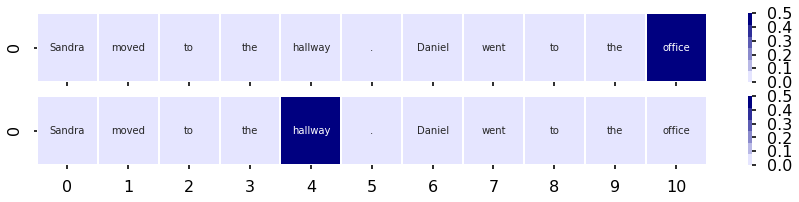

------------------------------
[2, 8, 23, 10, 21, 20, 12, 4, 7, 18, 21, 20, 17, 3]
Where is Sandra
bedroom


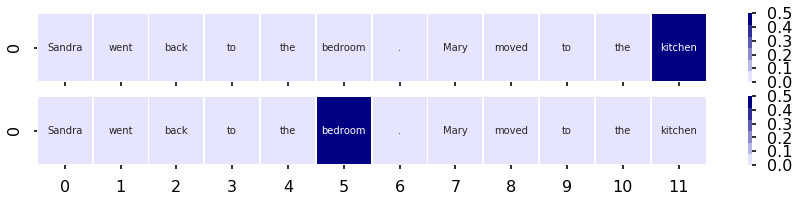

------------------------------
[2, 6, 23, 10, 21, 20, 12, 4, 8, 16, 21, 20, 11, 3]
Where is John
bedroom


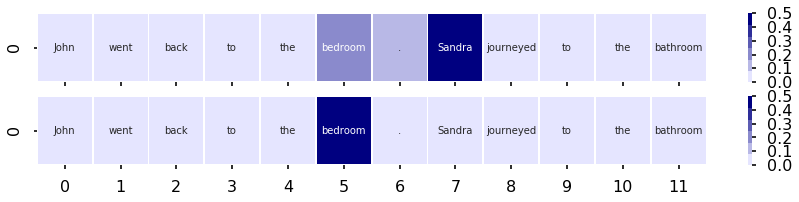

------------------------------
[2, 7, 23, 21, 20, 11, 4, 8, 23, 10, 21, 20, 11, 3]
Where is Sandra
bathroom


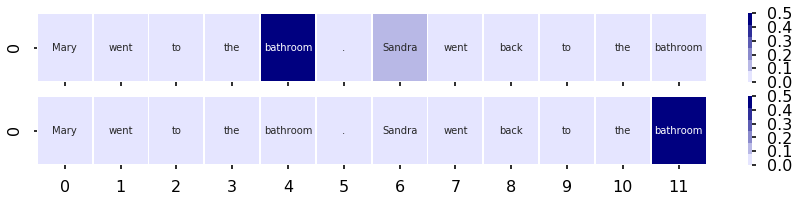

------------------------------
[2, 8, 23, 10, 21, 20, 19, 4, 6, 18, 21, 20, 11, 3]
Where is Sandra
office


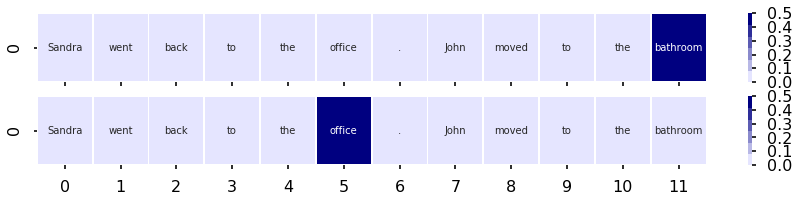

------------------------------
[2, 8, 23, 10, 21, 20, 14, 4, 6, 18, 21, 20, 14, 3]
Where is Sandra
hallway


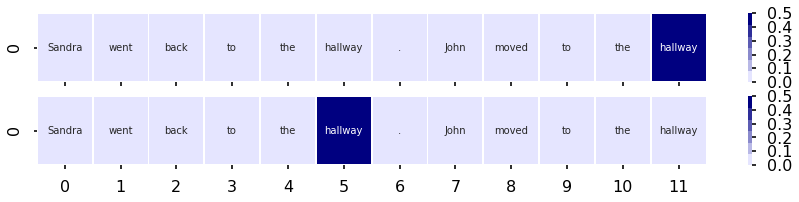

------------------------------
[2, 8, 18, 21, 20, 12, 4, 7, 23, 10, 21, 20, 17, 3]
Where is Sandra
bedroom


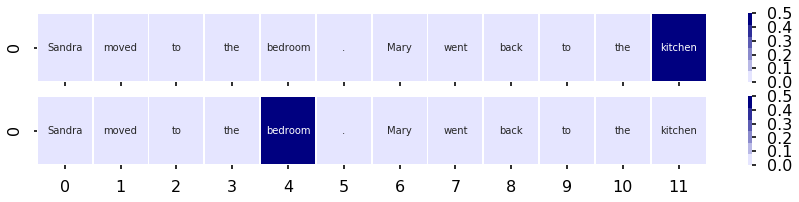

------------------------------
[2, 8, 23, 10, 21, 20, 12, 4, 6, 18, 21, 20, 13, 3]
Where is Sandra
bedroom


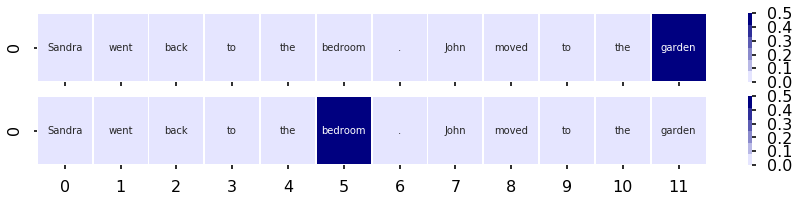

------------------------------
[2, 8, 23, 21, 20, 19, 4, 6, 23, 10, 21, 20, 11, 3]
Where is Sandra
office


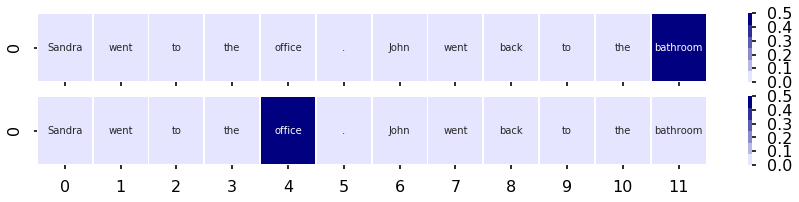

------------------------------
[2, 8, 22, 21, 20, 11, 4, 6, 23, 10, 21, 20, 19, 3]
Where is Sandra
bathroom


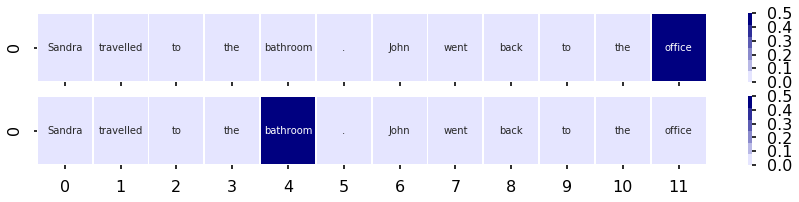

------------------------------
[2, 6, 23, 10, 21, 20, 12, 4, 5, 16, 21, 20, 14, 3]
Where is John
bedroom


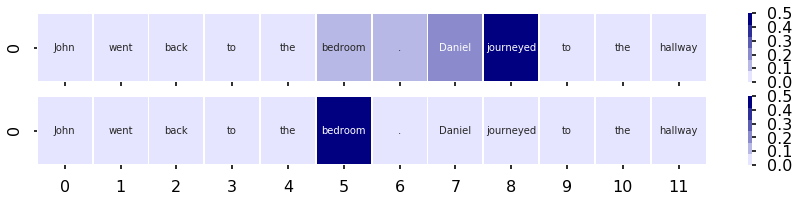

------------------------------
[2, 8, 23, 10, 21, 20, 13, 4, 6, 18, 21, 20, 19, 3]
Where is Sandra
garden


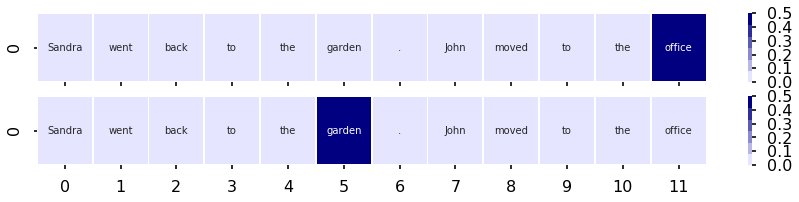

------------------------------
[2, 7, 23, 10, 21, 20, 17, 4, 5, 16, 21, 20, 14, 3]
Where is Mary
kitchen


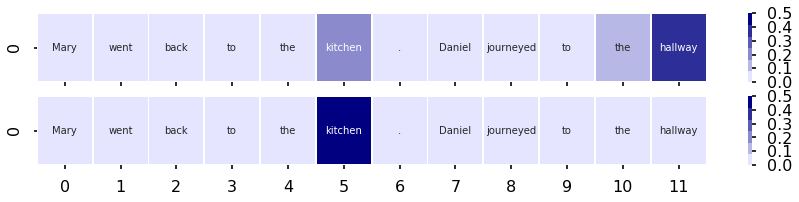

------------------------------
[2, 8, 23, 10, 21, 20, 14, 4, 7, 23, 10, 21, 20, 17, 3]
Where is Sandra
hallway


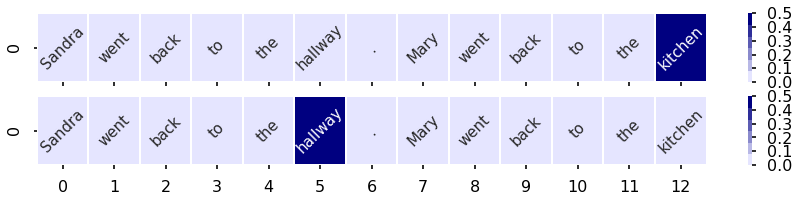

------------------------------
[2, 5, 16, 21, 20, 12, 4, 8, 16, 21, 20, 11, 4, 6, 23, 21, 20, 19, 4, 8, 18, 21, 20, 12, 3]
Where is John
office


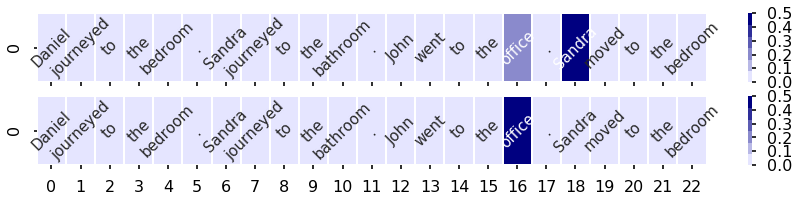

------------------------------
[2, 7, 22, 21, 20, 13, 4, 7, 18, 21, 20, 12, 4, 8, 23, 21, 20, 11, 4, 5, 22, 21, 20, 11, 3]
Where is Sandra
bathroom


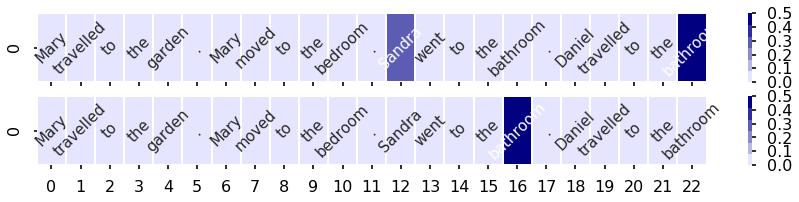

------------------------------
[2, 6, 18, 21, 20, 11, 4, 6, 22, 21, 20, 13, 4, 8, 22, 21, 20, 14, 4, 5, 18, 21, 20, 17, 3]
Where is John
garden


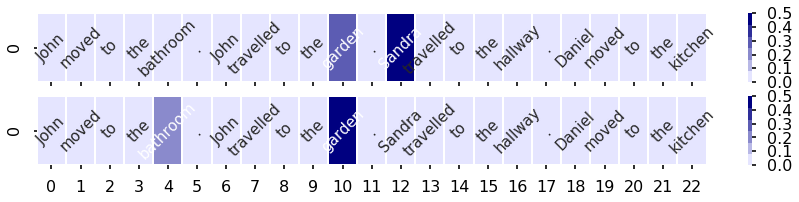

------------------------------
[2, 6, 23, 21, 20, 13, 4, 8, 22, 21, 20, 13, 4, 6, 22, 21, 20, 12, 4, 6, 22, 21, 20, 19, 3]
Where is Sandra
garden


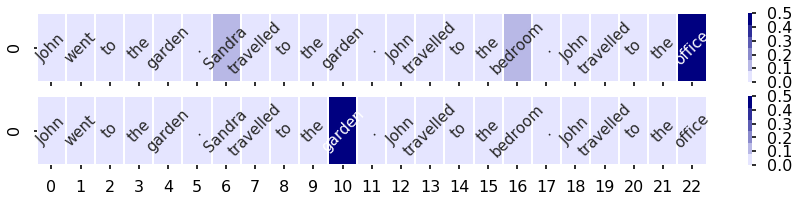

------------------------------
[2, 8, 16, 21, 20, 12, 4, 7, 16, 21, 20, 13, 4, 8, 18, 21, 20, 14, 4, 7, 22, 21, 20, 19, 3]
Where is Sandra
hallway


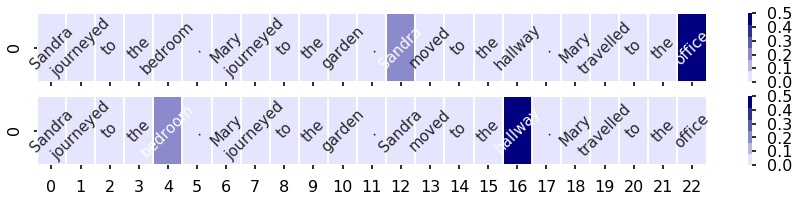

------------------------------
[2, 8, 16, 21, 20, 13, 4, 5, 16, 21, 20, 13, 4, 6, 16, 21, 20, 12, 4, 5, 16, 21, 20, 19, 3]
Where is Sandra
garden


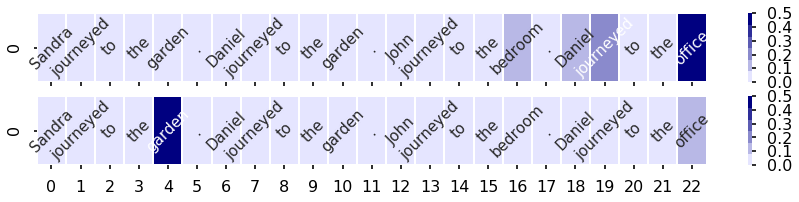

------------------------------
[2, 8, 22, 21, 20, 13, 4, 6, 22, 21, 20, 17, 4, 7, 23, 21, 20, 11, 4, 7, 22, 21, 20, 12, 3]
Where is Sandra
garden


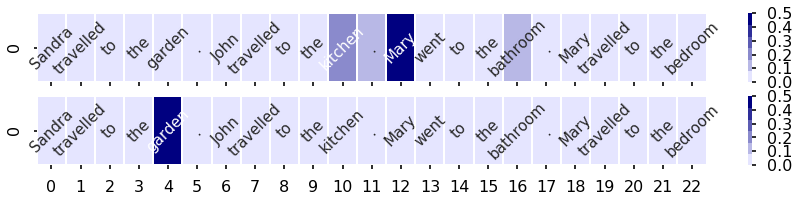

------------------------------
[2, 5, 23, 21, 20, 13, 4, 6, 22, 21, 20, 13, 4, 6, 22, 21, 20, 11, 4, 7, 23, 21, 20, 13, 3]
Where is John
bathroom


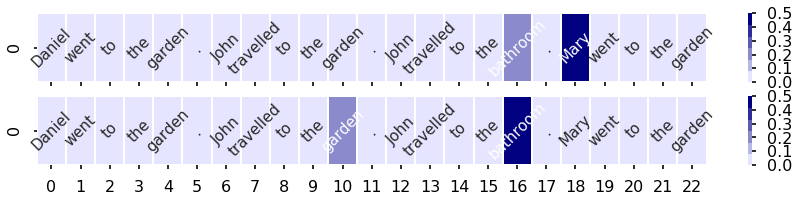

------------------------------
[2, 5, 18, 21, 20, 17, 4, 8, 22, 21, 20, 11, 4, 8, 22, 21, 20, 19, 4, 5, 16, 21, 20, 19, 3]
Where is Sandra
office


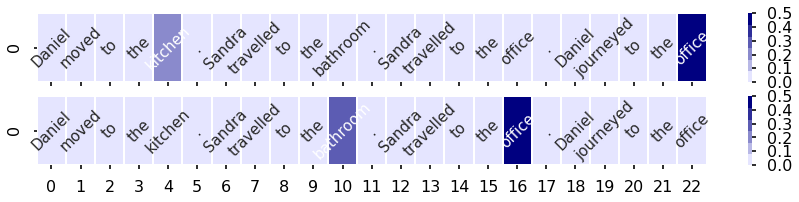

------------------------------
[2, 5, 22, 21, 20, 13, 4, 8, 16, 21, 20, 12, 4, 5, 16, 21, 20, 19, 4, 5, 22, 21, 20, 11, 3]
Where is Sandra
bedroom


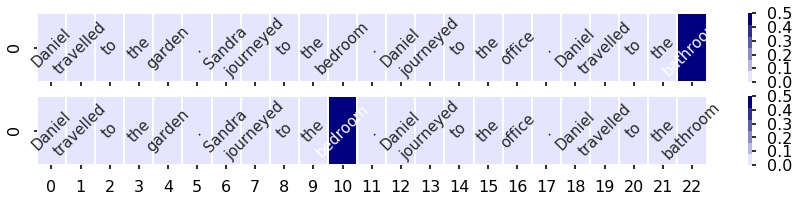

------------------------------
[2, 6, 16, 21, 20, 17, 4, 8, 18, 21, 20, 13, 4, 5, 22, 21, 20, 19, 4, 6, 18, 21, 20, 12, 3]
Where is Sandra
garden


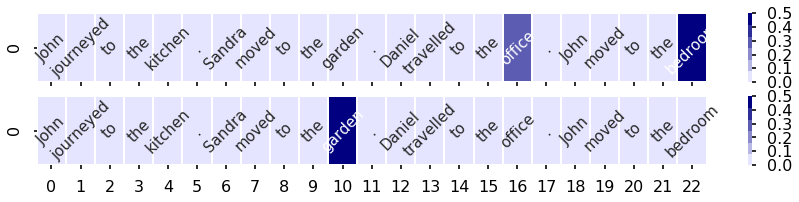

------------------------------
[2, 6, 22, 21, 20, 12, 4, 7, 23, 21, 20, 11, 4, 7, 16, 21, 20, 12, 4, 8, 22, 21, 20, 14, 3]
Where is John
bedroom


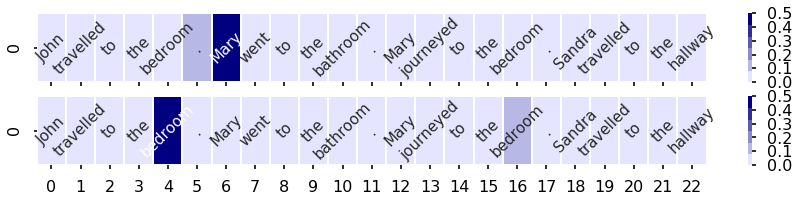

------------------------------
[2, 7, 18, 21, 20, 14, 4, 8, 22, 21, 20, 11, 4, 7, 22, 21, 20, 17, 4, 8, 23, 21, 20, 13, 3]
Where is Mary
kitchen


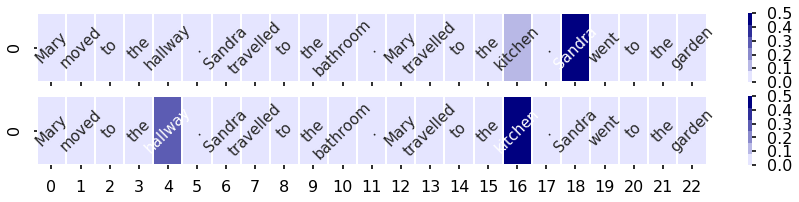

------------------------------
[2, 6, 22, 21, 20, 19, 4, 7, 23, 21, 20, 11, 4, 7, 23, 21, 20, 17, 4, 7, 16, 21, 20, 11, 3]
Where is John
office


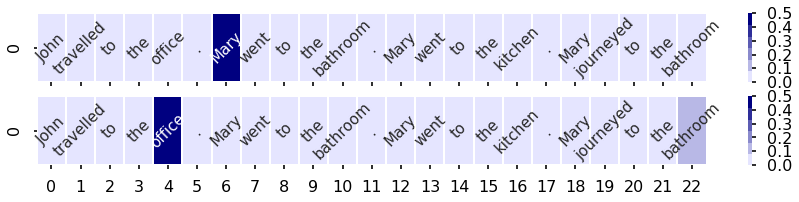

------------------------------
[2, 6, 22, 21, 20, 17, 4, 8, 18, 21, 20, 17, 4, 5, 23, 21, 20, 17, 4, 6, 16, 21, 20, 14, 3]
Where is Sandra
kitchen


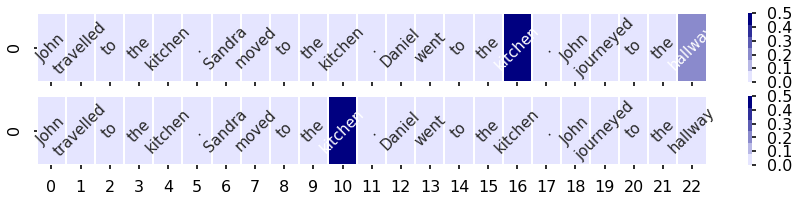

------------------------------
[2, 7, 18, 21, 20, 11, 4, 7, 16, 21, 20, 17, 4, 8, 16, 21, 20, 12, 4, 5, 22, 21, 20, 12, 3]
Where is Sandra
bedroom


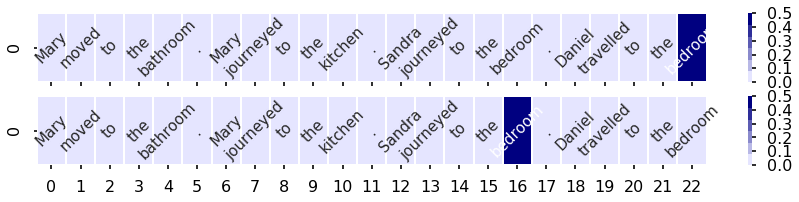

------------------------------
[2, 8, 22, 21, 20, 19, 4, 8, 18, 21, 20, 13, 4, 6, 16, 21, 20, 11, 4, 6, 18, 21, 20, 12, 3]
Where is Sandra
garden


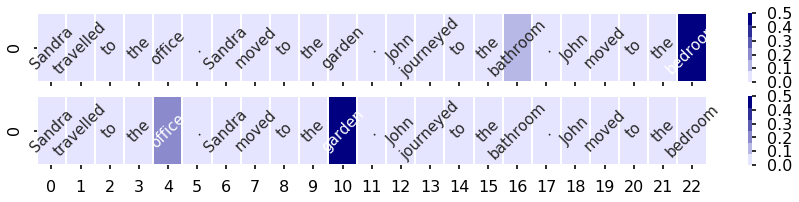

------------------------------
[2, 5, 23, 21, 20, 13, 4, 7, 18, 21, 20, 12, 4, 5, 16, 21, 20, 11, 4, 8, 16, 21, 20, 11, 3]
Where is Mary
bedroom


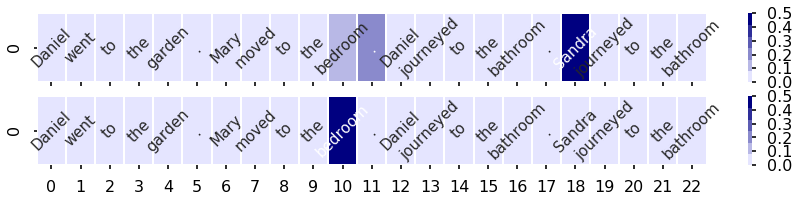

------------------------------
[2, 8, 22, 21, 20, 14, 4, 8, 23, 21, 20, 13, 4, 7, 18, 21, 20, 12, 4, 5, 23, 21, 20, 17, 3]
Where is Sandra
garden


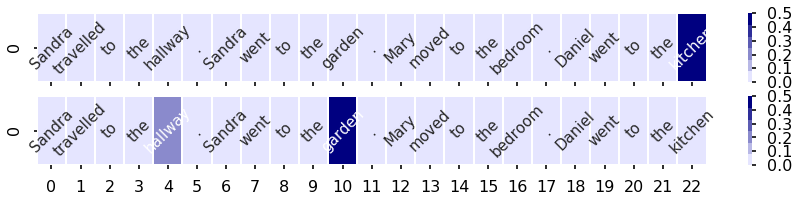

------------------------------
[2, 6, 22, 21, 20, 17, 4, 8, 18, 21, 20, 11, 4, 5, 18, 21, 20, 17, 4, 8, 18, 21, 20, 17, 3]
Where is John
kitchen


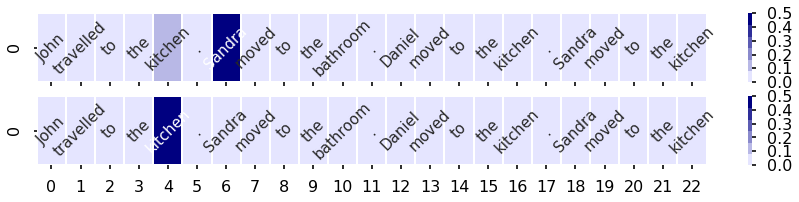

------------------------------
[2, 8, 18, 21, 20, 17, 4, 6, 22, 21, 20, 17, 4, 8, 18, 21, 20, 14, 4, 5, 16, 21, 20, 14, 3]
Where is Sandra
hallway


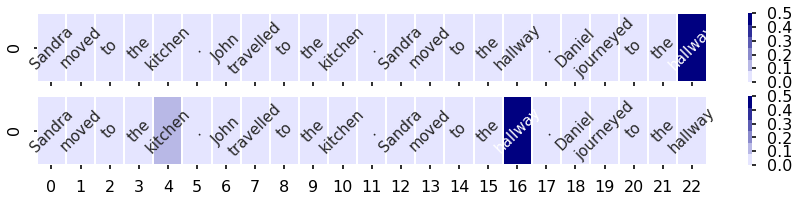

------------------------------
[2, 7, 23, 21, 20, 13, 4, 8, 16, 21, 20, 13, 4, 7, 16, 21, 20, 11, 4, 5, 23, 21, 20, 19, 3]
Where is Sandra
garden


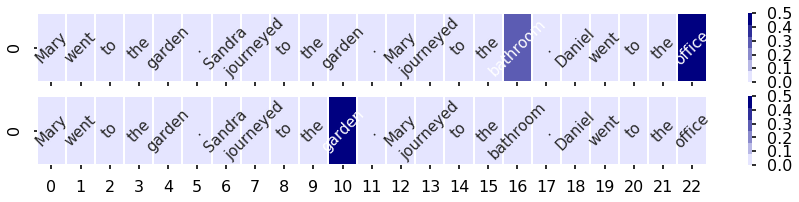

------------------------------
[2, 6, 22, 21, 20, 12, 4, 7, 22, 21, 20, 12, 4, 6, 16, 21, 20, 11, 4, 8, 23, 10, 21, 20, 14, 3]
Where is John
bathroom


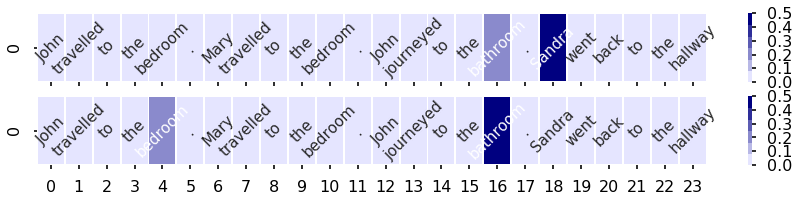

------------------------------
[2, 6, 23, 10, 21, 20, 11, 4, 8, 16, 21, 20, 13, 4, 6, 23, 21, 20, 13, 4, 6, 23, 21, 20, 12, 3]
Where is Sandra
garden


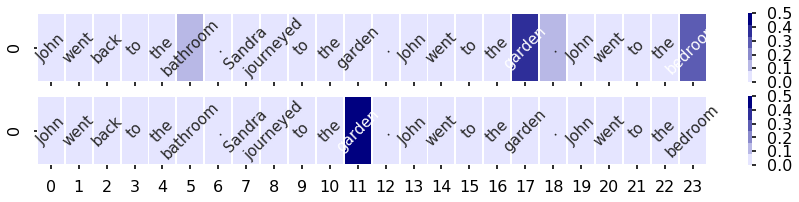

------------------------------
[2, 6, 23, 10, 21, 20, 11, 4, 6, 18, 21, 20, 17, 4, 8, 18, 21, 20, 19, 4, 8, 22, 21, 20, 12, 3]
Where is John
kitchen


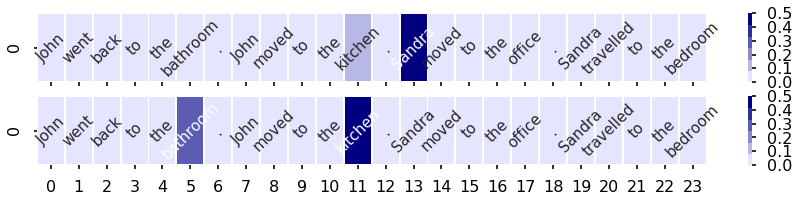

------------------------------
[2, 8, 16, 21, 20, 17, 4, 6, 18, 21, 20, 14, 4, 5, 23, 10, 21, 20, 14, 4, 7, 23, 21, 20, 11, 3]
Where is Sandra
kitchen


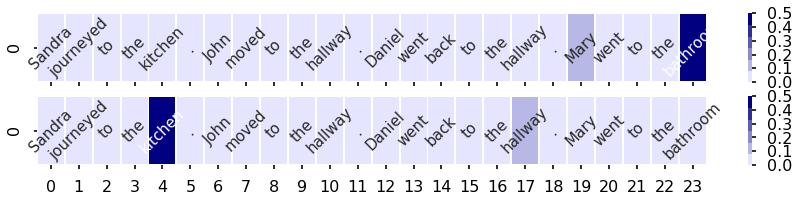

------------------------------
[2, 7, 23, 21, 20, 17, 4, 8, 23, 21, 20, 13, 4, 6, 16, 21, 20, 14, 4, 6, 23, 10, 21, 20, 11, 3]
Where is Mary
kitchen


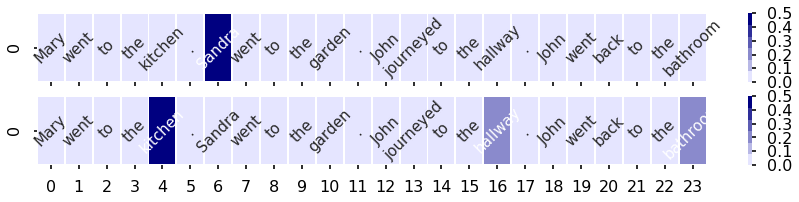

------------------------------
[2, 8, 22, 21, 20, 12, 4, 6, 22, 21, 20, 13, 4, 7, 23, 21, 20, 14, 4, 7, 23, 10, 21, 20, 12, 3]
Where is John
garden


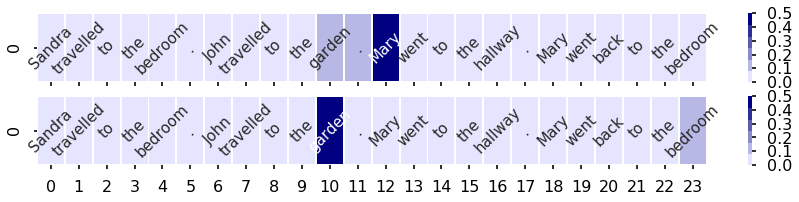

------------------------------
[2, 5, 23, 10, 21, 20, 19, 4, 8, 18, 21, 20, 11, 4, 8, 22, 21, 20, 17, 4, 7, 23, 21, 20, 17, 3]
Where is Sandra
kitchen


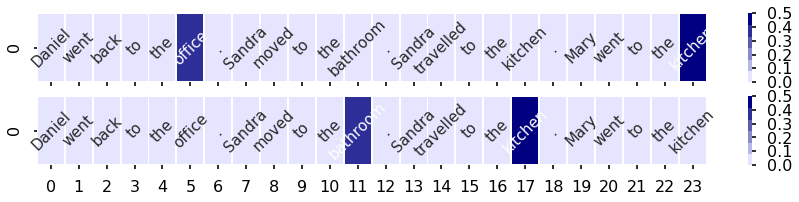

------------------------------
[2, 5, 22, 21, 20, 12, 4, 8, 18, 21, 20, 11, 4, 6, 23, 10, 21, 20, 12, 4, 8, 22, 21, 20, 17, 3]
Where is John
bedroom


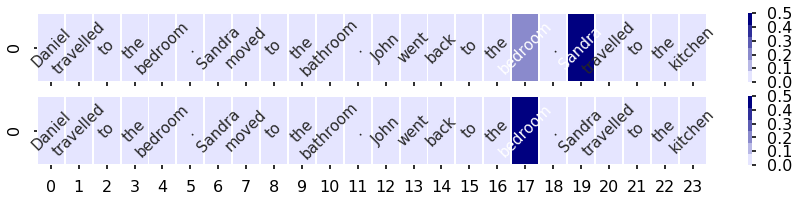

------------------------------
[2, 5, 23, 10, 21, 20, 19, 4, 6, 23, 21, 20, 12, 4, 7, 23, 21, 20, 17, 4, 5, 18, 21, 20, 13, 3]
Where is John
bedroom


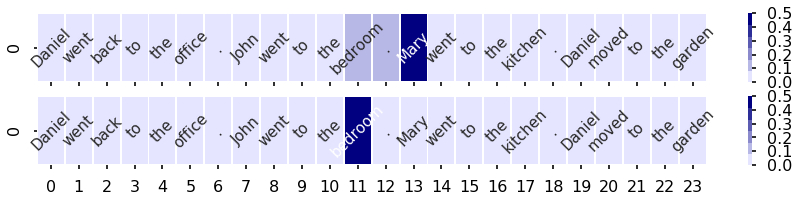

------------------------------
[2, 5, 22, 21, 20, 19, 4, 8, 23, 10, 21, 20, 19, 4, 7, 23, 21, 20, 19, 4, 5, 18, 21, 20, 11, 3]
Where is Sandra
office


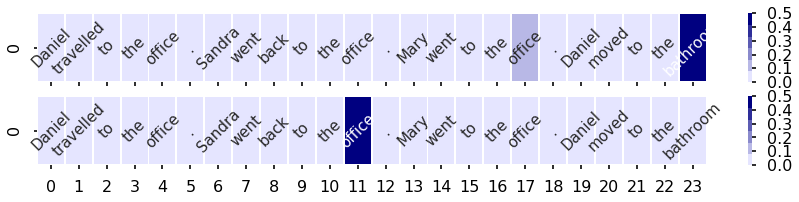

------------------------------
[2, 8, 16, 21, 20, 11, 4, 6, 18, 21, 20, 13, 4, 8, 23, 10, 21, 20, 13, 4, 5, 18, 21, 20, 17, 3]
Where is Sandra
garden


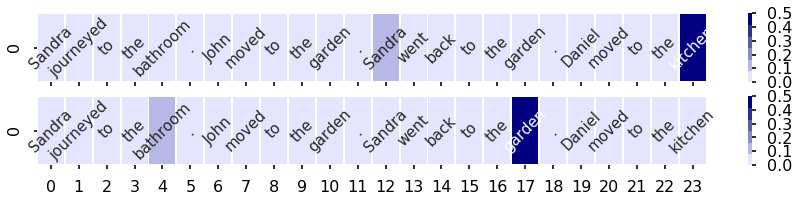

------------------------------
[2, 8, 22, 21, 20, 12, 4, 5, 23, 21, 20, 12, 4, 8, 16, 21, 20, 13, 4, 5, 23, 10, 21, 20, 14, 3]
Where is Sandra
garden


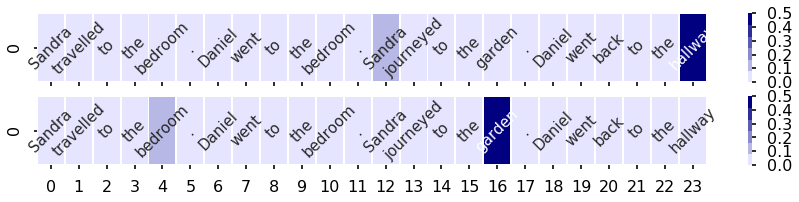

------------------------------
[2, 7, 18, 21, 20, 17, 4, 8, 22, 21, 20, 12, 4, 5, 16, 21, 20, 19, 4, 8, 23, 10, 21, 20, 17, 3]
Where is Mary
kitchen


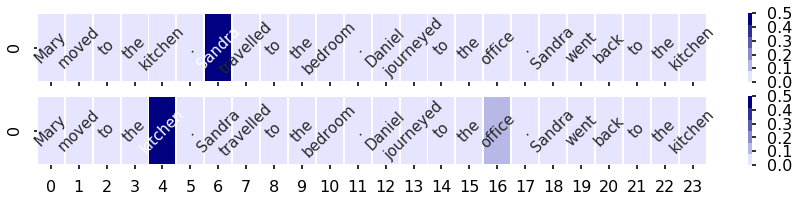

------------------------------
[2, 6, 23, 10, 21, 20, 19, 4, 5, 23, 21, 20, 11, 4, 6, 16, 21, 20, 17, 4, 7, 23, 21, 20, 11, 3]
Where is John
kitchen


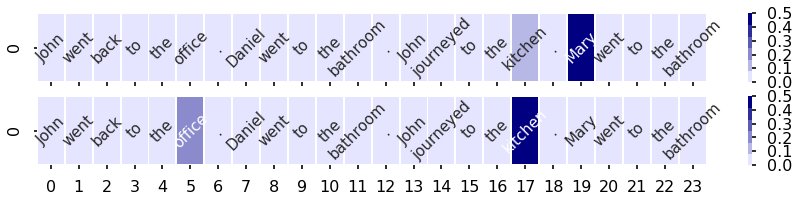

------------------------------
[2, 8, 23, 10, 21, 20, 19, 4, 6, 18, 21, 20, 11, 4, 8, 16, 21, 20, 12, 4, 7, 16, 21, 20, 11, 3]
Where is Sandra
bedroom


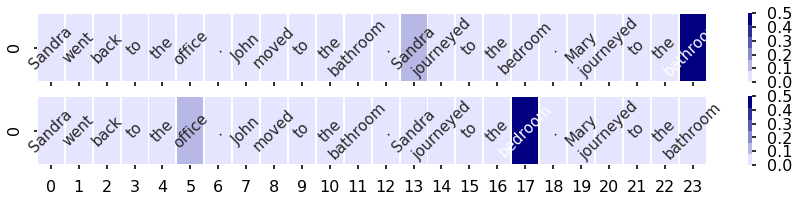

------------------------------
[2, 8, 23, 21, 20, 12, 4, 8, 22, 21, 20, 19, 4, 5, 23, 10, 21, 20, 13, 4, 7, 22, 21, 20, 12, 3]
Where is Sandra
office


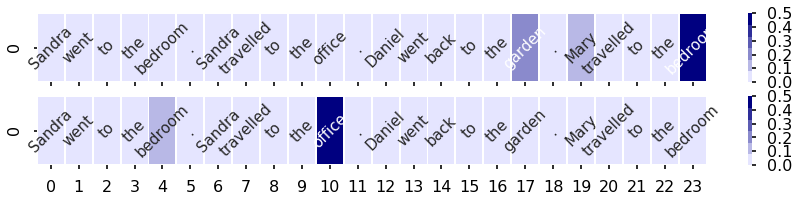

------------------------------
[2, 7, 23, 21, 20, 11, 4, 8, 23, 10, 21, 20, 11, 4, 8, 18, 21, 20, 19, 4, 6, 16, 21, 20, 14, 3]
Where is Sandra
office


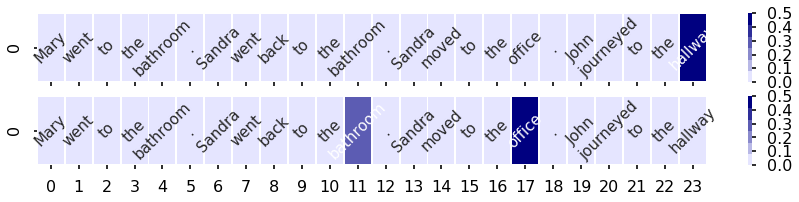

------------------------------
[2, 5, 23, 21, 20, 11, 4, 6, 23, 21, 20, 13, 4, 6, 23, 10, 21, 20, 12, 4, 7, 16, 21, 20, 19, 3]
Where is John
bedroom


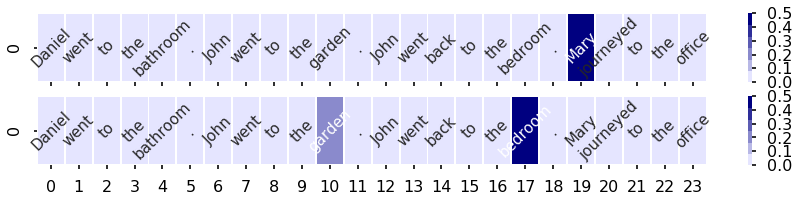

------------------------------
[2, 6, 22, 21, 20, 17, 4, 7, 22, 21, 20, 17, 4, 7, 23, 10, 21, 20, 11, 4, 8, 22, 21, 20, 14, 3]
Where is John
kitchen


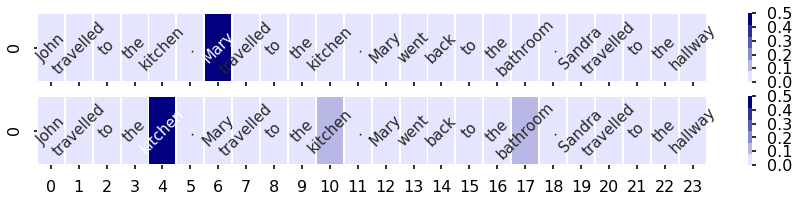

------------------------------
[2, 6, 23, 21, 20, 19, 4, 7, 22, 21, 20, 13, 4, 5, 16, 21, 20, 17, 4, 7, 23, 10, 21, 20, 12, 3]
Where is John
office


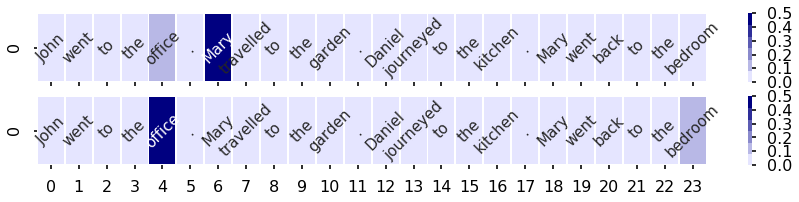

------------------------------
[2, 8, 23, 21, 20, 12, 4, 6, 22, 21, 20, 19, 4, 6, 22, 21, 20, 12, 4, 8, 23, 10, 21, 20, 17, 3]
Where is John
bedroom


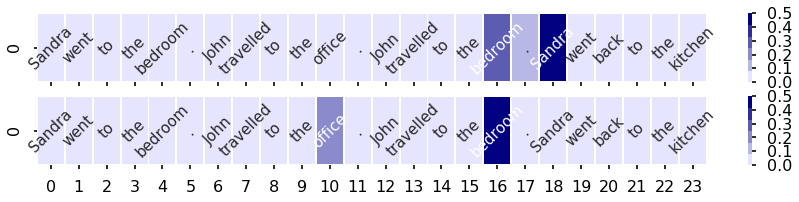

------------------------------
[2, 8, 18, 21, 20, 17, 4, 6, 22, 21, 20, 19, 4, 8, 23, 10, 21, 20, 13, 4, 6, 23, 21, 20, 13, 3]
Where is Sandra
garden


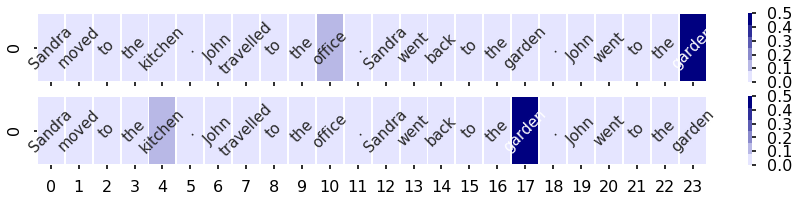

------------------------------
[2, 7, 18, 21, 20, 19, 4, 6, 18, 21, 20, 13, 4, 8, 18, 21, 20, 12, 4, 8, 23, 10, 21, 20, 19, 3]
Where is John
garden


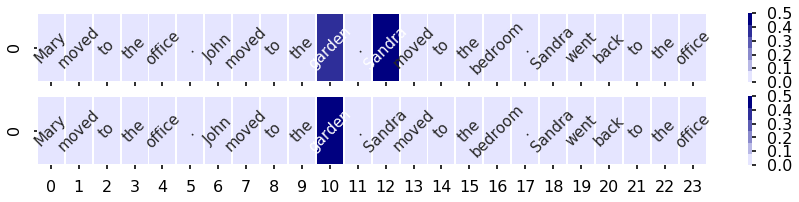

------------------------------
[2, 8, 23, 10, 21, 20, 12, 4, 7, 16, 21, 20, 13, 4, 6, 16, 21, 20, 17, 4, 8, 23, 21, 20, 19, 3]
Where is John
kitchen


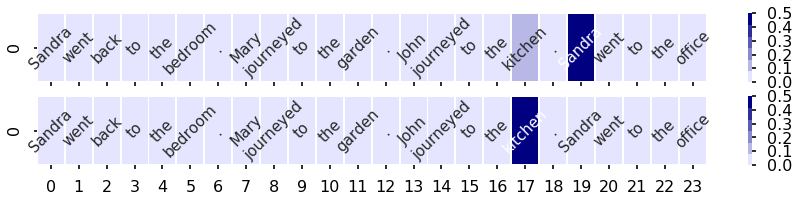

------------------------------
[2, 5, 23, 21, 20, 12, 4, 8, 23, 21, 20, 17, 4, 5, 18, 21, 20, 17, 4, 6, 23, 10, 21, 20, 12, 3]
Where is Sandra
kitchen


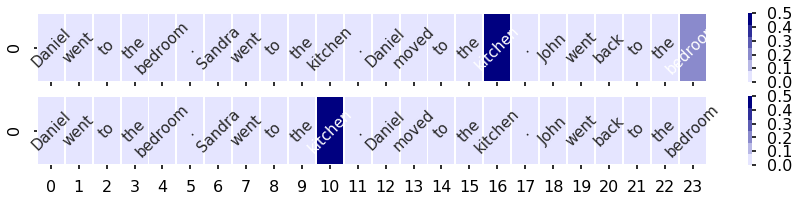

------------------------------
[2, 6, 23, 10, 21, 20, 12, 4, 6, 16, 21, 20, 13, 4, 5, 16, 21, 20, 11, 4, 8, 23, 10, 21, 20, 17, 3]
Where is John
garden


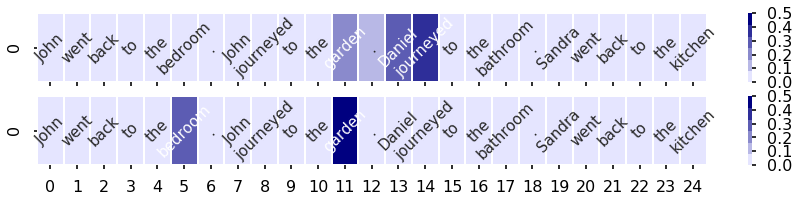

------------------------------
[2, 5, 23, 10, 21, 20, 11, 4, 7, 23, 10, 21, 20, 11, 4, 7, 23, 21, 20, 13, 4, 8, 18, 21, 20, 12, 3]
Where is Daniel
bathroom


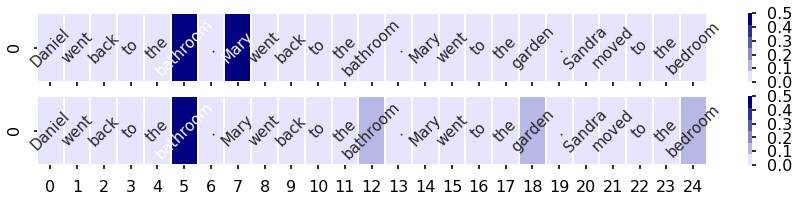

------------------------------
[2, 6, 23, 10, 21, 20, 14, 4, 8, 23, 21, 20, 17, 4, 5, 23, 10, 21, 20, 12, 4, 7, 18, 21, 20, 17, 3]
Where is John
hallway


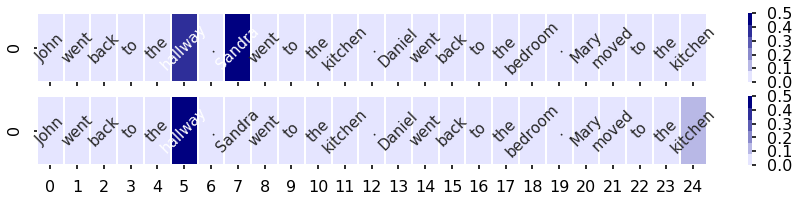

------------------------------
[2, 8, 23, 10, 21, 20, 13, 4, 6, 18, 21, 20, 19, 4, 8, 22, 21, 20, 11, 4, 7, 23, 10, 21, 20, 17, 3]
Where is John
office


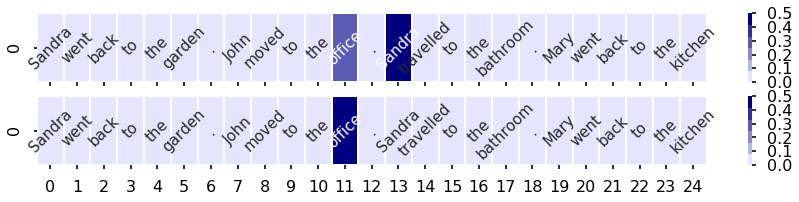

------------------------------
[2, 7, 23, 10, 21, 20, 11, 4, 7, 16, 21, 20, 13, 4, 8, 23, 10, 21, 20, 12, 4, 5, 18, 21, 20, 11, 3]
Where is Mary
garden


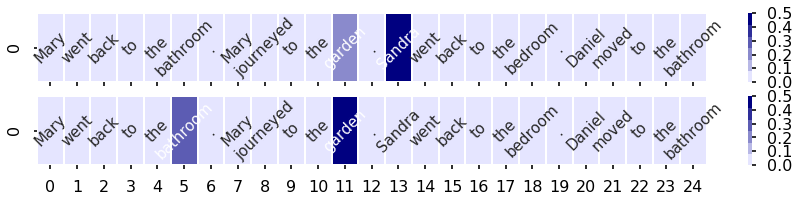

------------------------------
[2, 6, 22, 21, 20, 17, 4, 5, 23, 10, 21, 20, 17, 4, 5, 23, 21, 20, 13, 4, 7, 23, 10, 21, 20, 19, 3]
Where is John
kitchen


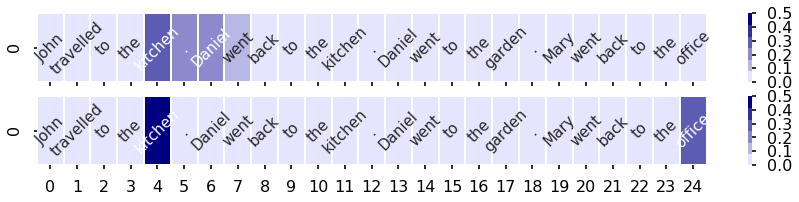

------------------------------
[2, 7, 23, 10, 21, 20, 14, 4, 8, 23, 10, 21, 20, 13, 4, 7, 23, 21, 20, 19, 4, 5, 22, 21, 20, 13, 3]
Where is Sandra
garden


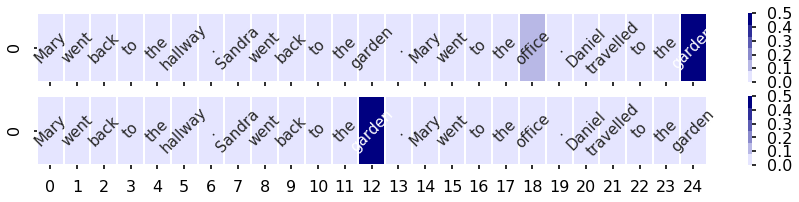

------------------------------
[2, 7, 22, 21, 20, 12, 4, 5, 23, 10, 21, 20, 13, 4, 8, 18, 21, 20, 13, 4, 5, 23, 10, 21, 20, 11, 3]
Where is Sandra
garden


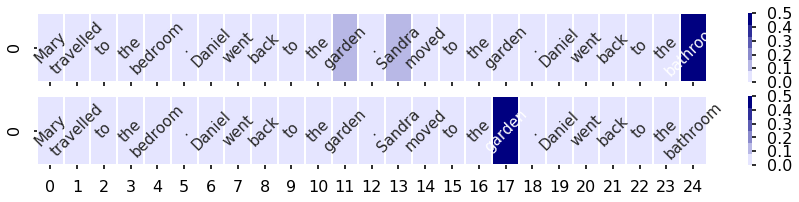

------------------------------
[2, 6, 23, 10, 21, 20, 12, 4, 8, 16, 21, 20, 11, 4, 8, 23, 21, 20, 14, 4, 7, 23, 10, 21, 20, 14, 3]
Where is John
bedroom


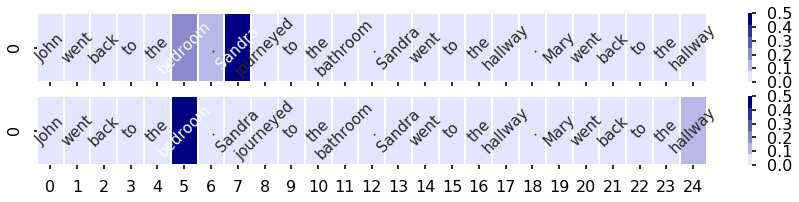

------------------------------
[2, 8, 23, 21, 20, 13, 4, 6, 22, 21, 20, 19, 4, 8, 23, 10, 21, 20, 14, 4, 7, 23, 10, 21, 20, 19, 3]
Where is John
office


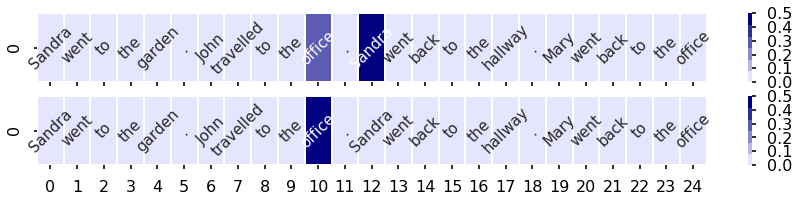

------------------------------
[2, 5, 23, 10, 21, 20, 12, 4, 6, 23, 10, 21, 20, 12, 4, 6, 23, 10, 21, 20, 11, 4, 7, 16, 21, 20, 14, 3]
Where is John
bathroom


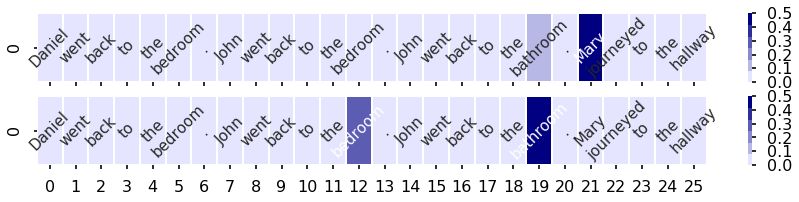

------------------------------
[2, 5, 23, 10, 21, 20, 14, 4, 7, 23, 10, 21, 20, 19, 4, 7, 23, 21, 20, 13, 4, 7, 23, 10, 21, 20, 17, 3]
Where is Daniel
hallway


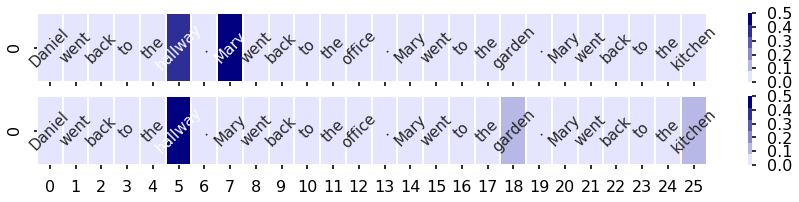

------------------------------
[2, 8, 22, 21, 20, 11, 4, 6, 23, 10, 21, 20, 19, 4, 8, 23, 10, 21, 20, 13, 4, 6, 23, 10, 21, 20, 12, 3]
Where is Sandra
garden


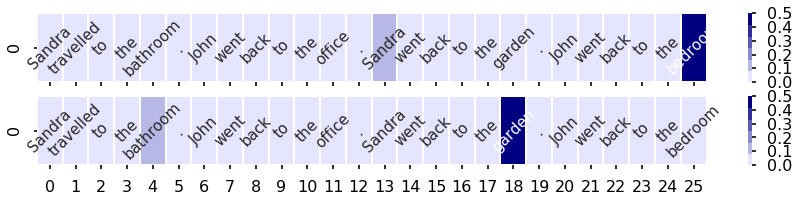

------------------------------
[2, 5, 18, 21, 20, 12, 4, 7, 22, 21, 20, 14, 4, 7, 22, 21, 20, 12, 4, 6, 22, 21, 20, 19, 4, 5, 23, 21, 20, 14, 4, 7, 22, 21, 20, 11, 3]
Where is John
office


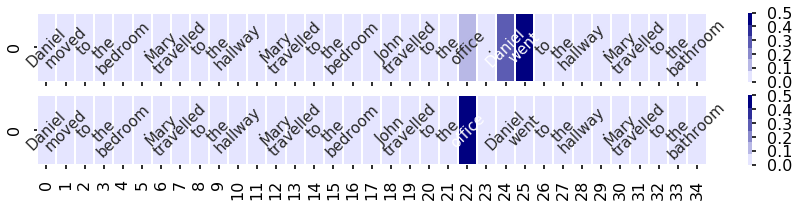

------------------------------
[2, 6, 16, 21, 20, 14, 4, 6, 16, 21, 20, 12, 4, 5, 16, 21, 20, 12, 4, 6, 16, 21, 20, 19, 4, 6, 18, 21, 20, 13, 4, 5, 18, 21, 20, 13, 3]
Where is John
garden


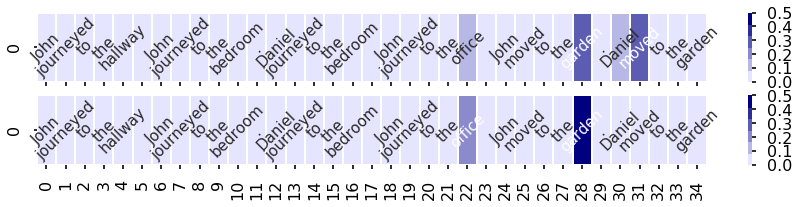

------------------------------
[2, 8, 18, 21, 20, 14, 4, 5, 23, 21, 20, 19, 4, 8, 22, 21, 20, 17, 4, 6, 18, 21, 20, 19, 4, 8, 23, 21, 20, 11, 4, 8, 18, 21, 20, 17, 3]
Where is Sandra
kitchen


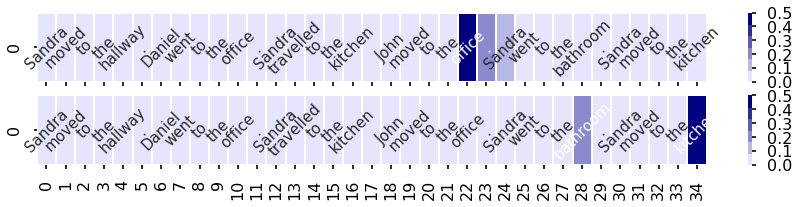

------------------------------
[2, 8, 18, 21, 20, 13, 4, 6, 23, 21, 20, 12, 4, 6, 18, 21, 20, 11, 4, 6, 23, 21, 20, 13, 4, 6, 16, 21, 20, 12, 4, 8, 23, 21, 20, 19, 3]
Where is John
bedroom


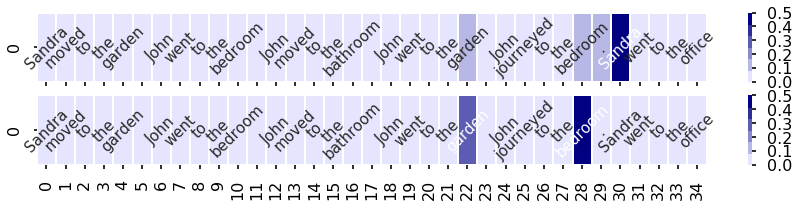

------------------------------
[2, 6, 22, 21, 20, 11, 4, 6, 22, 21, 20, 13, 4, 5, 16, 21, 20, 19, 4, 8, 23, 21, 20, 13, 4, 6, 22, 21, 20, 17, 4, 7, 16, 21, 20, 12, 3]
Where is John
kitchen


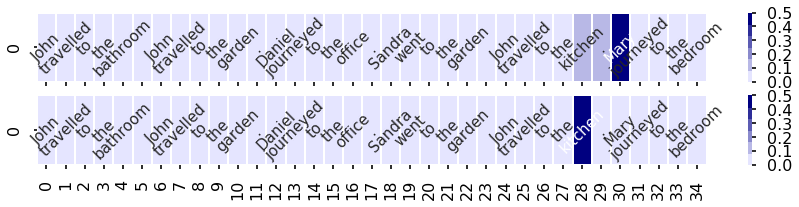

------------------------------
[2, 6, 23, 21, 20, 11, 4, 5, 18, 21, 20, 17, 4, 8, 22, 21, 20, 19, 4, 5, 23, 21, 20, 19, 4, 6, 18, 21, 20, 19, 4, 5, 16, 21, 20, 13, 3]
Where is Sandra
office


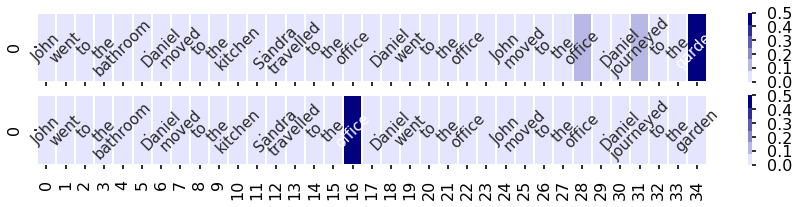

------------------------------
[2, 6, 22, 21, 20, 13, 4, 8, 22, 21, 20, 13, 4, 7, 16, 21, 20, 19, 4, 7, 23, 21, 20, 13, 4, 6, 23, 21, 20, 14, 4, 7, 23, 21, 20, 12, 3]
Where is John
hallway


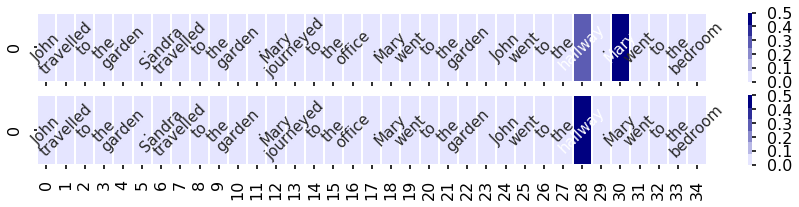

------------------------------
[2, 5, 22, 21, 20, 17, 4, 6, 16, 21, 20, 17, 4, 8, 18, 21, 20, 17, 4, 8, 23, 21, 20, 13, 4, 6, 22, 21, 20, 19, 4, 5, 23, 21, 20, 11, 3]
Where is Sandra
garden


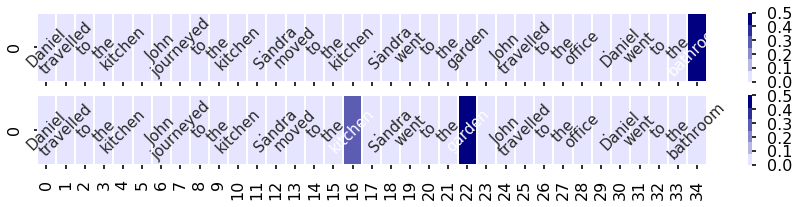

------------------------------
[2, 5, 23, 21, 20, 13, 4, 7, 18, 21, 20, 12, 4, 5, 16, 21, 20, 11, 4, 8, 16, 21, 20, 11, 4, 5, 18, 21, 20, 14, 4, 8, 16, 21, 20, 17, 3]
Where is Mary
bedroom


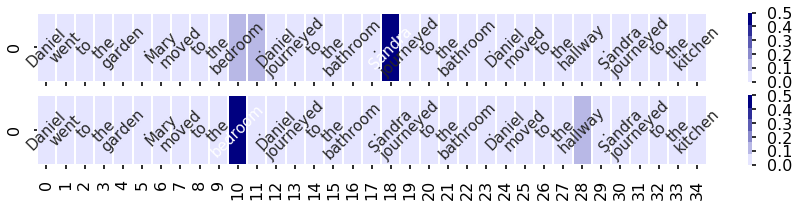

------------------------------
[2, 7, 18, 21, 20, 14, 4, 8, 22, 21, 20, 11, 4, 7, 22, 21, 20, 17, 4, 8, 23, 21, 20, 13, 4, 8, 22, 21, 20, 14, 4, 6, 23, 21, 20, 14, 3]
Where is Sandra
hallway


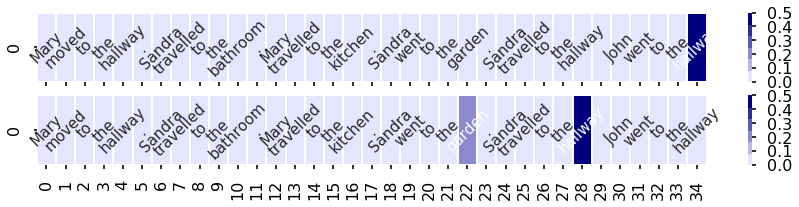

------------------------------
[2, 5, 16, 21, 20, 12, 4, 8, 16, 21, 20, 11, 4, 6, 23, 21, 20, 19, 4, 8, 18, 21, 20, 12, 4, 7, 16, 21, 20, 13, 4, 7, 23, 21, 20, 12, 3]
Where is John
office


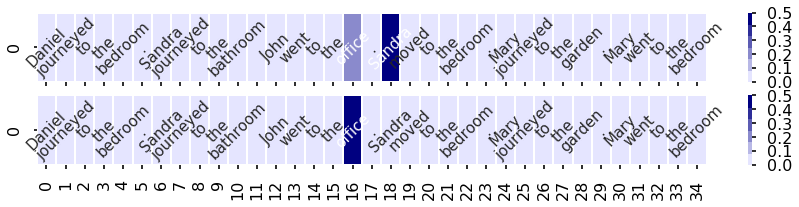

------------------------------
[2, 8, 18, 21, 20, 13, 4, 6, 23, 21, 20, 13, 4, 8, 23, 21, 20, 11, 4, 8, 23, 21, 20, 17, 4, 5, 18, 21, 20, 17, 4, 7, 16, 21, 20, 17, 3]
Where is Sandra
kitchen


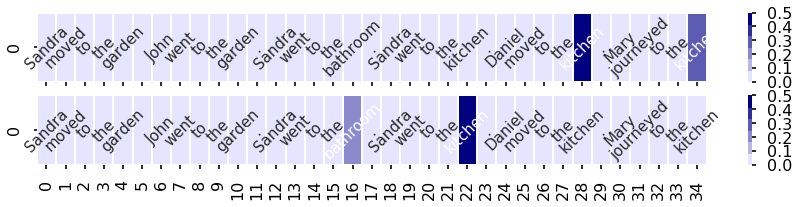

------------------------------
[2, 7, 18, 21, 20, 11, 4, 5, 16, 21, 20, 12, 4, 5, 23, 21, 20, 13, 4, 6, 23, 21, 20, 12, 4, 8, 16, 21, 20, 19, 4, 8, 23, 21, 20, 11, 3]
Where is John
bedroom


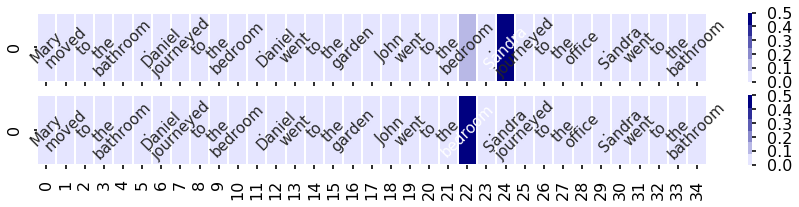

------------------------------
[2, 5, 16, 21, 20, 17, 4, 5, 16, 21, 20, 19, 4, 7, 22, 21, 20, 14, 4, 6, 18, 21, 20, 13, 4, 7, 22, 21, 20, 19, 4, 7, 22, 21, 20, 13, 3]
Where is John
garden


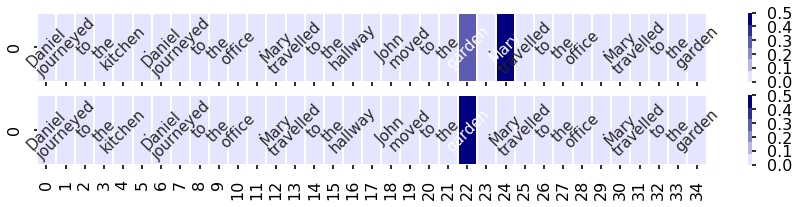

------------------------------
[2, 5, 23, 21, 20, 11, 4, 7, 22, 21, 20, 14, 4, 6, 23, 21, 20, 12, 4, 6, 22, 21, 20, 11, 4, 7, 23, 21, 20, 19, 4, 8, 16, 21, 20, 17, 3]
Where is John
bathroom


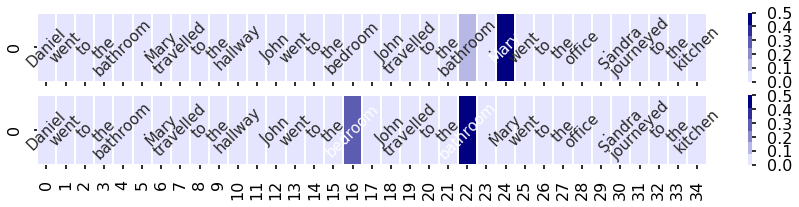

------------------------------
[2, 8, 22, 21, 20, 12, 4, 8, 16, 21, 20, 13, 4, 8, 18, 21, 20, 14, 4, 8, 22, 21, 20, 11, 4, 7, 23, 21, 20, 11, 4, 6, 18, 21, 20, 19, 3]
Where is Sandra
bathroom


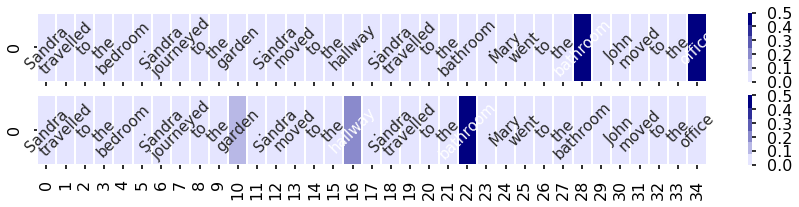

------------------------------
[2, 5, 23, 21, 20, 11, 4, 7, 22, 21, 20, 11, 4, 6, 23, 21, 20, 19, 4, 6, 16, 21, 20, 17, 4, 8, 23, 21, 20, 14, 4, 8, 22, 21, 20, 13, 3]
Where is John
kitchen


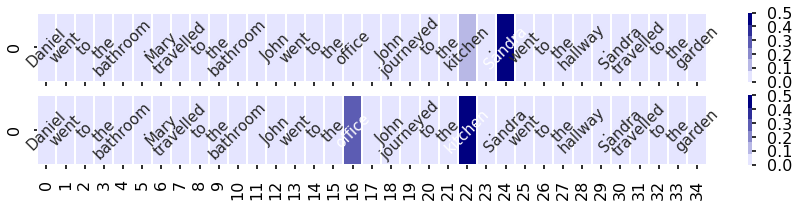

------------------------------
[2, 7, 16, 21, 20, 19, 4, 7, 16, 21, 20, 12, 4, 8, 23, 21, 20, 13, 4, 8, 18, 21, 20, 17, 4, 8, 23, 21, 20, 11, 4, 5, 18, 21, 20, 19, 3]
Where is Sandra
bathroom


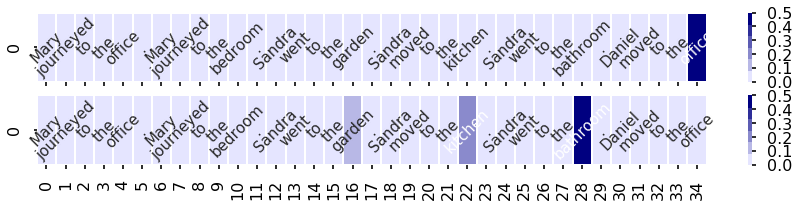

------------------------------
[2, 6, 16, 21, 20, 19, 4, 8, 22, 21, 20, 13, 4, 8, 18, 21, 20, 19, 4, 5, 22, 21, 20, 14, 4, 6, 22, 21, 20, 11, 4, 5, 16, 21, 20, 13, 3]
Where is Sandra
office


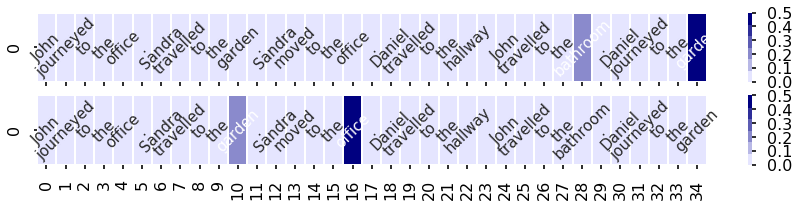

------------------------------
[2, 8, 16, 21, 20, 17, 4, 6, 18, 21, 20, 14, 4, 5, 23, 10, 21, 20, 14, 4, 7, 23, 21, 20, 11, 4, 6, 22, 21, 20, 13, 4, 7, 18, 21, 20, 14, 3]
Where is John
garden


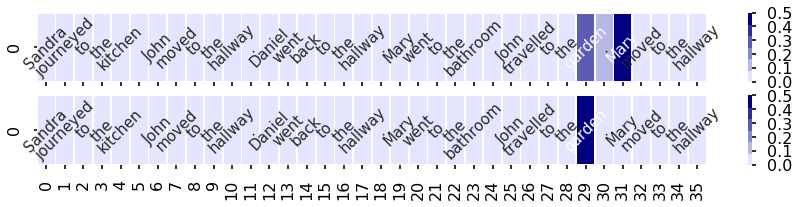

------------------------------
[2, 6, 22, 21, 20, 12, 4, 7, 23, 21, 20, 11, 4, 7, 16, 21, 20, 12, 4, 8, 22, 21, 20, 14, 4, 5, 23, 10, 21, 20, 14, 4, 8, 16, 21, 20, 19, 3]
Where is Mary
bedroom


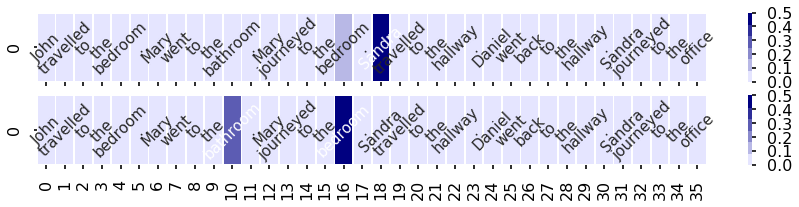

------------------------------
[2, 8, 22, 21, 20, 17, 4, 5, 22, 21, 20, 11, 4, 6, 23, 21, 20, 14, 4, 8, 16, 21, 20, 12, 4, 6, 16, 21, 20, 17, 4, 7, 23, 10, 21, 20, 19, 3]
Where is John
kitchen


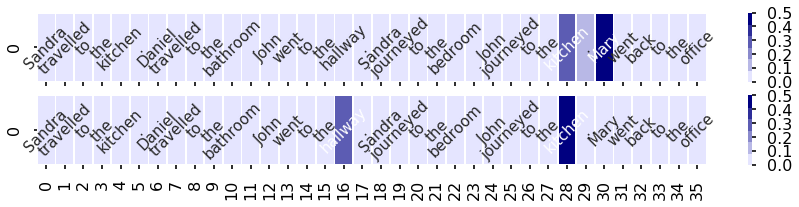

------------------------------
[2, 6, 22, 21, 20, 12, 4, 7, 22, 21, 20, 12, 4, 6, 16, 21, 20, 11, 4, 8, 23, 10, 21, 20, 14, 4, 6, 23, 21, 20, 19, 4, 5, 22, 21, 20, 17, 3]
Where is John
office


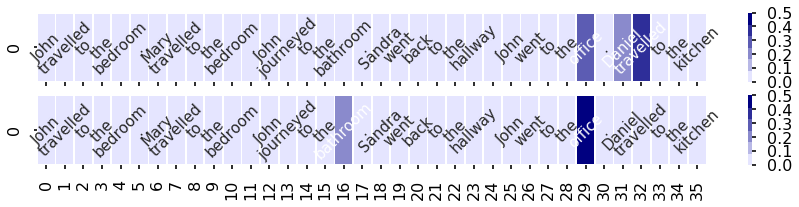

------------------------------
[2, 7, 16, 21, 20, 13, 4, 6, 23, 10, 21, 20, 13, 4, 7, 18, 21, 20, 19, 4, 6, 18, 21, 20, 12, 4, 8, 22, 21, 20, 11, 4, 8, 18, 21, 20, 13, 3]
Where is John
bedroom


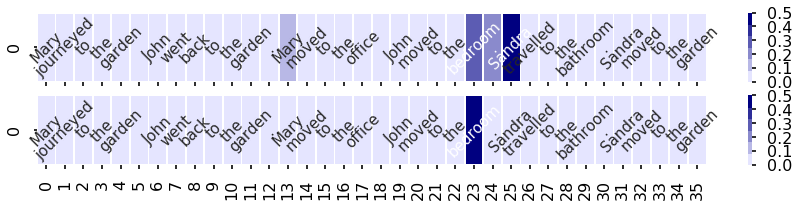

------------------------------
[2, 7, 22, 21, 20, 14, 4, 5, 16, 21, 20, 12, 4, 6, 23, 10, 21, 20, 13, 4, 8, 16, 21, 20, 11, 4, 6, 23, 21, 20, 17, 4, 8, 16, 21, 20, 13, 3]
Where is John
kitchen


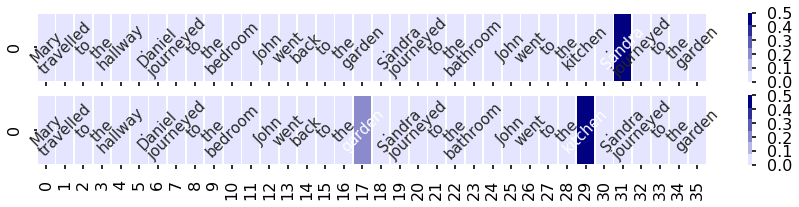

------------------------------
[2, 5, 16, 21, 20, 14, 4, 8, 23, 21, 20, 17, 4, 6, 22, 21, 20, 17, 4, 6, 23, 10, 21, 20, 19, 4, 7, 18, 21, 20, 11, 4, 5, 22, 21, 20, 19, 3]
Where is Sandra
kitchen


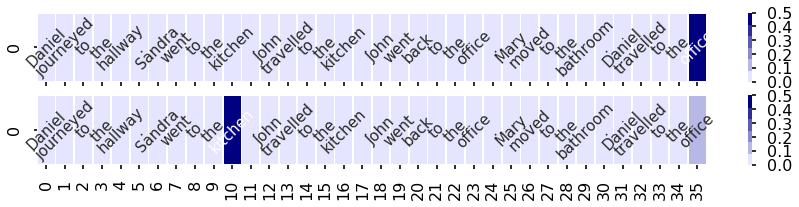

------------------------------
[2, 5, 23, 10, 21, 20, 12, 4, 8, 23, 21, 20, 13, 4, 8, 18, 21, 20, 17, 4, 6, 22, 21, 20, 14, 4, 5, 18, 21, 20, 17, 4, 6, 16, 21, 20, 17, 3]
Where is Sandra
kitchen


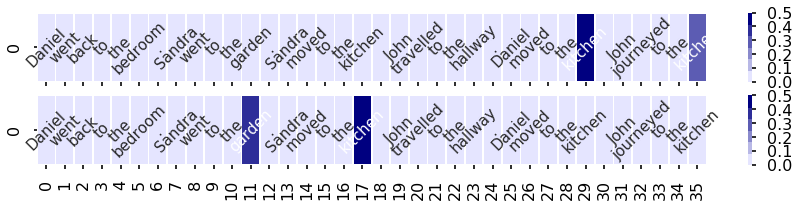

------------------------------
[2, 7, 16, 21, 20, 17, 4, 8, 23, 10, 21, 20, 19, 4, 6, 18, 21, 20, 12, 4, 7, 22, 21, 20, 11, 4, 8, 18, 21, 20, 11, 4, 7, 22, 21, 20, 17, 3]
Where is Sandra
bathroom


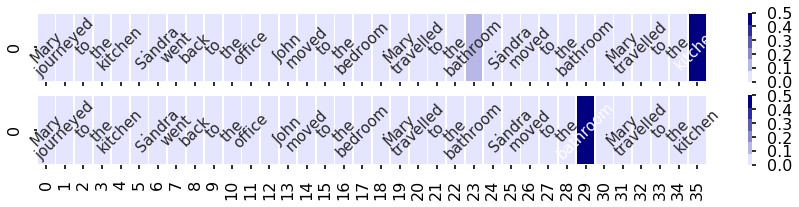

------------------------------
[2, 8, 23, 21, 20, 12, 4, 6, 23, 10, 21, 20, 19, 4, 8, 18, 21, 20, 11, 4, 7, 23, 21, 20, 13, 4, 5, 22, 21, 20, 12, 4, 8, 18, 21, 20, 14, 3]
Where is John
office


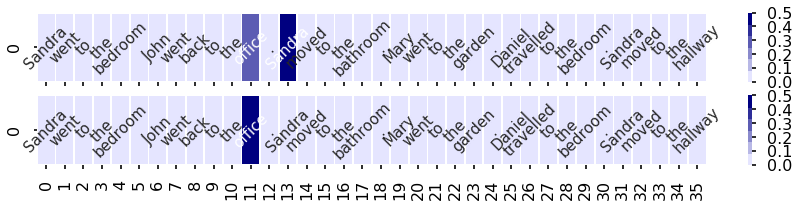

------------------------------
[2, 8, 23, 10, 21, 20, 11, 4, 8, 22, 21, 20, 13, 4, 7, 16, 21, 20, 11, 4, 8, 23, 21, 20, 17, 4, 5, 16, 21, 20, 19, 4, 6, 23, 21, 20, 13, 3]
Where is Sandra
kitchen


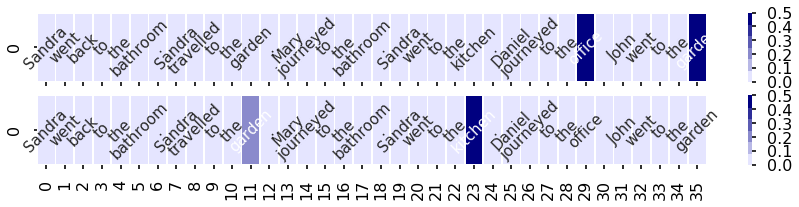

------------------------------
[2, 8, 18, 21, 20, 13, 4, 6, 16, 21, 20, 12, 4, 7, 23, 10, 21, 20, 12, 4, 8, 22, 21, 20, 19, 4, 6, 22, 21, 20, 11, 4, 7, 22, 21, 20, 13, 3]
Where is Sandra
office


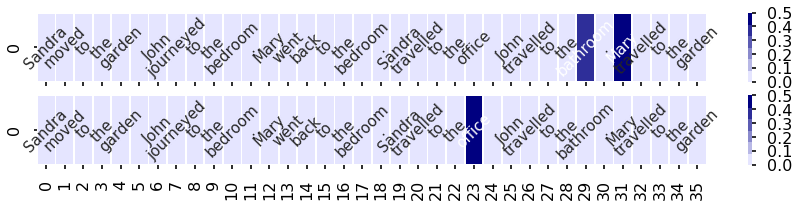

------------------------------
[2, 6, 23, 21, 20, 19, 4, 8, 23, 21, 20, 17, 4, 6, 23, 10, 21, 20, 17, 4, 7, 18, 21, 20, 13, 4, 7, 23, 21, 20, 17, 4, 8, 18, 21, 20, 12, 3]
Where is Mary
kitchen


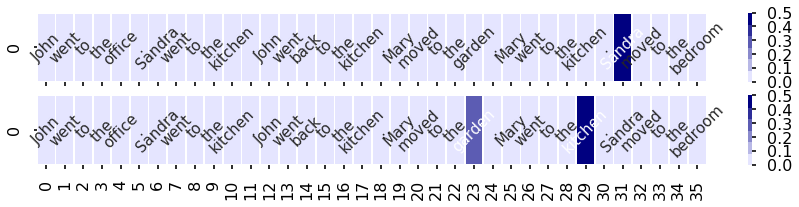

------------------------------
[2, 6, 23, 21, 20, 13, 4, 8, 22, 21, 20, 13, 4, 6, 22, 21, 20, 12, 4, 6, 22, 21, 20, 19, 4, 6, 23, 10, 21, 20, 17, 4, 7, 22, 21, 20, 14, 3]
Where is John
kitchen


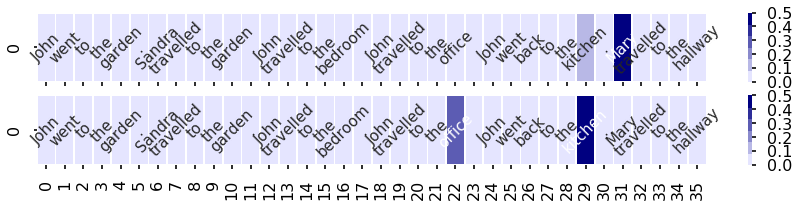

------------------------------
[2, 7, 23, 10, 21, 20, 11, 4, 7, 16, 21, 20, 13, 4, 8, 23, 10, 21, 20, 12, 4, 5, 18, 21, 20, 11, 4, 7, 18, 21, 20, 14, 4, 5, 23, 21, 20, 14, 3]
Where is Sandra
bedroom


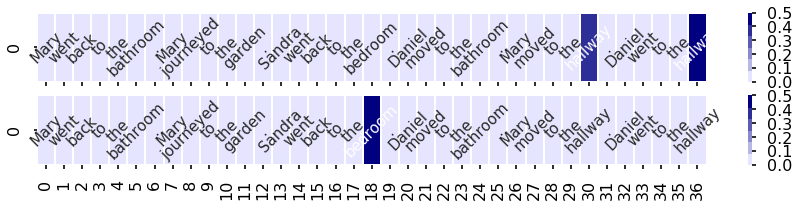

------------------------------
[2, 7, 23, 21, 20, 11, 4, 8, 23, 10, 21, 20, 11, 4, 8, 18, 21, 20, 19, 4, 6, 16, 21, 20, 14, 4, 5, 23, 21, 20, 14, 4, 5, 23, 10, 21, 20, 13, 3]
Where is Sandra
office


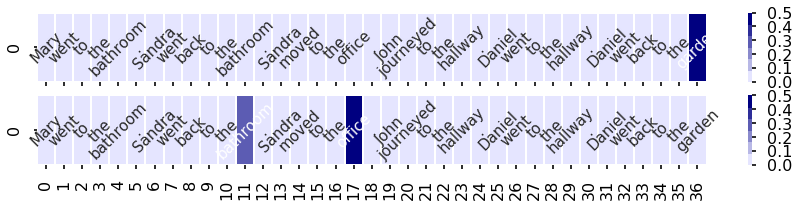

------------------------------
[2, 6, 23, 10, 21, 20, 19, 4, 5, 23, 21, 20, 11, 4, 6, 16, 21, 20, 17, 4, 7, 23, 21, 20, 11, 4, 8, 18, 21, 20, 13, 4, 5, 23, 10, 21, 20, 12, 3]
Where is Sandra
garden


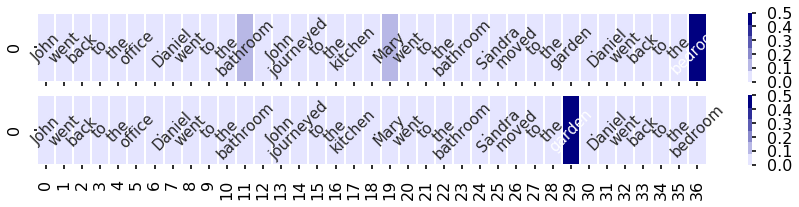

------------------------------
[2, 6, 23, 21, 20, 14, 4, 8, 22, 21, 20, 14, 4, 8, 22, 21, 20, 17, 4, 6, 23, 10, 21, 20, 17, 4, 6, 23, 10, 21, 20, 13, 4, 7, 18, 21, 20, 17, 3]
Where is Sandra
kitchen


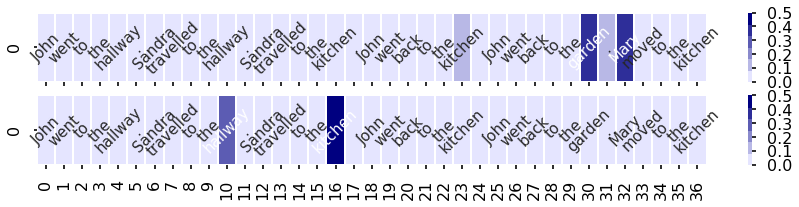

------------------------------
[2, 7, 16, 21, 20, 17, 4, 5, 18, 21, 20, 12, 4, 7, 23, 21, 20, 11, 4, 6, 23, 21, 20, 11, 4, 8, 23, 10, 21, 20, 12, 4, 6, 23, 10, 21, 20, 13, 3]
Where is Sandra
bedroom


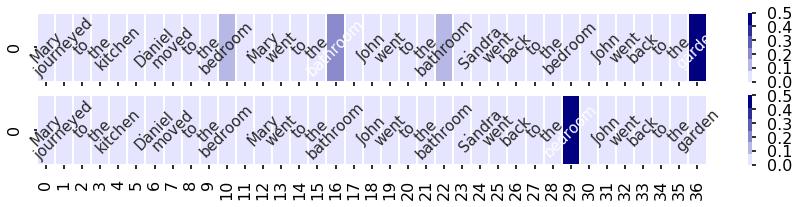

------------------------------
[2, 8, 23, 21, 20, 19, 4, 8, 22, 21, 20, 11, 4, 7, 23, 10, 21, 20, 12, 4, 5, 18, 21, 20, 13, 4, 6, 16, 21, 20, 13, 4, 5, 23, 10, 21, 20, 14, 3]
Where is Sandra
bathroom


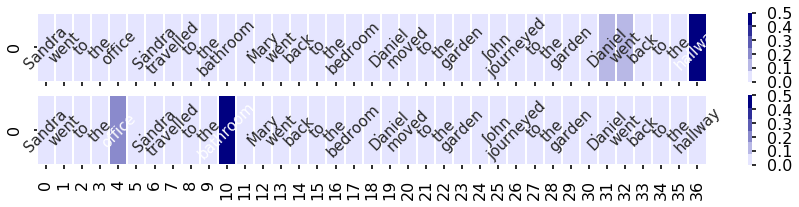

------------------------------
[2, 7, 16, 21, 20, 14, 4, 8, 16, 21, 20, 13, 4, 6, 23, 10, 21, 20, 12, 4, 8, 23, 10, 21, 20, 19, 4, 8, 22, 21, 20, 11, 4, 6, 16, 21, 20, 17, 3]
Where is Sandra
bathroom


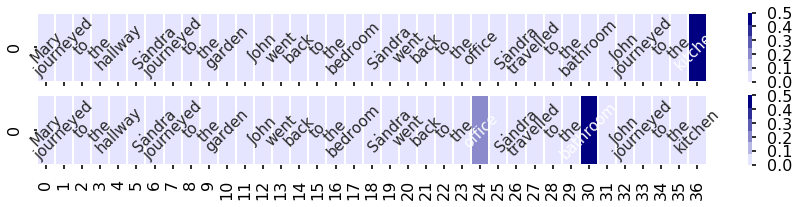

------------------------------
[2, 8, 23, 21, 20, 12, 4, 6, 22, 21, 20, 19, 4, 6, 22, 21, 20, 12, 4, 8, 23, 10, 21, 20, 17, 4, 8, 23, 10, 21, 20, 13, 4, 6, 23, 10, 21, 20, 19, 3]
Where is Sandra
garden


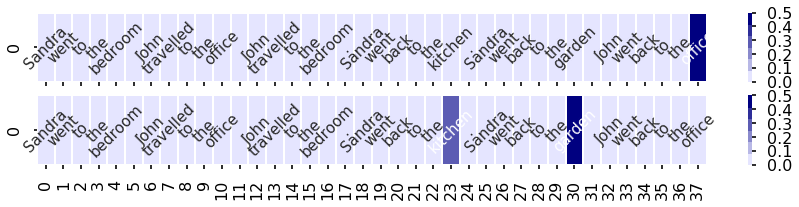

------------------------------
[2, 8, 22, 21, 20, 11, 4, 6, 23, 10, 21, 20, 19, 4, 8, 23, 10, 21, 20, 13, 4, 6, 23, 10, 21, 20, 12, 4, 5, 16, 21, 20, 14, 4, 5, 23, 21, 20, 19, 3]
Where is John
bedroom


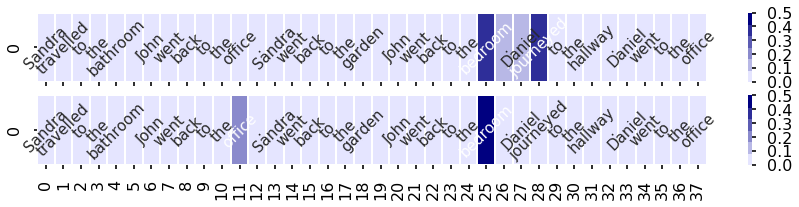

------------------------------
[2, 5, 23, 10, 21, 20, 12, 4, 6, 23, 10, 21, 20, 12, 4, 6, 23, 10, 21, 20, 11, 4, 7, 16, 21, 20, 14, 4, 5, 22, 21, 20, 11, 4, 7, 23, 21, 20, 13, 3]
Where is John
bathroom


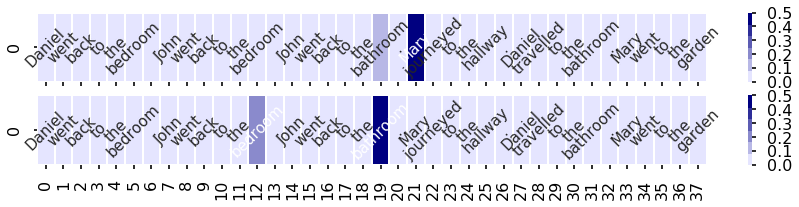

------------------------------
[2, 5, 23, 10, 21, 20, 12, 4, 7, 23, 21, 20, 13, 4, 8, 23, 21, 20, 17, 4, 8, 23, 10, 21, 20, 11, 4, 6, 16, 21, 20, 12, 4, 6, 23, 10, 21, 20, 14, 3]
Where is Mary
garden


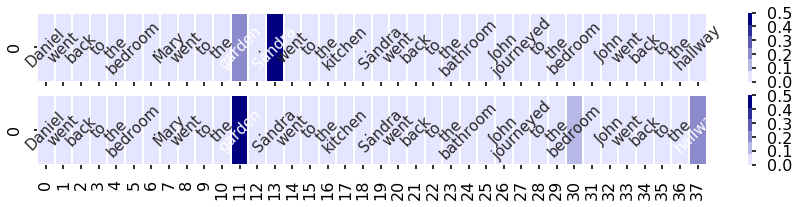

------------------------------
[2, 8, 18, 21, 20, 14, 4, 5, 23, 21, 20, 19, 4, 8, 22, 21, 20, 17, 4, 6, 18, 21, 20, 19, 4, 8, 23, 21, 20, 11, 4, 8, 18, 21, 20, 17, 4, 8, 16, 21, 20, 12, 4, 8, 23, 21, 20, 17, 3]
Where is Sandra
kitchen


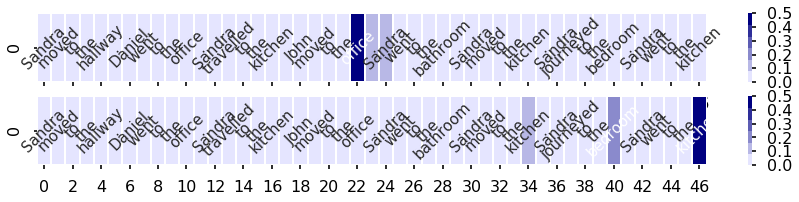

------------------------------
[2, 7, 16, 21, 20, 13, 4, 7, 22, 21, 20, 19, 4, 7, 23, 21, 20, 14, 4, 6, 16, 21, 20, 14, 4, 6, 18, 21, 20, 11, 4, 8, 23, 21, 20, 19, 4, 5, 22, 21, 20, 17, 4, 7, 22, 21, 20, 11, 3]
Where is Sandra
office


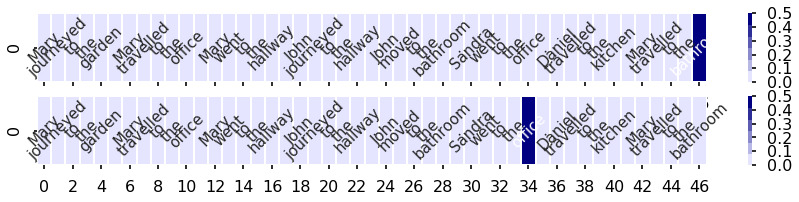

------------------------------
[2, 5, 22, 21, 20, 19, 4, 5, 16, 21, 20, 14, 4, 8, 22, 21, 20, 11, 4, 8, 18, 21, 20, 14, 4, 7, 23, 21, 20, 13, 4, 5, 18, 21, 20, 12, 4, 6, 23, 21, 20, 14, 4, 8, 22, 21, 20, 17, 3]
Where is Mary
garden


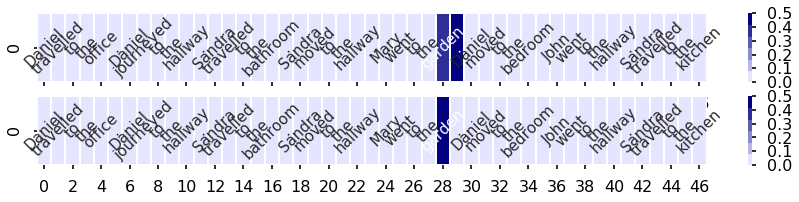

------------------------------
[2, 8, 22, 21, 20, 19, 4, 8, 18, 21, 20, 13, 4, 6, 16, 21, 20, 11, 4, 6, 18, 21, 20, 12, 4, 7, 23, 21, 20, 14, 4, 6, 16, 21, 20, 19, 4, 5, 16, 21, 20, 17, 4, 7, 18, 21, 20, 17, 3]
Where is John
office


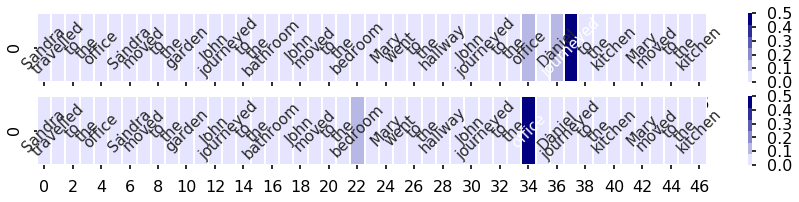

------------------------------
[2, 8, 22, 21, 20, 17, 4, 8, 22, 21, 20, 14, 4, 7, 23, 21, 20, 11, 4, 8, 18, 21, 20, 13, 4, 8, 22, 21, 20, 19, 4, 5, 16, 21, 20, 14, 4, 5, 16, 21, 20, 19, 4, 6, 18, 21, 20, 14, 3]
Where is Sandra
office


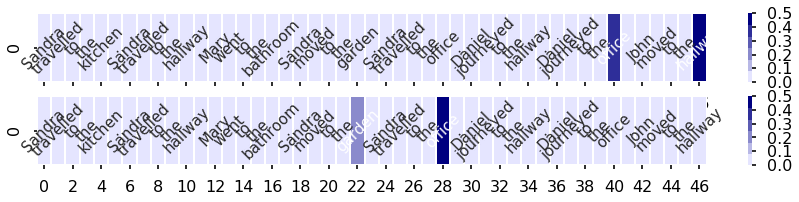

------------------------------
[2, 6, 22, 21, 20, 17, 4, 8, 18, 21, 20, 17, 4, 5, 23, 21, 20, 17, 4, 6, 16, 21, 20, 14, 4, 7, 16, 21, 20, 12, 4, 7, 16, 21, 20, 17, 4, 7, 22, 21, 20, 12, 4, 8, 22, 21, 20, 12, 3]
Where is Mary
bedroom


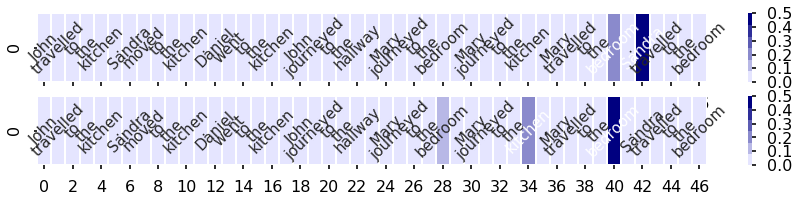

------------------------------
[2, 7, 16, 21, 20, 17, 4, 7, 22, 21, 20, 14, 4, 8, 18, 21, 20, 19, 4, 6, 16, 21, 20, 19, 4, 8, 22, 21, 20, 14, 4, 5, 23, 10, 21, 20, 11, 4, 7, 22, 21, 20, 13, 4, 5, 18, 21, 20, 12, 3]
Where is Sandra
hallway


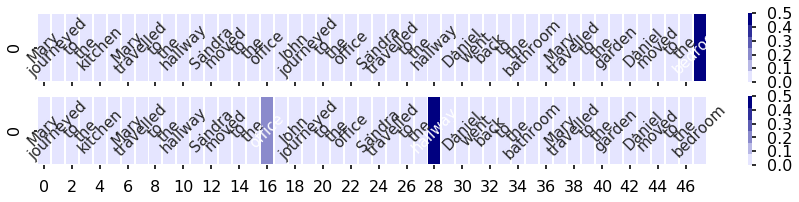

------------------------------
[2, 5, 18, 21, 20, 12, 4, 8, 16, 21, 20, 14, 4, 7, 16, 21, 20, 17, 4, 7, 23, 10, 21, 20, 11, 4, 7, 16, 21, 20, 14, 4, 7, 23, 21, 20, 12, 4, 7, 18, 21, 20, 13, 4, 8, 22, 21, 20, 19, 3]
Where is Mary
garden


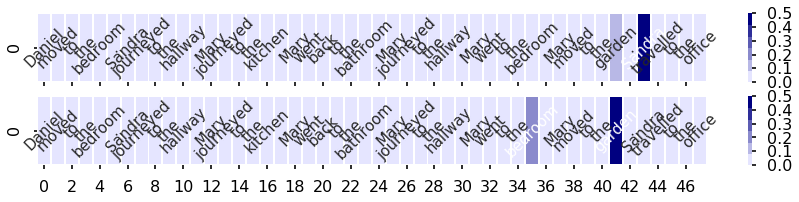

------------------------------
[2, 6, 22, 21, 20, 14, 4, 7, 16, 21, 20, 11, 4, 5, 23, 10, 21, 20, 11, 4, 6, 18, 21, 20, 12, 4, 6, 23, 21, 20, 14, 4, 8, 16, 21, 20, 17, 4, 8, 22, 21, 20, 14, 4, 6, 23, 21, 20, 13, 3]
Where is Sandra
hallway


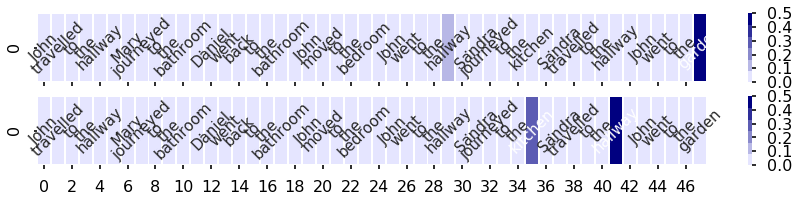

------------------------------
[2, 8, 23, 21, 20, 14, 4, 5, 18, 21, 20, 13, 4, 5, 23, 10, 21, 20, 11, 4, 7, 23, 21, 20, 12, 4, 7, 18, 21, 20, 19, 4, 8, 22, 21, 20, 12, 4, 7, 22, 21, 20, 13, 4, 7, 16, 21, 20, 17, 3]
Where is Sandra
bedroom


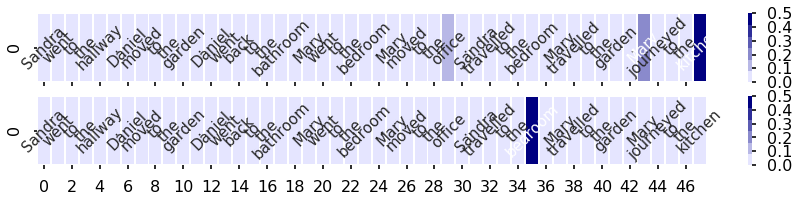

------------------------------
[2, 5, 18, 21, 20, 17, 4, 8, 22, 21, 20, 11, 4, 8, 22, 21, 20, 19, 4, 5, 16, 21, 20, 19, 4, 8, 23, 10, 21, 20, 12, 4, 6, 18, 21, 20, 17, 4, 8, 22, 21, 20, 11, 4, 6, 18, 21, 20, 11, 3]
Where is Sandra
bathroom


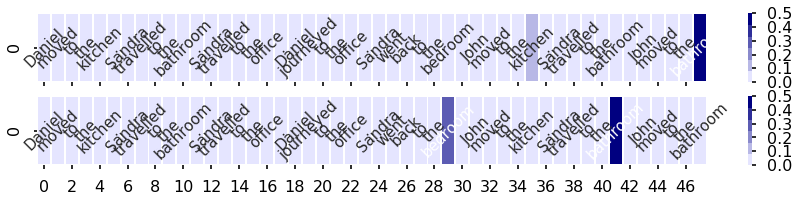

------------------------------
[2, 8, 22, 21, 20, 14, 4, 7, 23, 10, 21, 20, 14, 4, 7, 18, 21, 20, 19, 4, 8, 16, 21, 20, 17, 4, 6, 16, 21, 20, 11, 4, 8, 23, 21, 20, 13, 4, 8, 16, 21, 20, 14, 4, 6, 18, 21, 20, 12, 3]
Where is Sandra
hallway


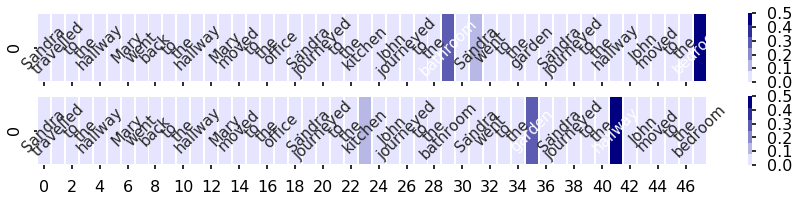

------------------------------
[2, 5, 23, 21, 20, 13, 4, 6, 22, 21, 20, 13, 4, 6, 22, 21, 20, 11, 4, 7, 23, 21, 20, 13, 4, 8, 18, 21, 20, 17, 4, 8, 23, 10, 21, 20, 12, 4, 6, 16, 21, 20, 19, 4, 8, 23, 21, 20, 19, 3]
Where is Mary
garden


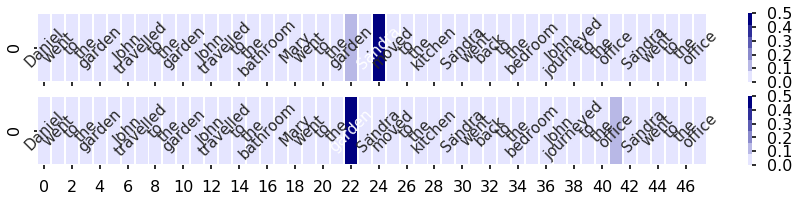

------------------------------
[2, 8, 18, 21, 20, 19, 4, 5, 18, 21, 20, 17, 4, 7, 18, 21, 20, 13, 4, 7, 16, 21, 20, 17, 4, 7, 18, 21, 20, 14, 4, 6, 23, 21, 20, 12, 4, 6, 18, 21, 20, 19, 4, 5, 23, 10, 21, 20, 14, 3]
Where is John
office


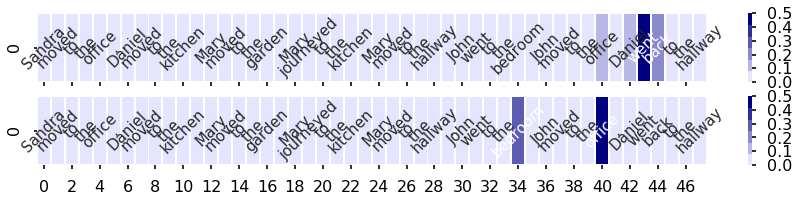

------------------------------
[2, 6, 22, 21, 20, 13, 4, 8, 22, 21, 20, 13, 4, 7, 16, 21, 20, 19, 4, 7, 23, 21, 20, 13, 4, 6, 23, 21, 20, 14, 4, 7, 23, 21, 20, 12, 4, 6, 23, 21, 20, 19, 4, 8, 23, 10, 21, 20, 17, 3]
Where is Sandra
kitchen


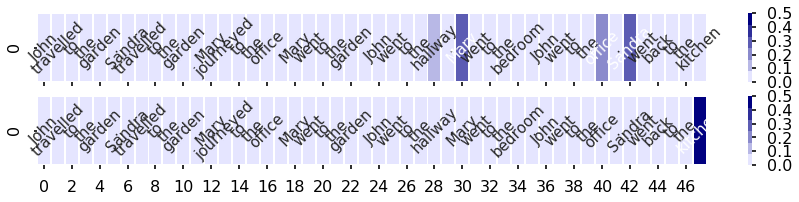

------------------------------
[2, 5, 22, 21, 20, 17, 4, 6, 16, 21, 20, 17, 4, 8, 18, 21, 20, 17, 4, 8, 23, 21, 20, 13, 4, 6, 22, 21, 20, 19, 4, 5, 23, 21, 20, 11, 4, 7, 23, 10, 21, 20, 17, 4, 5, 18, 21, 20, 17, 3]
Where is Sandra
garden


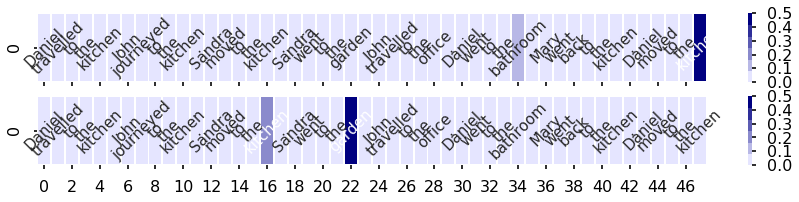

------------------------------
[2, 5, 23, 10, 21, 20, 14, 4, 7, 23, 21, 20, 11, 4, 6, 22, 21, 20, 14, 4, 7, 23, 21, 20, 19, 4, 8, 22, 21, 20, 11, 4, 8, 16, 21, 20, 14, 4, 5, 16, 21, 20, 11, 4, 5, 18, 21, 20, 12, 3]
Where is Sandra
hallway


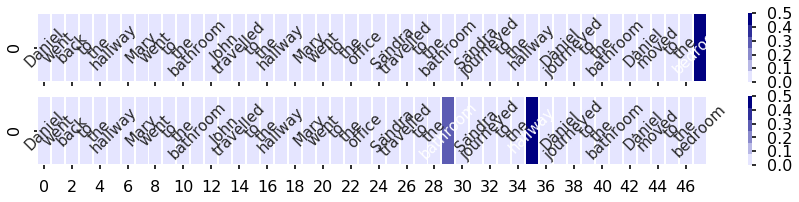

------------------------------
[2, 5, 23, 10, 21, 20, 14, 4, 5, 22, 21, 20, 13, 4, 8, 23, 21, 20, 19, 4, 8, 16, 21, 20, 17, 4, 6, 18, 21, 20, 19, 4, 5, 16, 21, 20, 11, 4, 6, 23, 21, 20, 11, 4, 7, 22, 21, 20, 13, 3]
Where is Sandra
kitchen


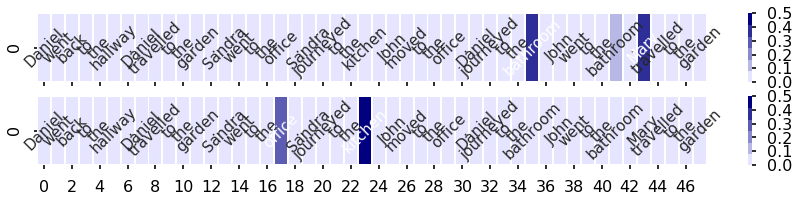

------------------------------
[2, 7, 22, 21, 20, 12, 4, 6, 23, 10, 21, 20, 14, 4, 6, 18, 21, 20, 11, 4, 8, 16, 21, 20, 13, 4, 5, 18, 21, 20, 17, 4, 6, 23, 21, 20, 14, 4, 8, 18, 21, 20, 14, 4, 6, 16, 21, 20, 11, 3]
Where is Sandra
hallway


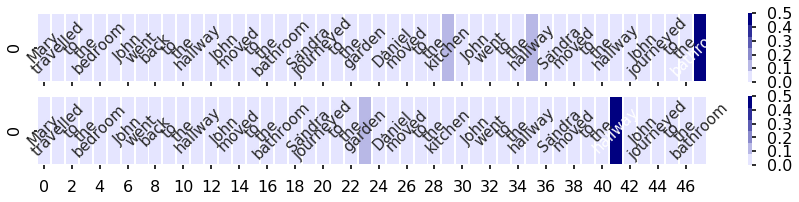

------------------------------
[2, 8, 18, 21, 20, 17, 4, 8, 23, 10, 21, 20, 11, 4, 7, 16, 21, 20, 12, 4, 6, 16, 21, 20, 11, 4, 8, 18, 21, 20, 12, 4, 8, 22, 21, 20, 14, 4, 8, 22, 21, 20, 13, 4, 8, 22, 21, 20, 11, 3]
Where is Sandra
bathroom


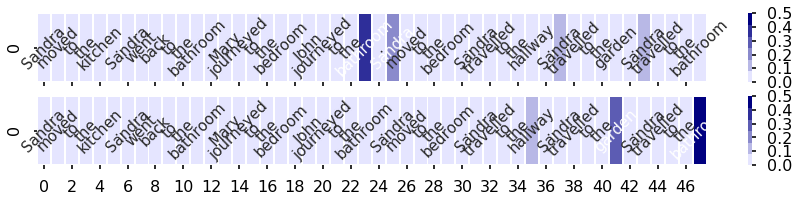

------------------------------
[2, 6, 18, 21, 20, 11, 4, 6, 22, 21, 20, 13, 4, 8, 22, 21, 20, 14, 4, 5, 18, 21, 20, 17, 4, 8, 16, 21, 20, 19, 4, 7, 18, 21, 20, 11, 4, 5, 23, 10, 21, 20, 14, 4, 7, 16, 21, 20, 17, 3]
Where is Sandra
office


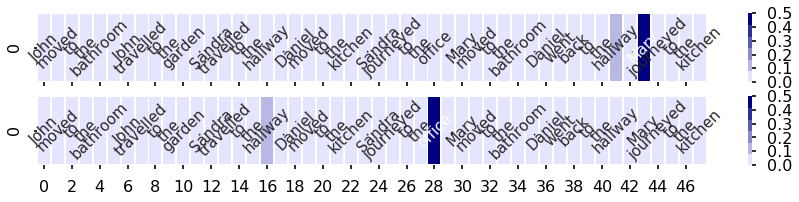

------------------------------
[2, 8, 23, 10, 21, 20, 12, 4, 6, 18, 21, 20, 13, 4, 5, 16, 21, 20, 14, 4, 8, 22, 21, 20, 14, 4, 5, 22, 21, 20, 11, 4, 7, 22, 21, 20, 13, 4, 5, 16, 21, 20, 13, 4, 5, 18, 21, 20, 11, 3]
Where is Mary
garden


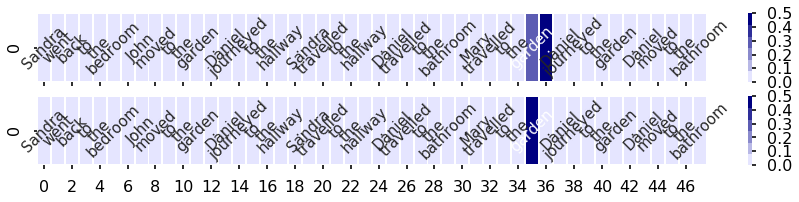

------------------------------
[2, 6, 23, 10, 21, 20, 11, 4, 6, 18, 21, 20, 17, 4, 8, 18, 21, 20, 19, 4, 8, 22, 21, 20, 12, 4, 6, 23, 21, 20, 13, 4, 8, 18, 21, 20, 17, 4, 8, 23, 21, 20, 13, 4, 5, 23, 21, 20, 17, 3]
Where is Sandra
garden


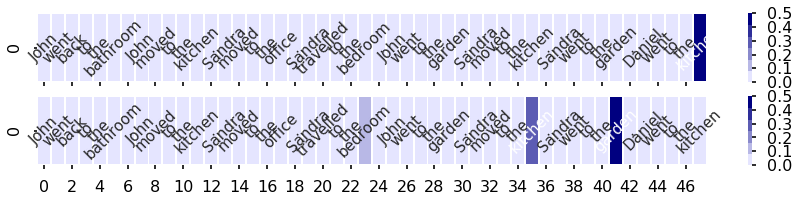

------------------------------
[2, 6, 16, 21, 20, 14, 4, 6, 16, 21, 20, 12, 4, 5, 16, 21, 20, 12, 4, 6, 16, 21, 20, 19, 4, 6, 18, 21, 20, 13, 4, 5, 18, 21, 20, 13, 4, 5, 23, 10, 21, 20, 17, 4, 7, 16, 21, 20, 14, 3]
Where is John
garden


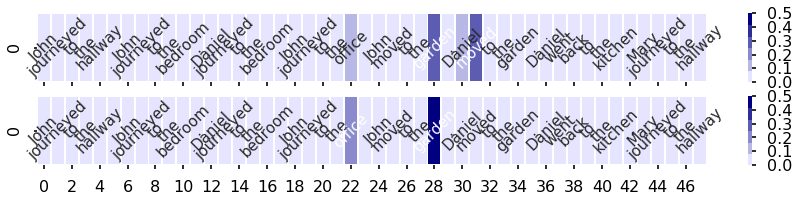

------------------------------
[2, 8, 18, 21, 20, 17, 4, 6, 22, 21, 20, 19, 4, 8, 23, 10, 21, 20, 13, 4, 6, 23, 21, 20, 13, 4, 5, 22, 21, 20, 13, 4, 8, 18, 21, 20, 14, 4, 5, 23, 21, 20, 17, 4, 5, 16, 21, 20, 19, 3]
Where is John
garden


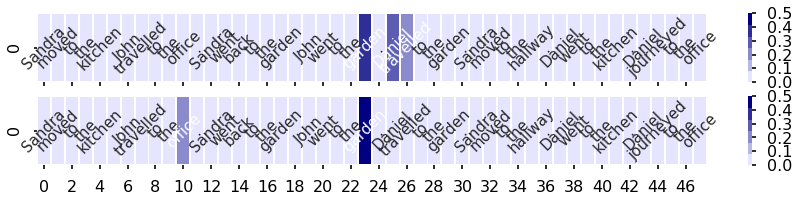

------------------------------
[2, 5, 18, 21, 20, 12, 4, 6, 18, 21, 20, 12, 4, 7, 23, 10, 21, 20, 12, 4, 7, 22, 21, 20, 19, 4, 7, 16, 21, 20, 12, 4, 6, 18, 21, 20, 13, 4, 5, 22, 21, 20, 19, 4, 8, 22, 21, 20, 11, 3]
Where is Mary
bedroom


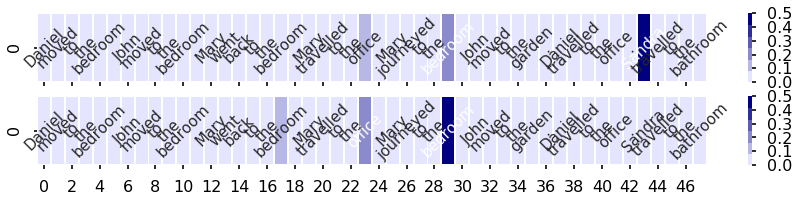

------------------------------
[2, 6, 22, 21, 20, 12, 4, 7, 23, 21, 20, 11, 4, 7, 16, 21, 20, 12, 4, 8, 22, 21, 20, 14, 4, 5, 23, 10, 21, 20, 14, 4, 8, 16, 21, 20, 19, 4, 6, 18, 21, 20, 13, 4, 7, 22, 21, 20, 19, 3]
Where is Sandra
office


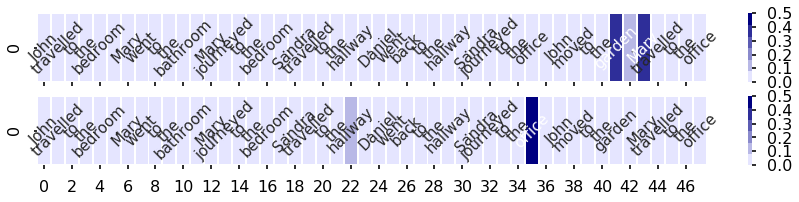

------------------------------
[2, 7, 16, 21, 20, 19, 4, 7, 16, 21, 20, 12, 4, 8, 23, 21, 20, 13, 4, 8, 18, 21, 20, 17, 4, 8, 23, 21, 20, 11, 4, 5, 18, 21, 20, 19, 4, 6, 23, 10, 21, 20, 19, 4, 6, 23, 21, 20, 13, 3]
Where is Sandra
bathroom


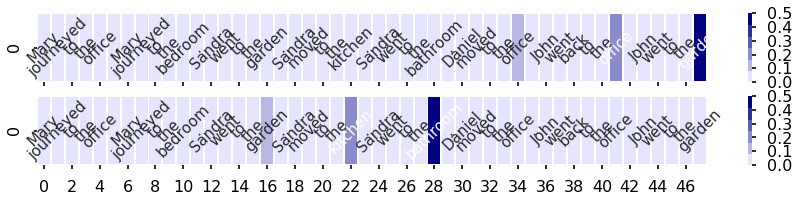

------------------------------
[2, 6, 22, 21, 20, 13, 4, 7, 16, 21, 20, 19, 4, 8, 23, 21, 20, 13, 4, 6, 23, 10, 21, 20, 19, 4, 6, 18, 21, 20, 12, 4, 6, 18, 21, 20, 13, 4, 7, 23, 10, 21, 20, 14, 4, 8, 22, 21, 20, 11, 3]
Where is Mary
hallway


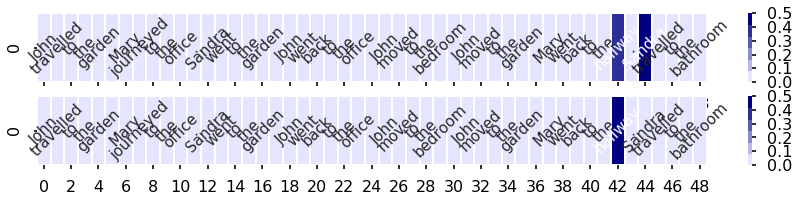

------------------------------
[2, 6, 23, 21, 20, 19, 4, 8, 23, 21, 20, 17, 4, 6, 23, 10, 21, 20, 17, 4, 7, 18, 21, 20, 13, 4, 7, 23, 21, 20, 17, 4, 8, 18, 21, 20, 12, 4, 8, 18, 21, 20, 14, 4, 6, 23, 10, 21, 20, 14, 3]
Where is Mary
kitchen


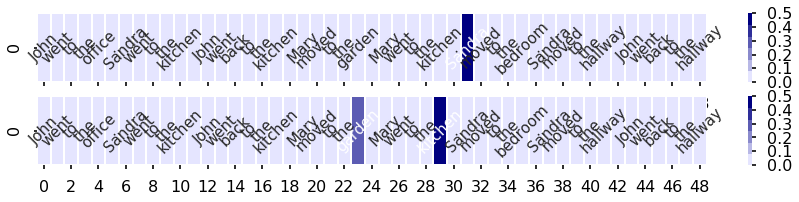

------------------------------
[2, 7, 18, 21, 20, 19, 4, 6, 18, 21, 20, 13, 4, 8, 18, 21, 20, 12, 4, 8, 23, 10, 21, 20, 19, 4, 6, 23, 21, 20, 12, 4, 6, 16, 21, 20, 13, 4, 5, 23, 10, 21, 20, 14, 4, 6, 16, 21, 20, 12, 3]
Where is Sandra
office


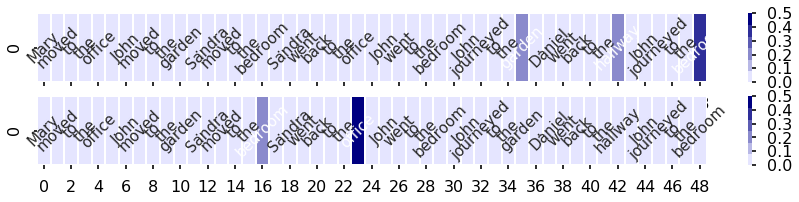

------------------------------
[2, 7, 16, 21, 20, 17, 4, 5, 18, 21, 20, 12, 4, 7, 23, 21, 20, 11, 4, 6, 23, 21, 20, 11, 4, 8, 23, 10, 21, 20, 12, 4, 6, 23, 10, 21, 20, 13, 4, 8, 22, 21, 20, 19, 4, 5, 23, 21, 20, 13, 3]
Where is Sandra
office


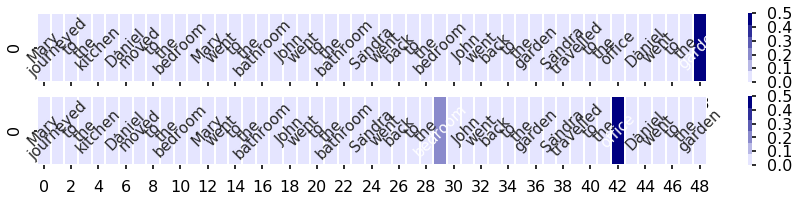

------------------------------
[2, 6, 23, 10, 21, 20, 12, 4, 6, 16, 21, 20, 13, 4, 5, 16, 21, 20, 11, 4, 8, 23, 10, 21, 20, 17, 4, 5, 22, 21, 20, 17, 4, 8, 23, 21, 20, 14, 4, 5, 23, 21, 20, 12, 4, 7, 18, 21, 20, 13, 3]
Where is Sandra
hallway


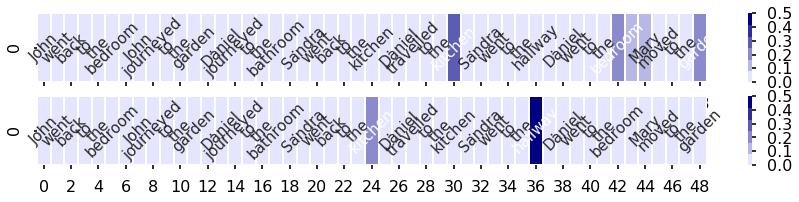

------------------------------
[2, 5, 23, 21, 20, 12, 4, 8, 23, 21, 20, 17, 4, 5, 18, 21, 20, 17, 4, 6, 23, 10, 21, 20, 12, 4, 5, 16, 21, 20, 12, 4, 5, 22, 21, 20, 17, 4, 8, 23, 10, 21, 20, 11, 4, 8, 23, 21, 20, 17, 3]
Where is Sandra
kitchen


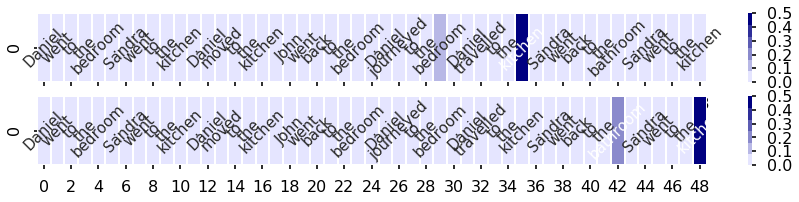

------------------------------
[2, 7, 23, 10, 21, 20, 12, 4, 7, 18, 21, 20, 19, 4, 7, 23, 10, 21, 20, 11, 4, 8, 18, 21, 20, 14, 4, 7, 23, 21, 20, 13, 4, 8, 23, 21, 20, 17, 4, 5, 16, 21, 20, 12, 4, 6, 16, 21, 20, 14, 3]
Where is Sandra
kitchen


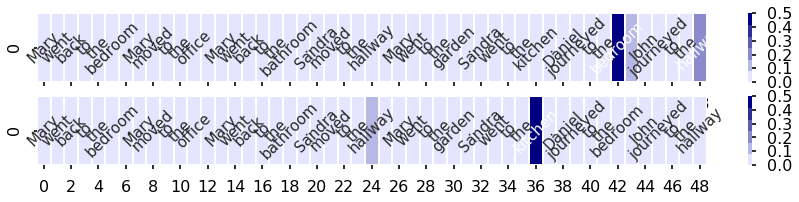

------------------------------
[2, 7, 16, 21, 20, 11, 4, 6, 23, 10, 21, 20, 13, 4, 7, 23, 21, 20, 19, 4, 6, 23, 10, 21, 20, 12, 4, 6, 16, 21, 20, 11, 4, 8, 16, 21, 20, 11, 4, 8, 18, 21, 20, 17, 4, 6, 23, 21, 20, 19, 3]
Where is Sandra
kitchen


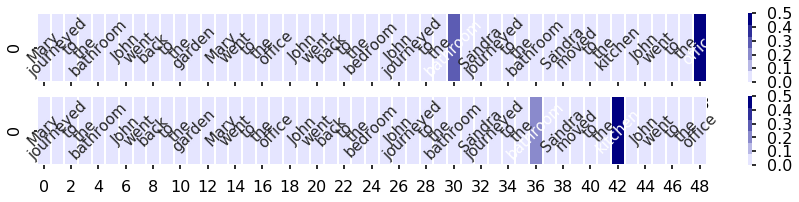

------------------------------
[2, 5, 22, 21, 20, 12, 4, 8, 18, 21, 20, 11, 4, 6, 23, 10, 21, 20, 12, 4, 8, 22, 21, 20, 17, 4, 8, 23, 10, 21, 20, 19, 4, 8, 18, 21, 20, 13, 4, 5, 23, 21, 20, 17, 4, 6, 22, 21, 20, 11, 3]
Where is Sandra
garden


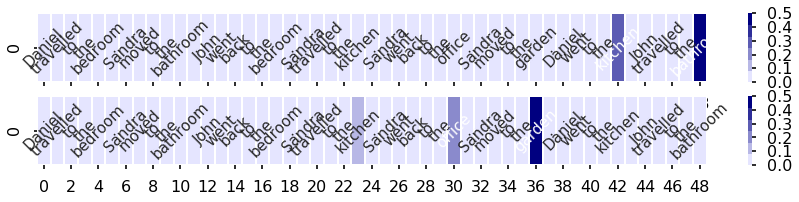

------------------------------
[2, 6, 16, 21, 20, 13, 4, 6, 22, 21, 20, 11, 4, 5, 23, 10, 21, 20, 13, 4, 5, 16, 21, 20, 17, 4, 8, 22, 21, 20, 17, 4, 8, 18, 21, 20, 14, 4, 8, 22, 21, 20, 12, 4, 6, 23, 10, 21, 20, 19, 3]
Where is Sandra
bedroom


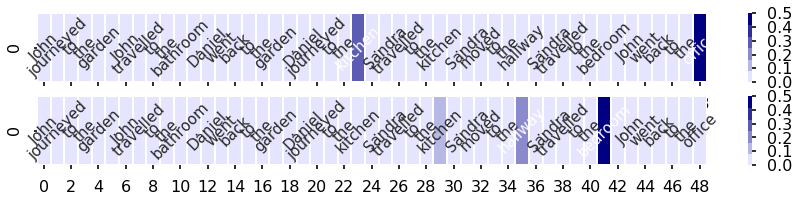

------------------------------
[2, 7, 18, 21, 20, 14, 4, 5, 22, 21, 20, 19, 4, 6, 23, 10, 21, 20, 14, 4, 6, 18, 21, 20, 19, 4, 8, 16, 21, 20, 17, 4, 7, 18, 21, 20, 12, 4, 6, 23, 10, 21, 20, 17, 4, 8, 23, 21, 20, 12, 3]
Where is Sandra
bedroom


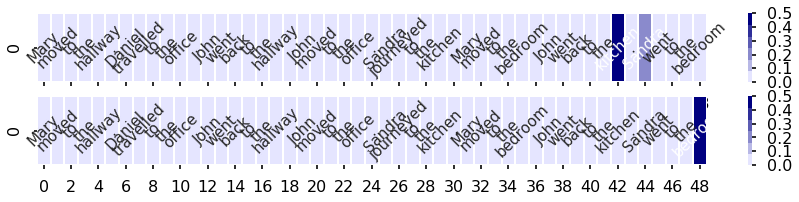

------------------------------
[2, 6, 23, 10, 21, 20, 19, 4, 5, 23, 21, 20, 11, 4, 6, 16, 21, 20, 17, 4, 7, 23, 21, 20, 11, 4, 8, 18, 21, 20, 13, 4, 5, 23, 10, 21, 20, 12, 4, 8, 18, 21, 20, 17, 4, 5, 22, 21, 20, 13, 3]
Where is Sandra
kitchen


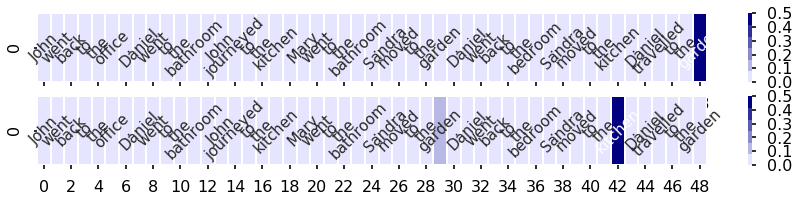

------------------------------
[2, 6, 23, 21, 20, 14, 4, 8, 22, 21, 20, 14, 4, 8, 22, 21, 20, 17, 4, 6, 23, 10, 21, 20, 17, 4, 6, 23, 10, 21, 20, 13, 4, 7, 18, 21, 20, 17, 4, 6, 18, 21, 20, 14, 4, 8, 23, 21, 20, 19, 3]
Where is Mary
kitchen


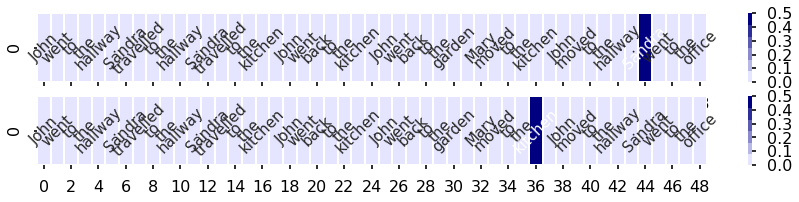

------------------------------
[2, 8, 18, 21, 20, 13, 4, 6, 16, 21, 20, 12, 4, 7, 23, 10, 21, 20, 12, 4, 8, 22, 21, 20, 19, 4, 6, 22, 21, 20, 11, 4, 7, 22, 21, 20, 13, 4, 7, 18, 21, 20, 17, 4, 8, 23, 10, 21, 20, 13, 3]
Where is Mary
kitchen


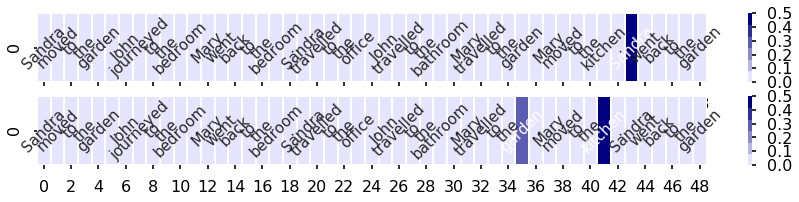

------------------------------
[2, 7, 22, 21, 20, 13, 4, 6, 23, 10, 21, 20, 17, 4, 8, 16, 21, 20, 19, 4, 8, 16, 21, 20, 14, 4, 6, 22, 21, 20, 11, 4, 8, 18, 21, 20, 19, 4, 8, 18, 21, 20, 17, 4, 5, 23, 10, 21, 20, 11, 3]
Where is Sandra
kitchen


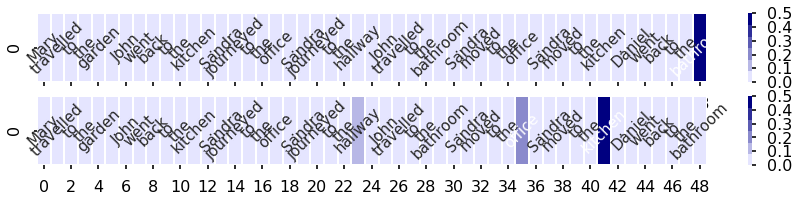

------------------------------
[2, 5, 22, 21, 20, 19, 4, 8, 23, 10, 21, 20, 19, 4, 7, 23, 21, 20, 19, 4, 5, 18, 21, 20, 11, 4, 6, 23, 21, 20, 14, 4, 8, 18, 21, 20, 12, 4, 8, 22, 21, 20, 19, 4, 6, 23, 10, 21, 20, 13, 3]
Where is Sandra
office


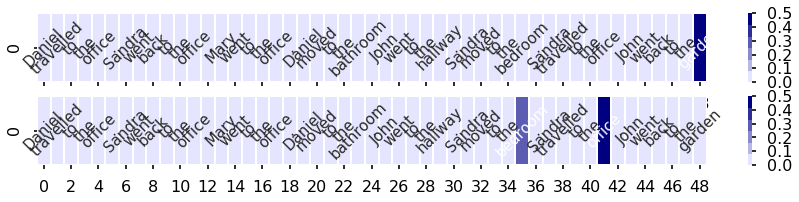

------------------------------
[2, 5, 16, 21, 20, 17, 4, 8, 23, 21, 20, 12, 4, 5, 23, 10, 21, 20, 14, 4, 7, 23, 10, 21, 20, 19, 4, 7, 23, 21, 20, 13, 4, 5, 16, 21, 20, 19, 4, 8, 23, 21, 20, 11, 4, 6, 22, 21, 20, 12, 3]
Where is Mary
garden


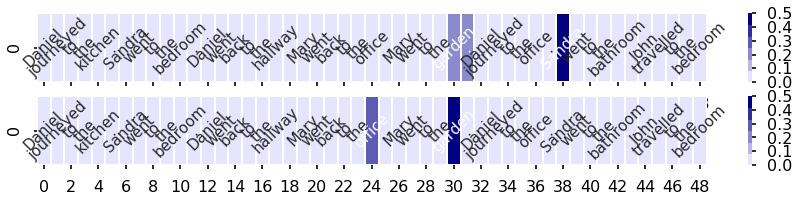

------------------------------
[2, 8, 16, 21, 20, 11, 4, 6, 18, 21, 20, 13, 4, 8, 23, 10, 21, 20, 13, 4, 5, 18, 21, 20, 17, 4, 8, 22, 21, 20, 12, 4, 6, 23, 21, 20, 11, 4, 5, 23, 10, 21, 20, 11, 4, 7, 16, 21, 20, 12, 3]
Where is John
bathroom


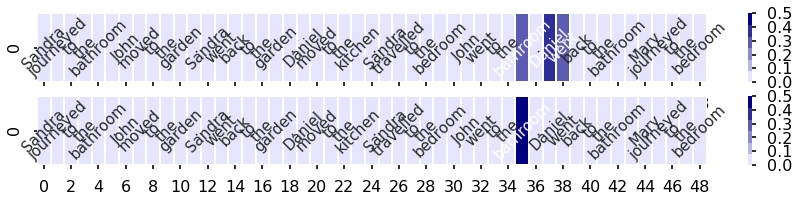

------------------------------
[2, 7, 22, 21, 20, 14, 4, 5, 16, 21, 20, 12, 4, 6, 23, 10, 21, 20, 13, 4, 8, 16, 21, 20, 11, 4, 6, 23, 21, 20, 17, 4, 8, 16, 21, 20, 13, 4, 8, 18, 21, 20, 14, 4, 6, 23, 10, 21, 20, 13, 3]
Where is Sandra
hallway


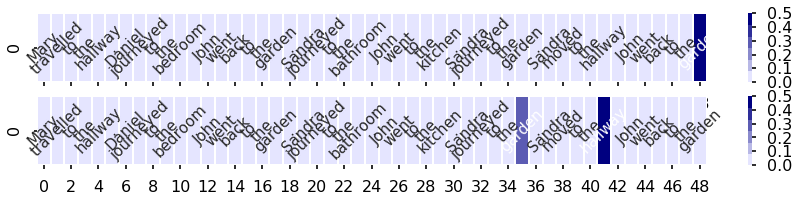

------------------------------
[2, 6, 16, 21, 20, 13, 4, 6, 22, 21, 20, 11, 4, 7, 18, 21, 20, 17, 4, 7, 23, 10, 21, 20, 12, 4, 6, 23, 21, 20, 14, 4, 6, 23, 21, 20, 17, 4, 7, 22, 21, 20, 17, 4, 8, 23, 10, 21, 20, 11, 3]
Where is Mary
kitchen


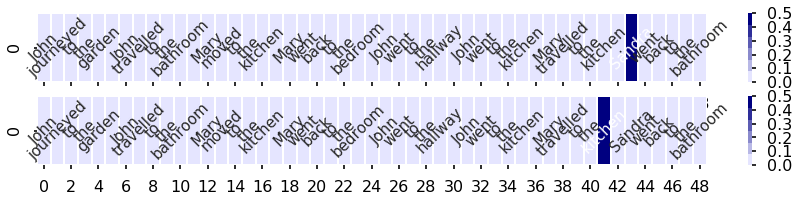

------------------------------
[2, 5, 23, 10, 21, 20, 12, 4, 7, 23, 21, 20, 13, 4, 8, 23, 21, 20, 17, 4, 8, 23, 10, 21, 20, 11, 4, 6, 16, 21, 20, 12, 4, 6, 23, 10, 21, 20, 14, 4, 8, 23, 21, 20, 17, 4, 7, 23, 21, 20, 11, 3]
Where is Sandra
kitchen


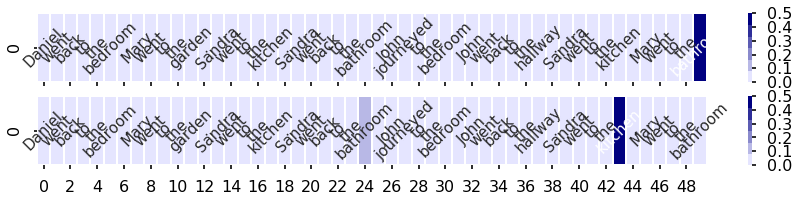

------------------------------
[2, 5, 16, 21, 20, 13, 4, 6, 18, 21, 20, 13, 4, 8, 18, 21, 20, 12, 4, 6, 23, 10, 21, 20, 19, 4, 6, 23, 10, 21, 20, 12, 4, 5, 23, 10, 21, 20, 12, 4, 6, 23, 21, 20, 19, 4, 8, 23, 21, 20, 13, 3]
Where is John
office


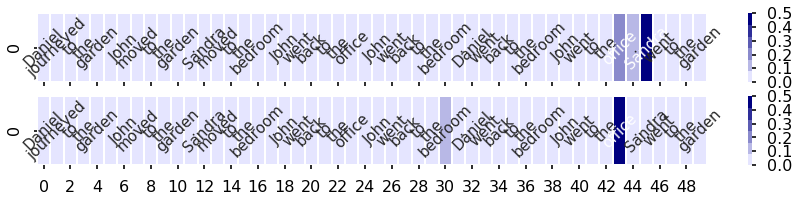

------------------------------
[2, 6, 18, 21, 20, 17, 4, 8, 22, 21, 20, 13, 4, 8, 23, 10, 21, 20, 11, 4, 8, 23, 10, 21, 20, 12, 4, 8, 16, 21, 20, 19, 4, 8, 22, 21, 20, 14, 4, 5, 23, 10, 21, 20, 14, 4, 5, 23, 21, 20, 13, 3]
Where is Sandra
hallway


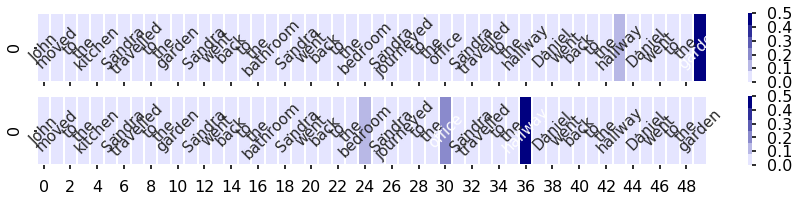

------------------------------
[2, 8, 23, 21, 20, 12, 4, 6, 22, 21, 20, 19, 4, 6, 22, 21, 20, 12, 4, 8, 23, 10, 21, 20, 17, 4, 8, 23, 10, 21, 20, 13, 4, 6, 23, 10, 21, 20, 19, 4, 5, 23, 21, 20, 14, 4, 5, 23, 21, 20, 11, 3]
Where is Sandra
garden


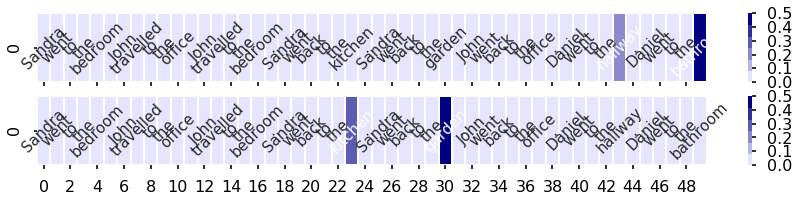

------------------------------
[2, 6, 16, 21, 20, 13, 4, 6, 23, 10, 21, 20, 12, 4, 5, 23, 10, 21, 20, 19, 4, 5, 23, 21, 20, 12, 4, 8, 16, 21, 20, 19, 4, 5, 23, 10, 21, 20, 14, 4, 5, 23, 21, 20, 12, 4, 6, 18, 21, 20, 11, 3]
Where is Sandra
office


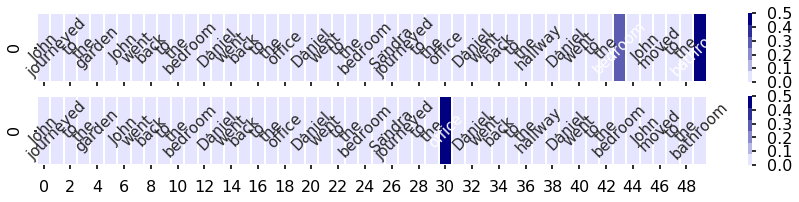

------------------------------
[2, 5, 23, 10, 21, 20, 19, 4, 8, 18, 21, 20, 11, 4, 8, 22, 21, 20, 17, 4, 7, 23, 21, 20, 17, 4, 5, 22, 21, 20, 11, 4, 5, 23, 10, 21, 20, 14, 4, 5, 22, 21, 20, 12, 4, 8, 23, 10, 21, 20, 19, 3]
Where is Mary
kitchen


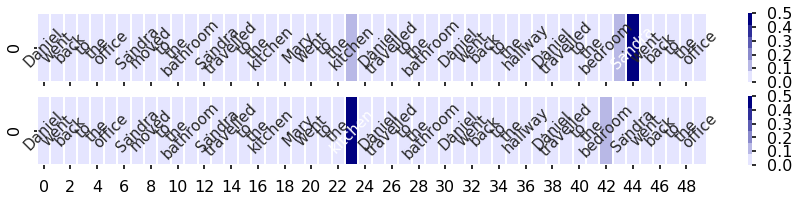

------------------------------
[2, 8, 23, 10, 21, 20, 12, 4, 7, 16, 21, 20, 13, 4, 6, 16, 21, 20, 17, 4, 8, 23, 21, 20, 19, 4, 6, 18, 21, 20, 14, 4, 8, 23, 10, 21, 20, 13, 4, 6, 23, 10, 21, 20, 17, 4, 5, 16, 21, 20, 12, 3]
Where is Sandra
garden


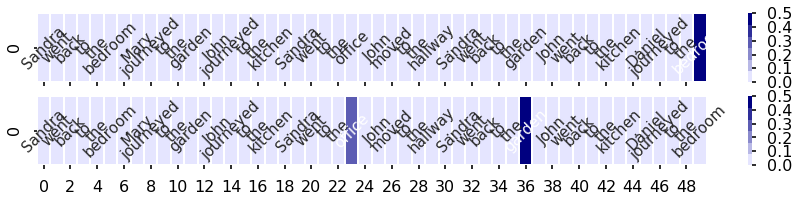

------------------------------
[2, 5, 23, 10, 21, 20, 14, 4, 7, 23, 10, 21, 20, 19, 4, 7, 23, 21, 20, 13, 4, 7, 23, 10, 21, 20, 17, 4, 8, 18, 21, 20, 12, 4, 6, 22, 21, 20, 14, 4, 8, 23, 10, 21, 20, 13, 4, 6, 16, 21, 20, 17, 3]
Where is Mary
kitchen


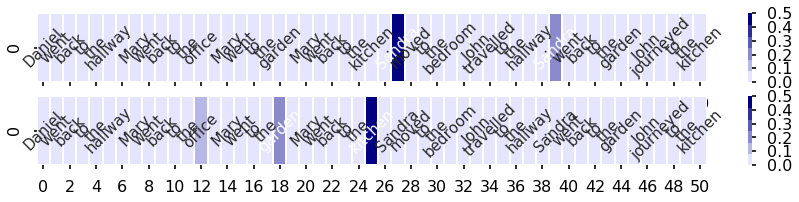

------------------------------
[2, 7, 22, 21, 20, 11, 4, 5, 23, 10, 21, 20, 14, 4, 8, 23, 10, 21, 20, 19, 4, 8, 23, 10, 21, 20, 14, 4, 6, 23, 10, 21, 20, 11, 4, 5, 23, 21, 20, 17, 4, 6, 18, 21, 20, 17, 4, 5, 23, 21, 20, 12, 3]
Where is Sandra
hallway


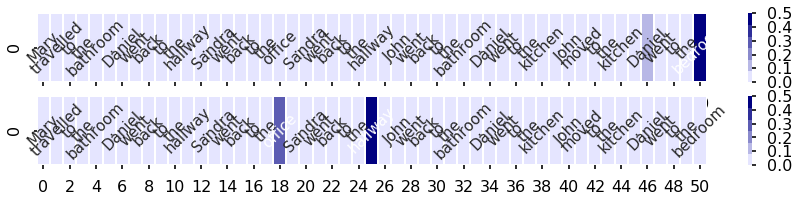

------------------------------
[2, 6, 22, 21, 20, 19, 4, 7, 16, 21, 20, 17, 4, 7, 18, 21, 20, 13, 4, 5, 23, 21, 20, 19, 4, 6, 23, 21, 20, 14, 4, 7, 18, 21, 20, 17, 4, 7, 22, 21, 20, 12, 4, 5, 16, 21, 20, 13, 4, 6, 16, 21, 20, 13, 4, 8, 16, 21, 20, 12, 3]
Where is Mary
bedroom


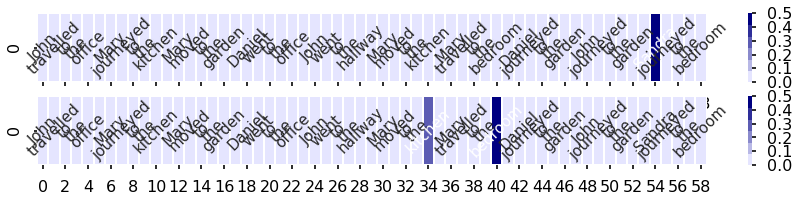

------------------------------
[2, 6, 18, 21, 20, 14, 4, 6, 16, 21, 20, 17, 4, 8, 22, 21, 20, 13, 4, 6, 16, 21, 20, 13, 4, 5, 16, 21, 20, 19, 4, 6, 23, 21, 20, 17, 4, 8, 16, 21, 20, 14, 4, 7, 23, 21, 20, 14, 4, 7, 23, 21, 20, 17, 4, 8, 22, 21, 20, 13, 3]
Where is John
kitchen


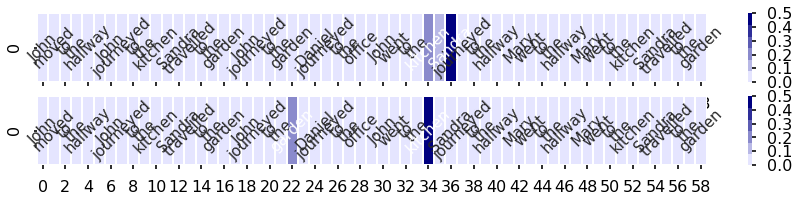

------------------------------
[2, 6, 22, 21, 20, 19, 4, 7, 23, 21, 20, 11, 4, 7, 23, 21, 20, 17, 4, 7, 16, 21, 20, 11, 4, 7, 23, 21, 20, 14, 4, 8, 22, 21, 20, 12, 4, 6, 18, 21, 20, 17, 4, 8, 16, 21, 20, 13, 4, 7, 23, 21, 20, 19, 4, 5, 22, 21, 20, 14, 3]
Where is Sandra
garden


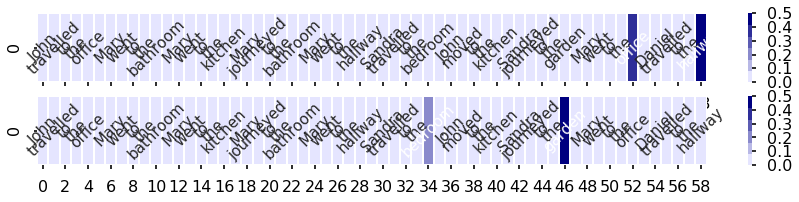

------------------------------
[2, 8, 16, 21, 20, 17, 4, 5, 16, 21, 20, 11, 4, 7, 23, 21, 20, 13, 4, 7, 22, 21, 20, 19, 4, 8, 22, 21, 20, 12, 4, 6, 22, 21, 20, 19, 4, 8, 16, 21, 20, 19, 4, 8, 18, 21, 20, 17, 4, 7, 22, 21, 20, 12, 4, 7, 18, 21, 20, 14, 3]
Where is Sandra
kitchen


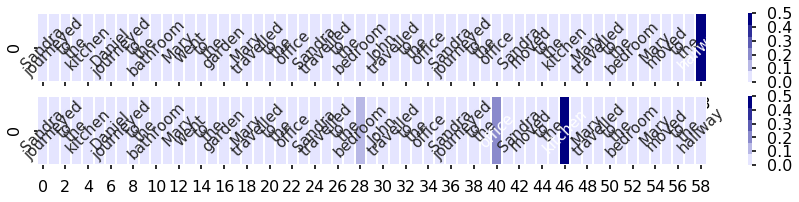

------------------------------
[2, 5, 23, 21, 20, 14, 4, 6, 22, 21, 20, 11, 4, 5, 18, 21, 20, 12, 4, 5, 23, 21, 20, 11, 4, 8, 22, 21, 20, 13, 4, 8, 23, 21, 20, 14, 4, 5, 16, 21, 20, 19, 4, 6, 18, 21, 20, 13, 4, 5, 23, 10, 21, 20, 14, 4, 6, 18, 21, 20, 12, 3]
Where is Sandra
hallway


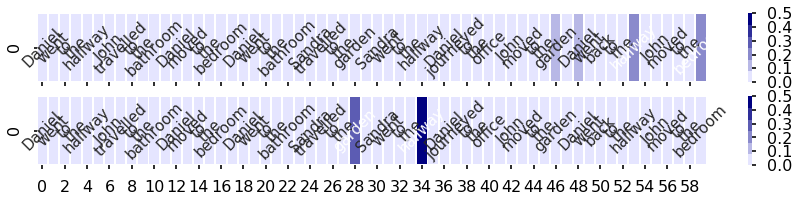

------------------------------
[2, 7, 23, 21, 20, 13, 4, 8, 16, 21, 20, 13, 4, 7, 16, 21, 20, 11, 4, 5, 23, 21, 20, 19, 4, 6, 23, 10, 21, 20, 13, 4, 6, 22, 21, 20, 19, 4, 6, 18, 21, 20, 12, 4, 6, 22, 21, 20, 17, 4, 7, 22, 21, 20, 17, 4, 5, 16, 21, 20, 11, 3]
Where is John
kitchen


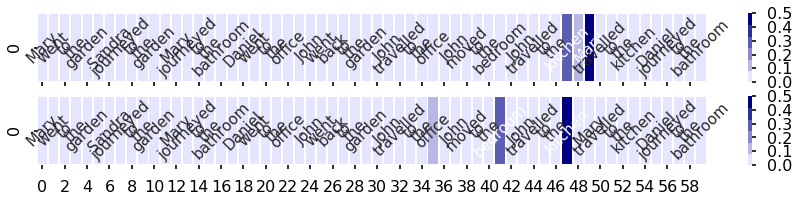

------------------------------
[2, 5, 23, 10, 21, 20, 19, 4, 5, 22, 21, 20, 11, 4, 7, 18, 21, 20, 14, 4, 7, 18, 21, 20, 19, 4, 6, 16, 21, 20, 17, 4, 6, 16, 21, 20, 13, 4, 6, 18, 21, 20, 14, 4, 8, 23, 21, 20, 13, 4, 5, 18, 21, 20, 17, 4, 6, 18, 21, 20, 11, 3]
Where is Sandra
garden


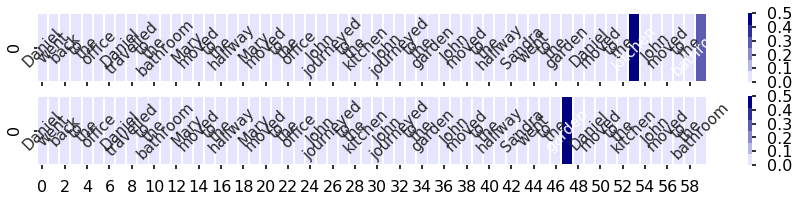

------------------------------
[2, 5, 16, 21, 20, 17, 4, 5, 16, 21, 20, 19, 4, 7, 22, 21, 20, 14, 4, 6, 18, 21, 20, 13, 4, 7, 22, 21, 20, 19, 4, 7, 22, 21, 20, 13, 4, 6, 22, 21, 20, 14, 4, 8, 23, 10, 21, 20, 11, 4, 7, 18, 21, 20, 14, 4, 5, 18, 21, 20, 12, 3]
Where is Sandra
bathroom


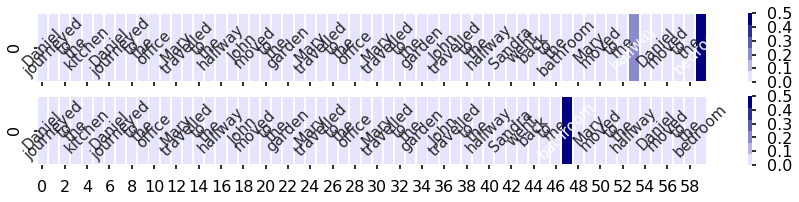

------------------------------
[2, 8, 23, 21, 20, 17, 4, 8, 23, 21, 20, 19, 4, 8, 22, 21, 20, 14, 4, 8, 23, 10, 21, 20, 17, 4, 7, 22, 21, 20, 14, 4, 8, 23, 21, 20, 12, 4, 6, 23, 21, 20, 13, 4, 8, 22, 21, 20, 19, 4, 6, 16, 21, 20, 19, 4, 5, 16, 21, 20, 17, 3]
Where is Sandra
office


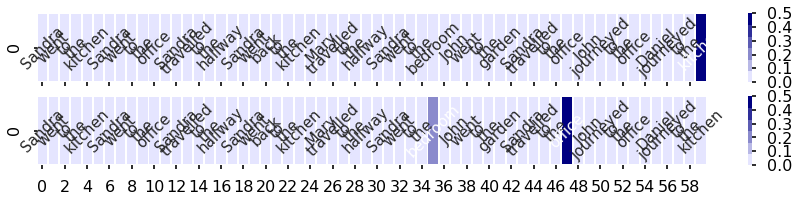

------------------------------
[2, 8, 22, 21, 20, 14, 4, 7, 23, 10, 21, 20, 14, 4, 7, 18, 21, 20, 19, 4, 8, 16, 21, 20, 17, 4, 6, 16, 21, 20, 11, 4, 8, 23, 21, 20, 13, 4, 8, 16, 21, 20, 14, 4, 6, 18, 21, 20, 12, 4, 6, 22, 21, 20, 14, 4, 6, 16, 21, 20, 19, 3]
Where is Sandra
hallway


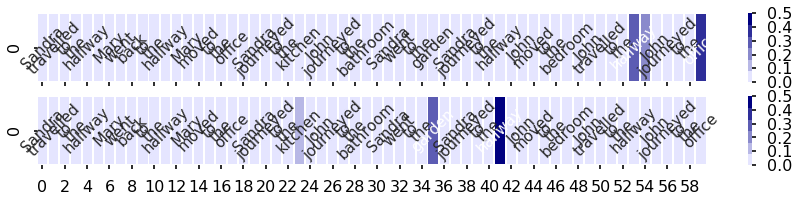

------------------------------
[2, 5, 23, 10, 21, 20, 12, 4, 8, 23, 21, 20, 13, 4, 8, 18, 21, 20, 17, 4, 6, 22, 21, 20, 14, 4, 5, 18, 21, 20, 17, 4, 6, 16, 21, 20, 17, 4, 5, 16, 21, 20, 14, 4, 8, 23, 21, 20, 19, 4, 7, 16, 21, 20, 19, 4, 5, 22, 21, 20, 13, 3]
Where is Sandra
office


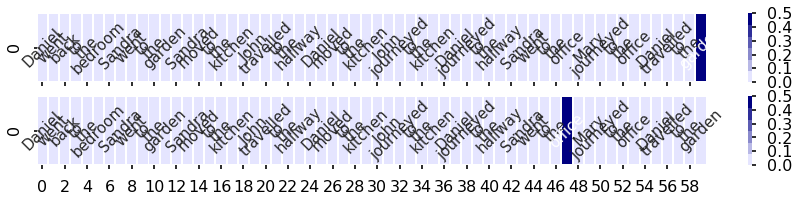

------------------------------
[2, 7, 23, 10, 21, 20, 12, 4, 8, 18, 21, 20, 13, 4, 5, 16, 21, 20, 11, 4, 7, 22, 21, 20, 19, 4, 5, 23, 21, 20, 14, 4, 8, 22, 21, 20, 14, 4, 6, 16, 21, 20, 13, 4, 6, 16, 21, 20, 19, 4, 5, 18, 21, 20, 13, 4, 7, 22, 21, 20, 11, 3]
Where is John
office


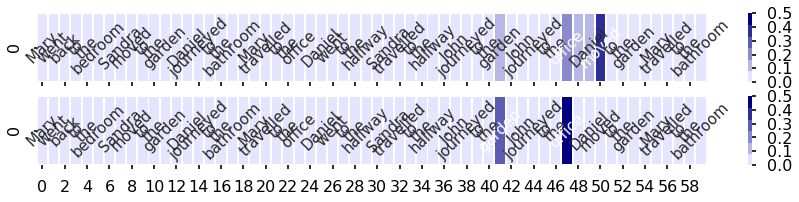

------------------------------
[2, 8, 16, 21, 20, 13, 4, 5, 16, 21, 20, 13, 4, 6, 16, 21, 20, 12, 4, 5, 16, 21, 20, 19, 4, 7, 16, 21, 20, 13, 4, 8, 22, 21, 20, 14, 4, 6, 22, 21, 20, 13, 4, 8, 22, 21, 20, 12, 4, 7, 18, 21, 20, 14, 4, 7, 23, 10, 21, 20, 17, 3]
Where is John
garden


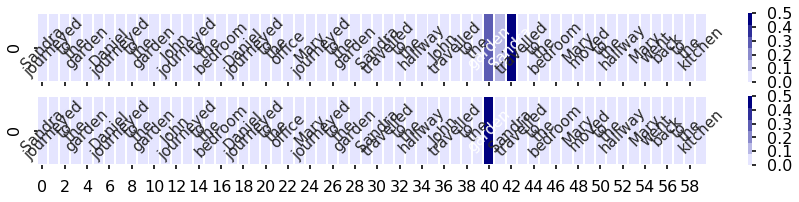

------------------------------
[2, 7, 18, 21, 20, 11, 4, 7, 23, 21, 20, 14, 4, 5, 22, 21, 20, 12, 4, 7, 16, 21, 20, 13, 4, 6, 22, 21, 20, 19, 4, 5, 22, 21, 20, 19, 4, 7, 23, 21, 20, 12, 4, 8, 23, 10, 21, 20, 17, 4, 8, 16, 21, 20, 12, 4, 8, 23, 21, 20, 13, 3]
Where is Sandra
garden


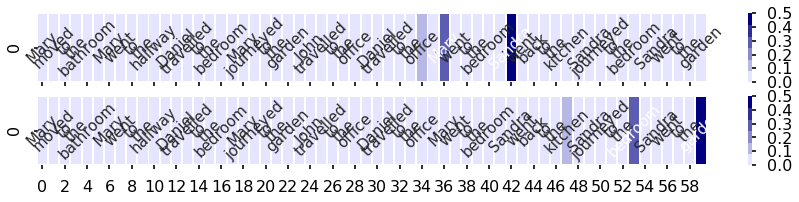

------------------------------
[2, 8, 22, 21, 20, 12, 4, 6, 22, 21, 20, 13, 4, 7, 23, 21, 20, 14, 4, 7, 23, 10, 21, 20, 12, 4, 8, 23, 21, 20, 17, 4, 8, 16, 21, 20, 13, 4, 5, 16, 21, 20, 19, 4, 8, 18, 21, 20, 12, 4, 7, 18, 21, 20, 17, 4, 7, 23, 21, 20, 11, 3]
Where is Sandra
bedroom


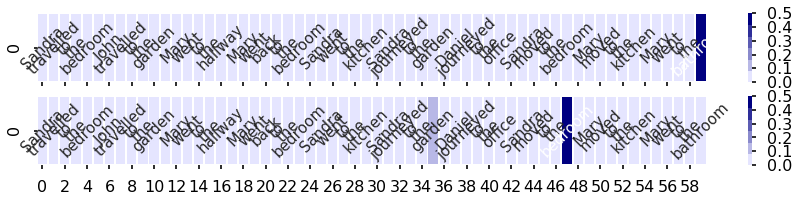

------------------------------
[2, 5, 22, 21, 20, 13, 4, 8, 16, 21, 20, 12, 4, 5, 16, 21, 20, 19, 4, 5, 22, 21, 20, 11, 4, 8, 22, 21, 20, 17, 4, 5, 23, 21, 20, 14, 4, 5, 23, 10, 21, 20, 13, 4, 8, 18, 21, 20, 13, 4, 7, 18, 21, 20, 12, 4, 8, 18, 21, 20, 17, 3]
Where is Sandra
kitchen


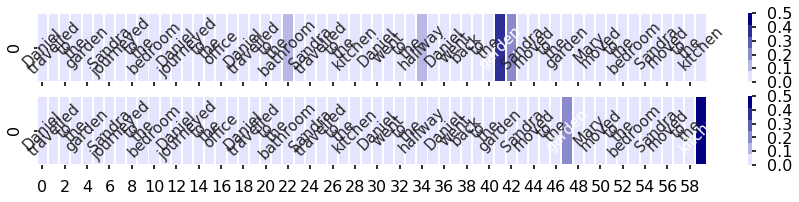

------------------------------
[2, 7, 16, 21, 20, 19, 4, 7, 16, 21, 20, 12, 4, 8, 23, 21, 20, 13, 4, 8, 18, 21, 20, 17, 4, 8, 23, 21, 20, 11, 4, 5, 18, 21, 20, 19, 4, 6, 23, 10, 21, 20, 19, 4, 6, 23, 21, 20, 13, 4, 6, 23, 21, 20, 12, 4, 7, 18, 21, 20, 13, 3]
Where is John
bedroom


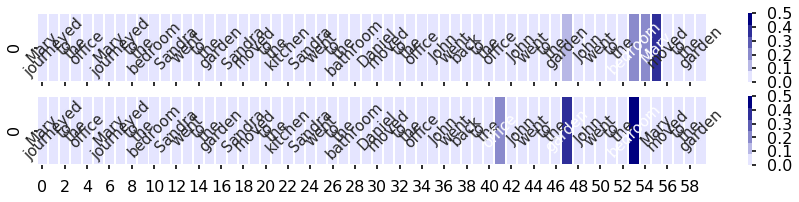

------------------------------
[2, 6, 22, 21, 20, 17, 4, 8, 18, 21, 20, 11, 4, 5, 18, 21, 20, 17, 4, 8, 18, 21, 20, 17, 4, 5, 23, 21, 20, 14, 4, 6, 23, 21, 20, 19, 4, 8, 23, 10, 21, 20, 13, 4, 8, 23, 21, 20, 12, 4, 6, 23, 21, 20, 12, 4, 6, 16, 21, 20, 11, 3]
Where is Sandra
bedroom


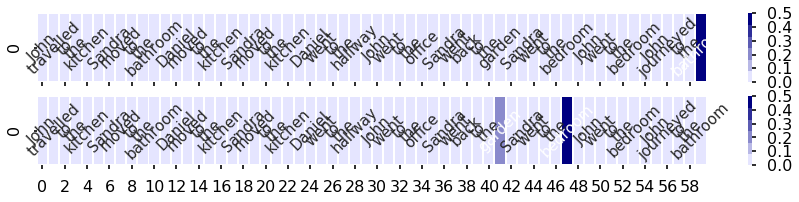

------------------------------
[2, 5, 18, 21, 20, 17, 4, 8, 22, 21, 20, 11, 4, 8, 22, 21, 20, 19, 4, 5, 16, 21, 20, 19, 4, 8, 23, 10, 21, 20, 12, 4, 6, 18, 21, 20, 17, 4, 8, 22, 21, 20, 11, 4, 6, 18, 21, 20, 11, 4, 7, 18, 21, 20, 13, 4, 5, 16, 21, 20, 11, 3]
Where is John
bathroom


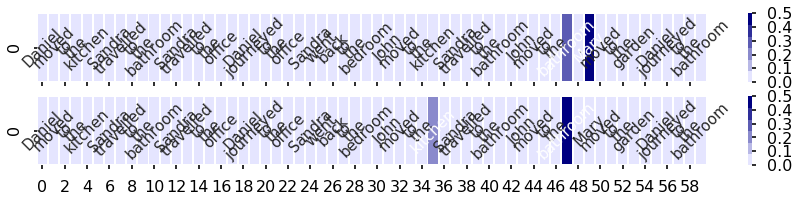

------------------------------
[2, 5, 23, 10, 21, 20, 14, 4, 7, 23, 21, 20, 11, 4, 6, 22, 21, 20, 14, 4, 7, 23, 21, 20, 19, 4, 8, 22, 21, 20, 11, 4, 8, 16, 21, 20, 14, 4, 5, 16, 21, 20, 11, 4, 5, 18, 21, 20, 12, 4, 7, 16, 21, 20, 14, 4, 5, 22, 21, 20, 11, 3]
Where is Sandra
hallway


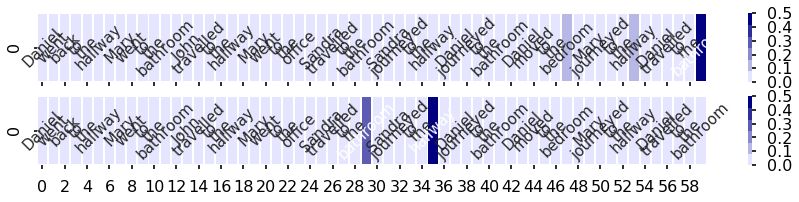

------------------------------
[2, 7, 23, 21, 20, 12, 4, 5, 16, 21, 20, 11, 4, 7, 22, 21, 20, 17, 4, 5, 18, 21, 20, 13, 4, 8, 22, 21, 20, 12, 4, 7, 16, 21, 20, 14, 4, 8, 23, 10, 21, 20, 19, 4, 8, 23, 21, 20, 17, 4, 8, 23, 21, 20, 14, 4, 6, 18, 21, 20, 19, 3]
Where is Sandra
hallway


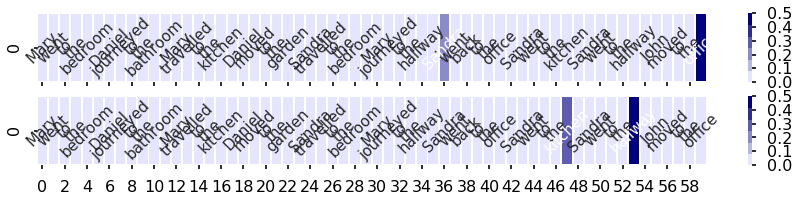

------------------------------
[2, 8, 18, 21, 20, 17, 4, 8, 23, 10, 21, 20, 11, 4, 7, 16, 21, 20, 12, 4, 6, 16, 21, 20, 11, 4, 8, 18, 21, 20, 12, 4, 8, 22, 21, 20, 14, 4, 8, 22, 21, 20, 13, 4, 8, 22, 21, 20, 11, 4, 5, 16, 21, 20, 17, 4, 6, 16, 21, 20, 19, 3]
Where is Sandra
bathroom


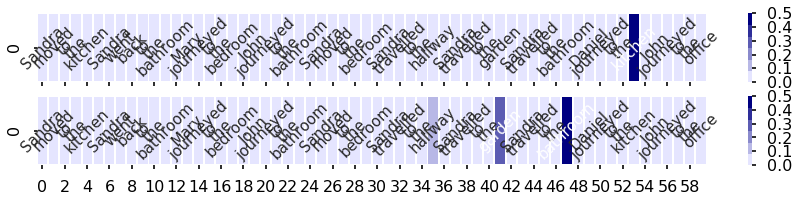

------------------------------
[2, 6, 22, 21, 20, 17, 4, 8, 18, 21, 20, 17, 4, 5, 23, 21, 20, 17, 4, 6, 16, 21, 20, 14, 4, 7, 16, 21, 20, 12, 4, 7, 16, 21, 20, 17, 4, 7, 22, 21, 20, 12, 4, 8, 22, 21, 20, 12, 4, 6, 23, 21, 20, 19, 4, 6, 23, 10, 21, 20, 17, 3]
Where is Mary
bedroom


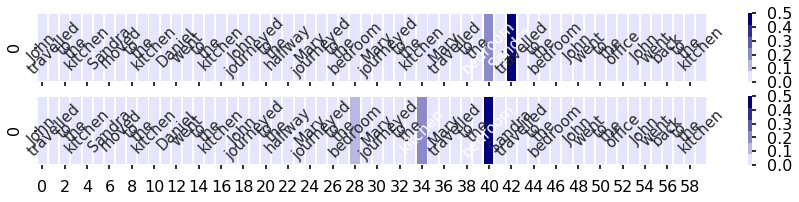

------------------------------
[2, 5, 23, 21, 20, 19, 4, 5, 22, 21, 20, 11, 4, 6, 22, 21, 20, 17, 4, 6, 23, 21, 20, 12, 4, 6, 23, 21, 20, 19, 4, 6, 16, 21, 20, 17, 4, 7, 18, 21, 20, 17, 4, 6, 23, 10, 21, 20, 14, 4, 8, 23, 21, 20, 11, 4, 8, 18, 21, 20, 19, 3]
Where is Mary
kitchen


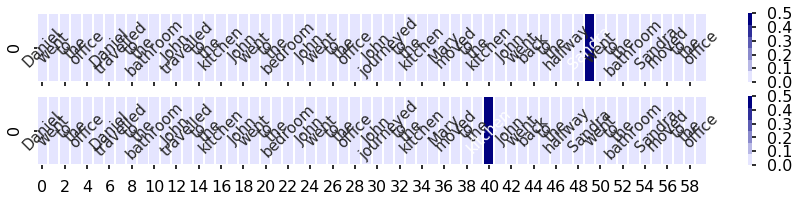

------------------------------
[2, 6, 18, 21, 20, 17, 4, 8, 22, 21, 20, 19, 4, 5, 23, 21, 20, 13, 4, 6, 16, 21, 20, 13, 4, 8, 18, 21, 20, 17, 4, 6, 23, 10, 21, 20, 19, 4, 7, 18, 21, 20, 12, 4, 8, 22, 21, 20, 13, 4, 8, 18, 21, 20, 11, 4, 7, 16, 21, 20, 13, 3]
Where is Sandra
bathroom


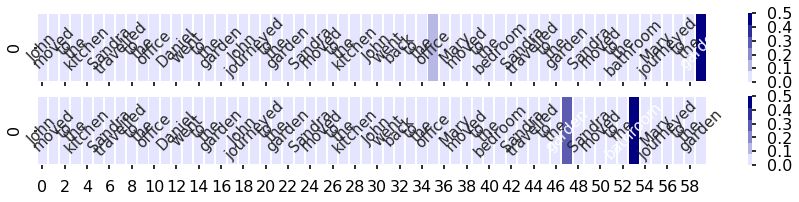

------------------------------
[2, 5, 22, 21, 20, 13, 4, 7, 23, 21, 20, 17, 4, 6, 22, 21, 20, 12, 4, 5, 16, 21, 20, 14, 4, 7, 18, 21, 20, 11, 4, 6, 22, 21, 20, 13, 4, 8, 23, 10, 21, 20, 14, 4, 7, 22, 21, 20, 12, 4, 8, 16, 21, 20, 19, 4, 7, 23, 10, 21, 20, 11, 3]
Where is Sandra
office


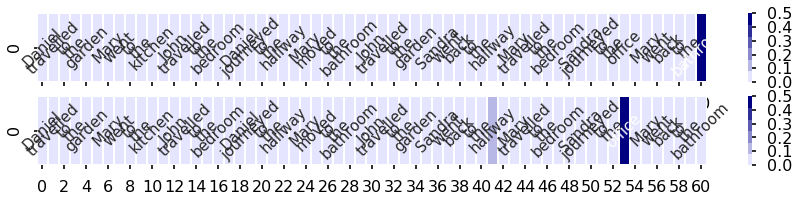

------------------------------
[2, 6, 16, 21, 20, 19, 4, 8, 22, 21, 20, 13, 4, 8, 18, 21, 20, 19, 4, 5, 22, 21, 20, 14, 4, 6, 22, 21, 20, 11, 4, 5, 16, 21, 20, 13, 4, 8, 16, 21, 20, 17, 4, 8, 23, 10, 21, 20, 14, 4, 7, 16, 21, 20, 12, 4, 7, 23, 10, 21, 20, 19, 3]
Where is Sandra
hallway


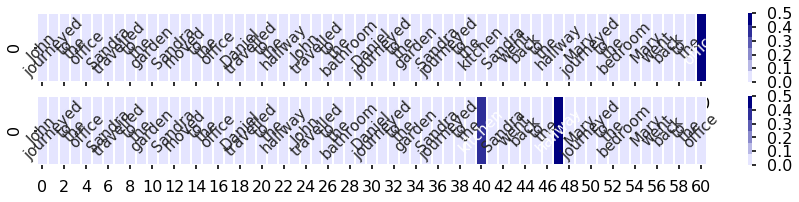

------------------------------
[2, 5, 23, 10, 21, 20, 13, 4, 7, 22, 21, 20, 19, 4, 5, 23, 10, 21, 20, 12, 4, 7, 16, 21, 20, 11, 4, 5, 16, 21, 20, 11, 4, 8, 23, 21, 20, 17, 4, 6, 18, 21, 20, 11, 4, 7, 23, 21, 20, 14, 4, 5, 18, 21, 20, 19, 4, 6, 22, 21, 20, 17, 3]
Where is Sandra
kitchen


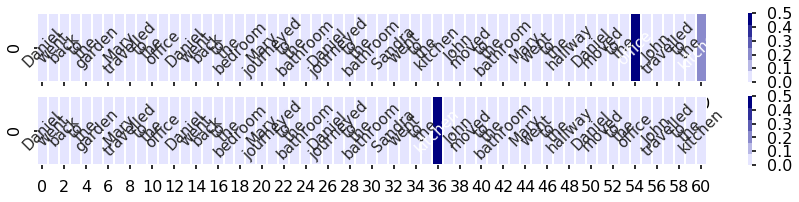

------------------------------
[2, 7, 16, 21, 20, 14, 4, 8, 16, 21, 20, 13, 4, 6, 23, 10, 21, 20, 12, 4, 8, 23, 10, 21, 20, 19, 4, 8, 22, 21, 20, 11, 4, 6, 16, 21, 20, 17, 4, 8, 18, 21, 20, 13, 4, 7, 23, 21, 20, 12, 4, 5, 16, 21, 20, 13, 4, 8, 16, 21, 20, 12, 3]
Where is John
kitchen


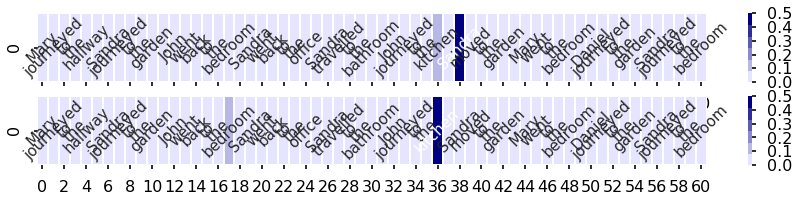

------------------------------
[2, 7, 18, 21, 20, 14, 4, 5, 22, 21, 20, 19, 4, 6, 23, 10, 21, 20, 14, 4, 6, 18, 21, 20, 19, 4, 8, 16, 21, 20, 17, 4, 7, 18, 21, 20, 12, 4, 6, 23, 10, 21, 20, 17, 4, 8, 23, 21, 20, 12, 4, 8, 22, 21, 20, 14, 4, 5, 23, 21, 20, 12, 3]
Where is Sandra
hallway


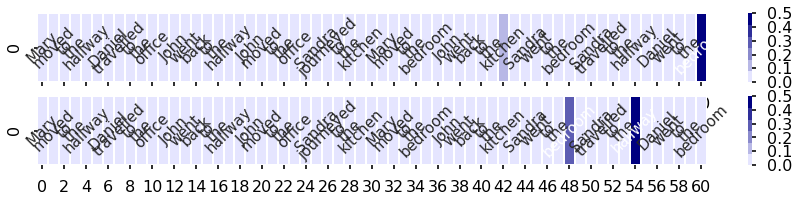

------------------------------
[2, 5, 23, 21, 20, 13, 4, 7, 18, 21, 20, 12, 4, 5, 16, 21, 20, 11, 4, 8, 16, 21, 20, 11, 4, 5, 18, 21, 20, 14, 4, 8, 16, 21, 20, 17, 4, 8, 18, 21, 20, 19, 4, 5, 22, 21, 20, 12, 4, 7, 23, 10, 21, 20, 19, 4, 5, 23, 10, 21, 20, 17, 3]
Where is Sandra
office


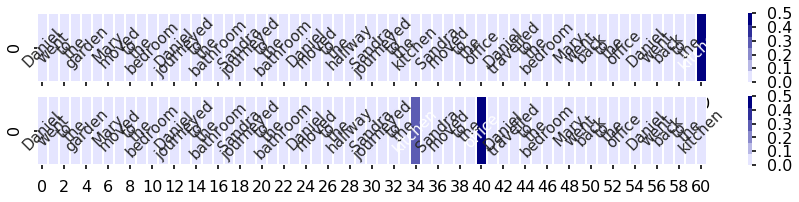

------------------------------
[2, 5, 16, 21, 20, 17, 4, 8, 23, 21, 20, 12, 4, 5, 23, 10, 21, 20, 14, 4, 7, 23, 10, 21, 20, 19, 4, 7, 23, 21, 20, 13, 4, 5, 16, 21, 20, 19, 4, 8, 23, 21, 20, 11, 4, 6, 22, 21, 20, 12, 4, 8, 23, 21, 20, 17, 4, 5, 22, 21, 20, 12, 3]
Where is Sandra
kitchen


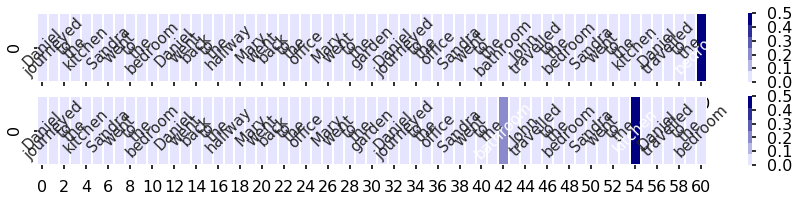

------------------------------
[2, 7, 22, 21, 20, 14, 4, 5, 16, 21, 20, 12, 4, 6, 23, 10, 21, 20, 13, 4, 8, 16, 21, 20, 11, 4, 6, 23, 21, 20, 17, 4, 8, 16, 21, 20, 13, 4, 8, 18, 21, 20, 14, 4, 6, 23, 10, 21, 20, 13, 4, 8, 23, 21, 20, 11, 4, 7, 23, 21, 20, 19, 3]
Where is Sandra
bathroom


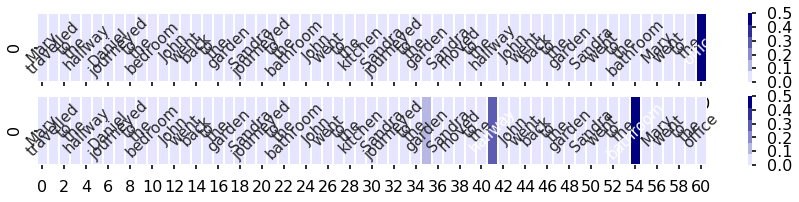

------------------------------
[2, 7, 22, 21, 20, 11, 4, 8, 16, 21, 20, 14, 4, 7, 23, 21, 20, 17, 4, 5, 18, 21, 20, 19, 4, 5, 16, 21, 20, 12, 4, 7, 22, 21, 20, 12, 4, 8, 18, 21, 20, 19, 4, 8, 23, 10, 21, 20, 11, 4, 6, 23, 10, 21, 20, 11, 4, 6, 18, 21, 20, 19, 3]
Where is Mary
bedroom


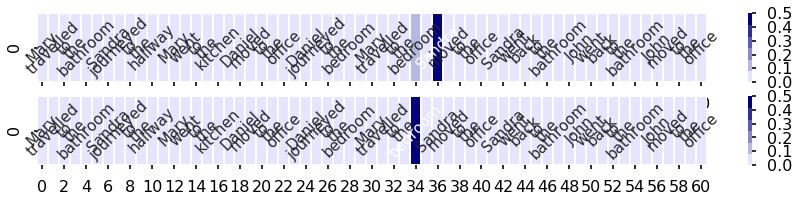

------------------------------
[2, 7, 23, 21, 20, 12, 4, 6, 18, 21, 20, 11, 4, 8, 23, 10, 21, 20, 19, 4, 6, 22, 21, 20, 13, 4, 8, 16, 21, 20, 17, 4, 6, 16, 21, 20, 14, 4, 7, 23, 10, 21, 20, 13, 4, 5, 23, 21, 20, 14, 4, 8, 23, 21, 20, 13, 4, 6, 23, 21, 20, 13, 3]
Where is Mary
garden


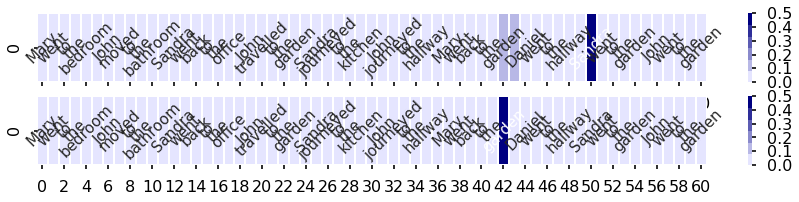

------------------------------
[2, 6, 16, 21, 20, 13, 4, 6, 22, 21, 20, 11, 4, 7, 18, 21, 20, 17, 4, 7, 23, 10, 21, 20, 12, 4, 6, 23, 21, 20, 14, 4, 6, 23, 21, 20, 17, 4, 7, 22, 21, 20, 17, 4, 8, 23, 10, 21, 20, 11, 4, 6, 22, 21, 20, 13, 4, 7, 18, 21, 20, 11, 3]
Where is John
garden


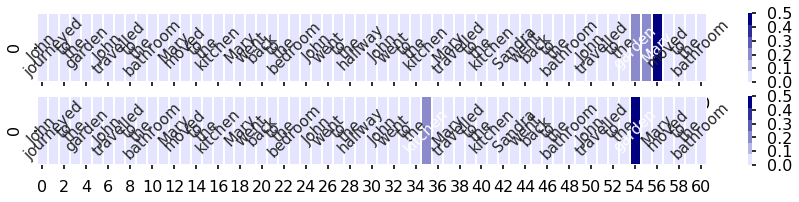

------------------------------
[2, 6, 16, 21, 20, 12, 4, 8, 16, 21, 20, 13, 4, 5, 23, 10, 21, 20, 14, 4, 7, 23, 21, 20, 14, 4, 5, 22, 21, 20, 17, 4, 5, 23, 21, 20, 19, 4, 5, 22, 21, 20, 12, 4, 8, 23, 21, 20, 19, 4, 7, 23, 10, 21, 20, 11, 4, 7, 16, 21, 20, 19, 3]
Where is Sandra
office


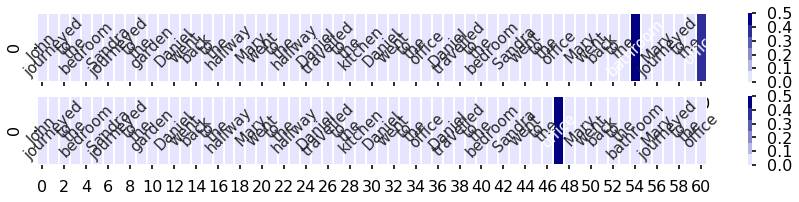

------------------------------
[2, 5, 23, 21, 20, 11, 4, 6, 23, 21, 20, 13, 4, 6, 23, 10, 21, 20, 12, 4, 7, 16, 21, 20, 19, 4, 5, 18, 21, 20, 17, 4, 6, 16, 21, 20, 19, 4, 7, 16, 21, 20, 17, 4, 8, 22, 21, 20, 11, 4, 8, 23, 21, 20, 14, 4, 5, 23, 10, 21, 20, 12, 3]
Where is Mary
kitchen


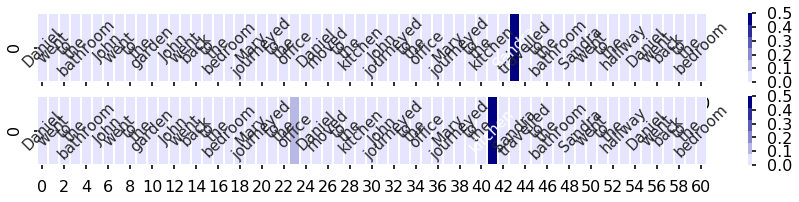

------------------------------
[2, 5, 22, 21, 20, 19, 4, 8, 23, 10, 21, 20, 19, 4, 7, 23, 21, 20, 19, 4, 5, 18, 21, 20, 11, 4, 6, 23, 21, 20, 14, 4, 8, 18, 21, 20, 12, 4, 8, 22, 21, 20, 19, 4, 6, 23, 10, 21, 20, 13, 4, 6, 23, 21, 20, 14, 4, 7, 23, 21, 20, 11, 3]
Where is Sandra
office


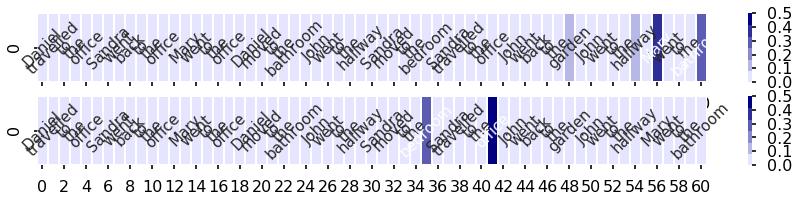

------------------------------
[2, 8, 23, 21, 20, 19, 4, 6, 23, 10, 21, 20, 11, 4, 5, 22, 21, 20, 19, 4, 6, 23, 10, 21, 20, 12, 4, 8, 18, 21, 20, 17, 4, 8, 23, 21, 20, 13, 4, 5, 23, 10, 21, 20, 12, 4, 8, 16, 21, 20, 19, 4, 8, 18, 21, 20, 17, 4, 6, 18, 21, 20, 17, 3]
Where is Sandra
kitchen


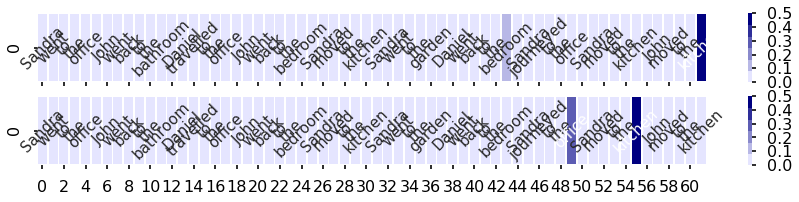

------------------------------
[2, 7, 22, 21, 20, 13, 4, 6, 23, 10, 21, 20, 17, 4, 8, 16, 21, 20, 19, 4, 8, 16, 21, 20, 14, 4, 6, 22, 21, 20, 11, 4, 8, 18, 21, 20, 19, 4, 8, 18, 21, 20, 17, 4, 5, 23, 10, 21, 20, 11, 4, 5, 16, 21, 20, 13, 4, 6, 23, 10, 21, 20, 12, 3]
Where is Sandra
kitchen


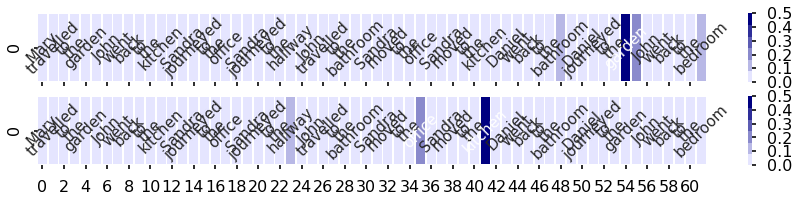

------------------------------
[2, 8, 16, 21, 20, 17, 4, 6, 18, 21, 20, 14, 4, 5, 23, 10, 21, 20, 14, 4, 7, 23, 21, 20, 11, 4, 6, 22, 21, 20, 13, 4, 7, 18, 21, 20, 14, 4, 7, 23, 10, 21, 20, 12, 4, 5, 23, 21, 20, 19, 4, 5, 23, 10, 21, 20, 13, 4, 8, 18, 21, 20, 11, 3]
Where is Mary
bedroom


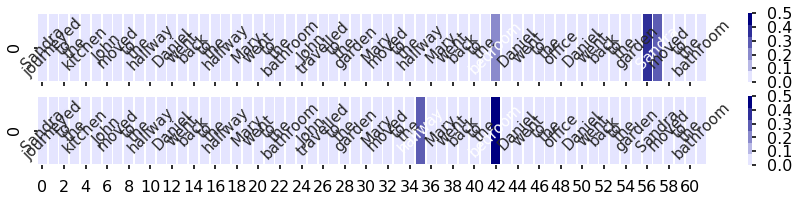

------------------------------
[2, 8, 18, 21, 20, 12, 4, 5, 16, 21, 20, 13, 4, 7, 18, 21, 20, 12, 4, 8, 23, 10, 21, 20, 14, 4, 6, 23, 21, 20, 19, 4, 8, 23, 10, 21, 20, 11, 4, 8, 23, 10, 21, 20, 17, 4, 8, 22, 21, 20, 19, 4, 6, 18, 21, 20, 13, 4, 5, 23, 21, 20, 12, 3]
Where is Sandra
office


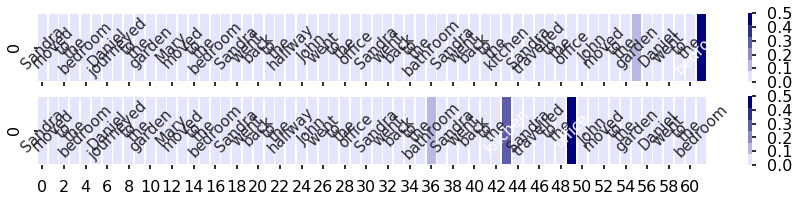

------------------------------
[2, 6, 23, 10, 21, 20, 12, 4, 5, 16, 21, 20, 14, 4, 7, 23, 10, 21, 20, 14, 4, 5, 23, 21, 20, 19, 4, 6, 16, 21, 20, 14, 4, 8, 23, 21, 20, 17, 4, 8, 23, 10, 21, 20, 14, 4, 6, 18, 21, 20, 11, 4, 7, 23, 21, 20, 19, 4, 6, 22, 21, 20, 13, 3]
Where is Sandra
hallway


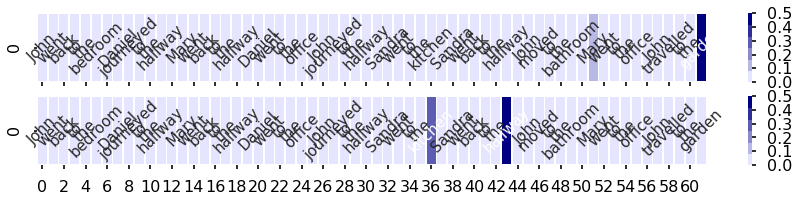

------------------------------
[2, 5, 23, 10, 21, 20, 19, 4, 8, 18, 21, 20, 11, 4, 8, 22, 21, 20, 17, 4, 7, 23, 21, 20, 17, 4, 5, 22, 21, 20, 11, 4, 5, 23, 10, 21, 20, 14, 4, 5, 22, 21, 20, 12, 4, 8, 23, 10, 21, 20, 19, 4, 6, 18, 21, 20, 14, 4, 5, 22, 21, 20, 14, 3]
Where is Sandra
office


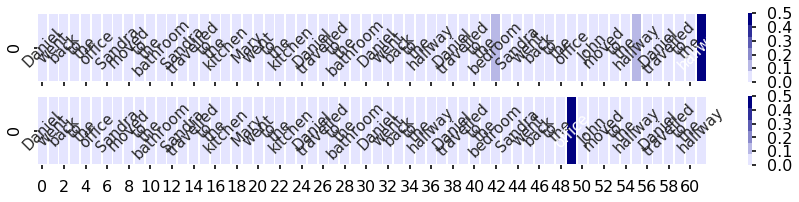

------------------------------
[2, 7, 23, 10, 21, 20, 17, 4, 6, 23, 21, 20, 12, 4, 5, 23, 10, 21, 20, 14, 4, 7, 18, 21, 20, 19, 4, 8, 16, 21, 20, 17, 4, 8, 23, 10, 21, 20, 11, 4, 6, 22, 21, 20, 13, 4, 6, 18, 21, 20, 14, 4, 7, 22, 21, 20, 17, 4, 5, 22, 21, 20, 17, 3]
Where is John
hallway


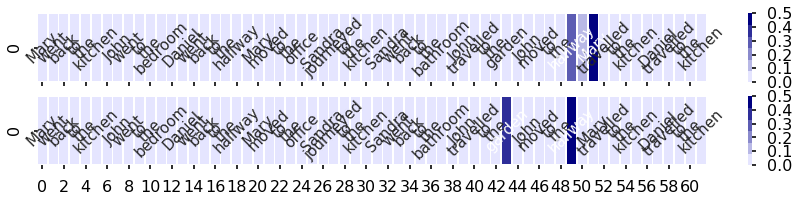

------------------------------
[2, 6, 16, 21, 20, 13, 4, 6, 22, 21, 20, 11, 4, 5, 23, 10, 21, 20, 13, 4, 5, 16, 21, 20, 17, 4, 8, 22, 21, 20, 17, 4, 8, 18, 21, 20, 14, 4, 8, 22, 21, 20, 12, 4, 6, 23, 10, 21, 20, 19, 4, 7, 23, 10, 21, 20, 17, 4, 7, 18, 21, 20, 14, 3]
Where is Sandra
bedroom


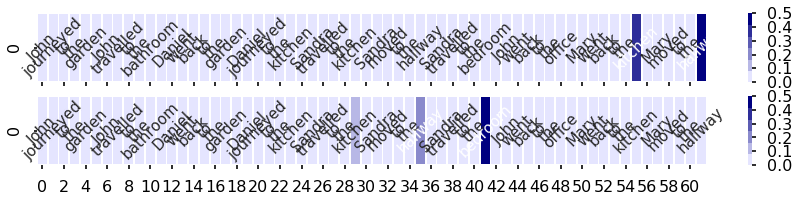

------------------------------
[2, 5, 22, 21, 20, 11, 4, 6, 22, 21, 20, 14, 4, 5, 23, 10, 21, 20, 13, 4, 8, 23, 21, 20, 14, 4, 6, 23, 10, 21, 20, 11, 4, 8, 18, 21, 20, 12, 4, 7, 23, 21, 20, 14, 4, 7, 22, 21, 20, 12, 4, 6, 16, 21, 20, 17, 4, 5, 23, 10, 21, 20, 11, 3]
Where is Sandra
bedroom


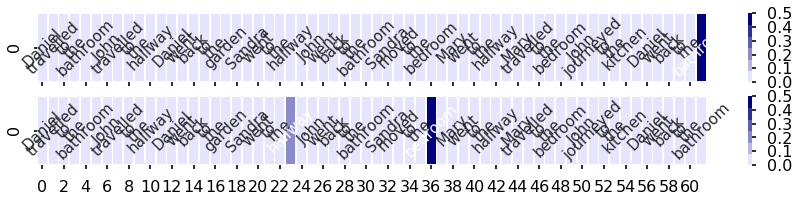

------------------------------
[2, 6, 18, 21, 20, 11, 4, 8, 18, 21, 20, 13, 4, 6, 23, 10, 21, 20, 19, 4, 6, 22, 21, 20, 12, 4, 5, 18, 21, 20, 14, 4, 8, 18, 21, 20, 11, 4, 7, 23, 10, 21, 20, 12, 4, 5, 23, 10, 21, 20, 11, 4, 7, 23, 21, 20, 17, 4, 7, 23, 21, 20, 12, 3]
Where is Sandra
bathroom


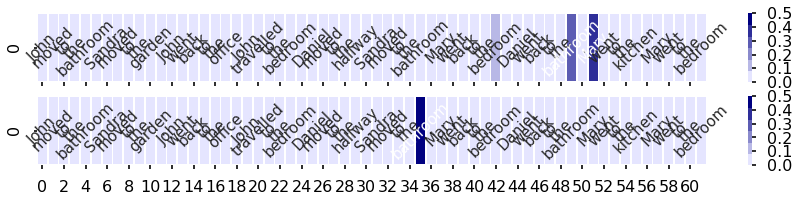

------------------------------
[2, 5, 16, 21, 20, 13, 4, 6, 18, 21, 20, 13, 4, 8, 18, 21, 20, 12, 4, 6, 23, 10, 21, 20, 19, 4, 6, 23, 10, 21, 20, 12, 4, 5, 23, 10, 21, 20, 12, 4, 6, 23, 21, 20, 19, 4, 8, 23, 21, 20, 13, 4, 7, 23, 10, 21, 20, 11, 4, 5, 23, 21, 20, 13, 3]
Where is Sandra
garden


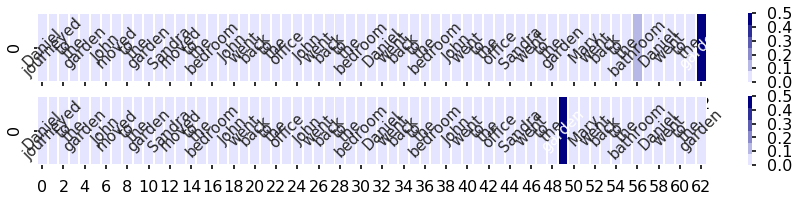

------------------------------
Cropping saved pngs
Done cropping
254


In [39]:
count = print_attention(output1,output2, output3, max=-1, plot=True, jsd_thresh=0.28)
print(count) #assert count==max